In [1]:
#import
import os
import sys

import tqdm
import math
import wandb
import torch
import pylab
import logging

import numpy as np
import pandas as pd
import torch.nn as nn
import lightning.pytorch as pl
import matplotlib.pyplot as plt

from random import randint
from scipy.stats import chisquare, kstest
from scipy.optimize import curve_fit
from torchmetrics import MeanAbsoluteError
from sklearn.preprocessing import StandardScaler
from torch.utils.data import Dataset, DataLoader
from lightning.pytorch.loggers import WandbLogger
from sklearn.model_selection import train_test_split
from torch.optim.lr_scheduler import ReduceLROnPlateau
from lightning.pytorch.callbacks.early_stopping import EarlyStopping
from lightning.pytorch.callbacks import Callback, LearningRateMonitor, ModelCheckpoint

/var/folders/xz/1q44kbwx25g7j6b7qsjs_x4r0000gp/T/ipykernel_89942/2713701154.py:13: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


# Reading model and data

In [8]:
class RMSELoss(torch.nn.Module):
    def __init__(self):
        super(RMSELoss,self).__init__()

    def forward(self,x,y,w):
        criterion = nn.MSELoss()
        loss = torch.sqrt(criterion(x, y))*w
        return loss.mean()

#params
project_name = "MSU_interpol"

logger_path = './wandb_local_logs'
data_path = '../data/clasdb_pi_plus_n.txt'

hyperparams_dict = {
    'scale_data': False,
    'test_size': 0.1,
    'batch_size': 32,
    'net_architecture': [5,60,80,100,120,140,240,340,440,640,2000,1040,640,340,240,140,100,80,60,20,1],
    'activation_function': nn.ReLU(),
    'loss_func': RMSELoss(),
    'optim_func': torch.optim.Adam,
    'max_epochs': 2000,
    'es_min_delta': 0.00001,
    'es_patience': 20,
    'lr': 0.001,
    'lr_factor':0.5,
    'lr_patience': 5,
    'lr_cooldown': 20,
}

logger_full_path = os.path.join(logger_path, project_name, 'spring-feather-42')

os.makedirs(logger_full_path, exist_ok=True)
logging.basicConfig(encoding='utf-8',
                    level=logging.DEBUG,
                    format='%(asctime)s : %(levelname)s : %(message)s',
                    handlers=[logging.FileHandler(os.path.join(logger_full_path, 'logs.log'), mode='w'),
                              logging.StreamHandler(sys.stdout)],
                    force=True)

class InterpolDataSet(Dataset):
    def __init__(self, features, labels, weights):
        self.features = features
        self.labels = labels
        self.weights = weights
        self.len = len(labels)

    def __getitem__(self, index):
        feature = self.features[index]
        label = self.labels[index]
        weights = self.weights[index]
        return feature, label, weights

    def __len__(self):
        return self.len

class InterpolDataModule(pl.LightningDataModule):
    def __init__(self, hyperparams):
        super().__init__()
        self.df = None
        self.hyperparams = hyperparams
        self.train_dataset = None
        self.val_dataset = None

    def augment(self, new_augm):
        augm = pd.Series({'Ebeam': np.random.normal(loc=new_augm.Ebeam, scale=new_augm.Ebeam/30),
                           'W': np.random.normal(loc=new_augm.W, scale=new_augm.W/30),
                           'Q2': np.random.normal(loc=new_augm.Q2, scale=new_augm.Q2/30),
                           'cos_theta': np.clip(np.random.normal(loc=new_augm.cos_theta, scale=abs(new_augm.cos_theta/30)), -1, 1),
                           'phi': np.clip(np.random.normal(loc=new_augm.phi, scale=new_augm.phi/30), 0, 2*np.pi),
                           'dsigma_dOmega': np.random.normal(loc=new_augm.dsigma_dOmega, scale=new_augm.error/3),
                           'error': new_augm.error,
                           'weight': new_augm.weight,
                          })
        return augm

    def setup(self, stage):
        # data reading and preprocessing
        df = pd.read_csv(data_path, delimiter='\t', header=None)
        df.columns = ['Ebeam', 'W', 'Q2', 'cos_theta', 'phi', 'dsigma_dOmega', 'error', 'id']
        df.loc[8314:65671, 'Ebeam'] = 5.754 # peculiarity of this dataset.
        df['phi'] = df.phi.apply(lambda x: math.radians(x))
        df['weight'] = df['error'].apply(lambda x: x and 1 / x or 100) # x and 1 / x or 100  is just a reversed error but with validation 1/0 error in this case it will return 100
        df = df.drop('id', axis=1)
        df = df.iloc[df[['Ebeam', 'W', 'Q2', 'cos_theta', 'phi']].drop_duplicates().index]

        #train test split
        feature_columns = ['Ebeam', 'W', 'Q2', 'cos_theta', 'phi']
        feature_columns_with_weights = ['Ebeam', 'W', 'Q2', 'cos_theta', 'phi', 'weight']

        feature_data = df[feature_columns_with_weights]
        label_data = df['dsigma_dOmega']

        if self.hyperparams.get('scale_data'):
            scaler_feature = StandardScaler()
            scaler_target = StandardScaler()
            feature_data = scaler_feature.fit_transform(feature_data)
            label_data = scaler_target.fit_transform(label_data.values.reshape(-1,1))
        else:
            pass

        if self.hyperparams.get('augment'):
            aug_series_list = []
            for i in tqdm.tqdm(df.itertuples()):
                for _ in range(self.hyperparams.get('augment_factor')):
                    aug_series_list.append(self.augment(i))

            aug_df = pd.DataFrame(aug_series_list)
            df = pd.concat([df, aug_df])
        else:
            pass

        self.df = df

        train_feature_data, val_feature_data, train_label_data, val_label_data = train_test_split(feature_data,
                                                                                                  label_data,
                                                                                                  test_size=self.hyperparams.get('test_size'),
                                                                                                  random_state=1438)


        self.train_dataset = InterpolDataSet(torch.tensor(train_feature_data[feature_columns].values, dtype=torch.float32),
                                             torch.tensor(train_label_data.values, dtype=torch.float32),
                                             torch.tensor(train_feature_data['weight'].values, dtype=torch.float32))

        self.val_dataset = InterpolDataSet(torch.tensor(val_feature_data[feature_columns].values, dtype=torch.float32),
                                           torch.tensor(val_label_data.values, dtype=torch.float32),
                                           torch.tensor(val_feature_data['weight'].values, dtype=torch.float32))
    def train_dataloader(self):
        return DataLoader(dataset = self.train_dataset, batch_size = self.hyperparams.get('batch_size'), shuffle = False, num_workers=0)

    def val_dataloader(self):
        return DataLoader(dataset = self.val_dataset, batch_size = self.hyperparams.get('batch_size'), shuffle = False, num_workers=0)

class PrintCallbacks(Callback):
    def on_train_start(self, trainer, pl_module):
        logging.info("Training is starting")

    def on_train_end(self, trainer, pl_module):
        logging.info("Training is ending")

    def on_train_epoch_end(self, trainer, pl_module):
        epoch_mean = torch.stack(pl_module.training_step_outputs).mean()
        logging.info(f"epoch: {pl_module.current_epoch}; train_loss: {epoch_mean}")
        pl_module.training_step_outputs.clear()

    def on_validation_epoch_end(self, trainer, pl_module):
        epoch_mean = torch.stack(pl_module.validation_step_outputs).mean()
        logging.info(f"epoch: {pl_module.current_epoch}; val_loss: {epoch_mean}")
        pl_module.validation_step_outputs.clear()

class InterpolRegressor(pl.LightningModule):
    def __init__(self, hyperparams):
        super(InterpolRegressor, self).__init__()

        self.train_loss, self.train_mae, self.val_loss, self.val_mae = 0,0,0,0
        self.hyperparams = hyperparams
        self.save_hyperparameters(self.hyperparams)

        self.mae = MeanAbsoluteError()
        self.loss_func = self.hyperparams.get('loss_func')

        self.optim = self.hyperparams.get('optim_func')

        self.net_architecture = self.hyperparams.get('net_architecture')
        self.activation_function = self.hyperparams.get('activation_function')

        self.training_step_outputs = []
        self.validation_step_outputs = []

        self.net = nn.Sequential()
        for i in range(1,len(self.net_architecture)):
            self.net.append(nn.Linear(self.net_architecture[i-1], self.net_architecture[i]))
            if i!=len(self.net_architecture)-1:
                self.net.append(self.activation_function)
            else:
                pass

    def forward(self, x):
        return self.net(x)

    def training_step(self, batch, batch_idx):
        x, y, w = batch
        y_hat = self.forward(x)

        loss = self.loss_func
        self.train_loss = loss.forward(y_hat.reshape(-1), y, w)
        self.train_mae = self.mae(y_hat.reshape(-1), y)

        self.log('train_loss', self.train_loss, batch_size=self.hyperparams['batch_size'],
                 on_step=False, on_epoch=True, prog_bar=True, sync_dist=True, logger=True)
        self.log('train_mae', self.train_mae, batch_size=self.hyperparams['batch_size'],
                 on_step=False, on_epoch=True, prog_bar=True, sync_dist=True, logger=True)

        self.training_step_outputs.append(self.train_loss)
        return self.train_loss

    def validation_step(self, batch, batch_idx):
        x, y, w = batch
        y_hat = self.forward(x)

        loss = self.loss_func
        self.val_loss = loss.forward(y_hat.reshape(-1), y, w)
        self.val_mae = self.mae(y_hat.reshape(-1), y)

        self.log('val_loss', self.val_loss, batch_size=self.hyperparams['batch_size'],
                 on_step=False, on_epoch=True, prog_bar=True, sync_dist=True, logger=True)
        self.log('val_mae', self.val_mae, batch_size=self.hyperparams['batch_size'],
                 on_step=False, on_epoch=True, prog_bar=True, sync_dist=True, logger=True)

        self.validation_step_outputs.append(self.val_loss)
        return self.val_loss

    def on_validation_epoch_end(self):
        sch = self.lr_schedulers()
        if isinstance(sch, torch.optim.lr_scheduler.ReduceLROnPlateau) and self.trainer.current_epoch!=0:
                sch.step(self.trainer.callback_metrics["val_loss"])

    def configure_callbacks(self):
        early_stop_callback = EarlyStopping(monitor="val_loss", mode="min",
                                            min_delta=self.hyperparams.get('es_min_delta'),
                                            patience=self.hyperparams.get('es_patience'),
                                            verbose=True)

        checkpoint_callback = ModelCheckpoint(save_top_k=3,
                                              monitor="val_loss",
                                              mode="min",
                                              dirpath=f"{logger_full_path}/checkpoints",
                                              filename="{exp_name}{val_loss:.5f}-{epoch:02d}")

        lr_monitor = LearningRateMonitor(logging_interval='epoch')

        print_callback = PrintCallbacks()

        return [early_stop_callback, checkpoint_callback, print_callback, lr_monitor]

    def configure_optimizers(self):
        optimizer = self.optim(self.parameters(), lr=self.hyperparams.get('lr'))
        lr_optim = ReduceLROnPlateau(optimizer = optimizer,
                                     mode = 'min',
                                     factor = self.hyperparams.get('lr_factor'),
                                     patience = self.hyperparams.get('lr_patience'),
                                     cooldown=self.hyperparams.get('lr_cooldown'),
                                     threshold=0.01,
                                     verbose= True)
        return {"optimizer": optimizer,
                "lr_scheduler": {
                    "scheduler": lr_optim,
                    "interval": "epoch",
                    "monitor": "val_loss",
                    "frequency": 2,
                    "name": 'lr_scheduler_monitoring'}
                }

data = InterpolDataModule(hyperparams_dict)
data.setup('test')
df = data.df
df_all = df[['Ebeam', 'W', 'Q2', 'cos_theta', 'phi']]
df_target = df[['dsigma_dOmega']]

model_5754 = InterpolRegressor.load_from_checkpoint(f'./wandb_local_logs/MSU_interpol_by_energy/5.754_dandy-grass-6_newloss/checkpoints/exp_name=0val_loss=0.28206-epoch=160.ckpt', hyperparams=hyperparams_dict)
model_5754.eval()

model_5499 = InterpolRegressor.load_from_checkpoint(f'./wandb_local_logs/MSU_interpol_by_energy/5.499_sweet-bee-3/checkpoints/exp_name=0val_loss=2.47699-epoch=110.ckpt', hyperparams=hyperparams_dict)
model_5499.eval()

model_1515 = InterpolRegressor.load_from_checkpoint(f'./wandb_local_logs/MSU_interpol_by_energy/1.515_eager-violet-5/checkpoints/exp_name=0val_loss=2.57880-epoch=45.ckpt', hyperparams=hyperparams_dict)
model_1515.eval()

2024-04-10 14:01:46,803 : DEBUG : open file: /Users/andrey.golda/Documents/Study/MSU_interpol/training/wandb_local_logs/MSU_interpol_by_energy/5.754_phi_robust-shadow-10/checkpoints/exp_name=0val_loss=0.30253-epoch=89.ckpt
2024-04-10 14:01:46,978 : DEBUG : open file: /Users/andrey.golda/Documents/Study/MSU_interpol/training/wandb_local_logs/MSU_interpol_by_energy/5.499_sweet-bee-3/checkpoints/exp_name=0val_loss=2.47699-epoch=110.ckpt


/Users/andrey.golda/Library/Caches/pypoetry/virtualenvs/msu-interpol--lw2ADYE-py3.11/lib/python3.11/site-packages/lightning/pytorch/utilities/parsing.py:198: Attribute 'activation_function' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['activation_function'])`.
/Users/andrey.golda/Library/Caches/pypoetry/virtualenvs/msu-interpol--lw2ADYE-py3.11/lib/python3.11/site-packages/lightning/pytorch/utilities/parsing.py:198: Attribute 'loss_func' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss_func'])`.


2024-04-10 14:01:47,150 : DEBUG : open file: /Users/andrey.golda/Documents/Study/MSU_interpol/training/wandb_local_logs/MSU_interpol_by_energy/1.515_eager-violet-5/checkpoints/exp_name=0val_loss=2.57880-epoch=45.ckpt


InterpolRegressor(
  (mae): MeanAbsoluteError()
  (loss_func): RMSELoss()
  (activation_function): ReLU()
  (net): Sequential(
    (0): Linear(in_features=5, out_features=60, bias=True)
    (1): ReLU()
    (2): Linear(in_features=60, out_features=80, bias=True)
    (3): ReLU()
    (4): Linear(in_features=80, out_features=100, bias=True)
    (5): ReLU()
    (6): Linear(in_features=100, out_features=120, bias=True)
    (7): ReLU()
    (8): Linear(in_features=120, out_features=140, bias=True)
    (9): ReLU()
    (10): Linear(in_features=140, out_features=240, bias=True)
    (11): ReLU()
    (12): Linear(in_features=240, out_features=340, bias=True)
    (13): ReLU()
    (14): Linear(in_features=340, out_features=440, bias=True)
    (15): ReLU()
    (16): Linear(in_features=440, out_features=640, bias=True)
    (17): ReLU()
    (18): Linear(in_features=640, out_features=2000, bias=True)
    (19): ReLU()
    (20): Linear(in_features=2000, out_features=1040, bias=True)
    (21): ReLU()
    (2

# Checks

### Crossections

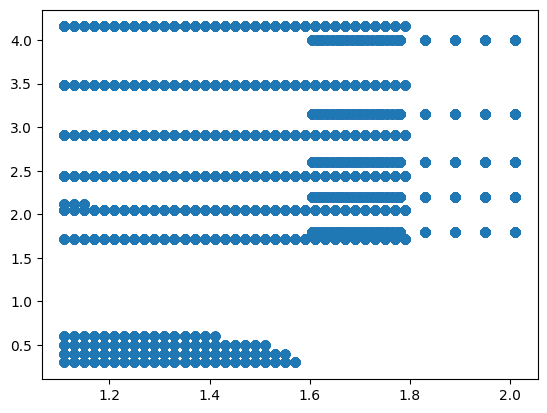

In [9]:
plt.scatter(df.W, df.Q2)

In [14]:
def cross_sections_check(df, E_beam, W, Q2, cos_theta):
    df_example_set = df[(df.Ebeam == E_beam)&
                        (df.W == W)&
                        (df.Q2 == Q2)&
                        (df.cos_theta.round(1) == cos_theta)].sort_values('phi')
    if len(df_example_set)==0:
        print(len(df_example_set), E_beam, W, Q2, cos_theta)
        return None

    df_example_set_for_prediction = pd.DataFrame({'Ebeam' : [E_beam for _ in np.arange(0, 2*np.pi, 0.01)],
                                                  'W' : [W for _ in np.arange(0, 2*np.pi, 0.01)],
                                                  'Q2' : [Q2 for _ in np.arange(0, 2*np.pi, 0.01)],
                                                  'cos_theta' : [cos_theta for _ in np.arange(0, 2*np.pi, 0.01)],
                                                  'phi' : [phi for phi in np.arange(0, 2*np.pi, 0.01)]})

    if E_beam == 5.754:
        model = model_5754
    elif E_beam == 5.499:
        model = model_5499
    elif E_beam == 1.515:
        model = model_1515
    else:
        raise ValueError

#     return df_example_set
    with torch.no_grad():
        dsigma_dOmega_predicted = model.forward(torch.tensor(df_example_set_for_prediction.to_numpy(),dtype=torch.float32)).detach()
        df_example_set_for_prediction['dsigma_dOmega_predicted'] = dsigma_dOmega_predicted

    def func_cos(x, a, b, c): 
        return a + b*np.cos(2*x) + c*np.cos(x) 

    #input data 
    xdata = df_example_set.phi
    ydata = df_example_set.dsigma_dOmega
    ydata_error = df_example_set.error

    #fitting the data 
    popt, pcov = curve_fit(func_cos, xdata, ydata, sigma=ydata_error, absolute_sigma=True)

    a, b, c = popt[0], popt[1], popt[2]
    #print the fitted parameters 
    print("a = %s , b = %s, c = %s" % (a, b, c))
    phi_theory = [i for i in np.arange(0, 2*np.pi, 0.01)]
    dsigma_dOmega_theory = [func_cos(x, a, b, c) for x in phi_theory]

    df_theory = pd.DataFrame({'phi_theory': phi_theory,
                              'dsigma_dOmega_theory': dsigma_dOmega_theory})

    df_chi_2 = pd.merge_asof(df_example_set, df_theory, left_on='phi', right_on='phi_theory')
    df_chi_2 = pd.merge_asof(df_chi_2, df_example_set_for_prediction, on='phi')
    df_chi_2 = df_chi_2[['phi', 'dsigma_dOmega', 'dsigma_dOmega_theory', 'dsigma_dOmega_predicted']]

    real = df_chi_2['dsigma_dOmega'].apply(lambda x: np.round(x, 6)).values
    theory = df_chi_2['dsigma_dOmega_theory'].apply(lambda x: np.round(x, 6)).values
    preds = df_chi_2['dsigma_dOmega_predicted'].apply(lambda x: np.round(x, 6)).values

    stat_theory_chi, p_value_theory_chi = np.round(chisquare(real, np.sum(real)/np.sum(theory)*theory), 3)
    stat_preds_chi, p_value_preds_chi = np.round(chisquare(real, np.sum(real)/np.sum(preds)*preds), 3)

    stat_theory_ks, p_value_theory_ks = np.round(kstest(real, theory), 2)
    stat_preds_ks, p_value_preds_ks = np.round(kstest(real, preds), 2)

    plt.figure(figsize=(22, 6), dpi=80)
    plt.plot(phi_theory, 
             dsigma_dOmega_theory, 
             label=f'fitted, chi^2 = {stat_theory_chi}, p_value = {p_value_theory_chi}, ks = {stat_theory_ks}, p_value = {p_value_theory_ks}')
    plt.plot(df_example_set_for_prediction.phi, 
             dsigma_dOmega_predicted, 
             color='green',
             label=f'predicted; chi^2 = {stat_preds_chi}, p_value = {p_value_preds_chi}, ks = {stat_preds_ks}, p_value = {p_value_preds_ks}')
    plt.scatter(x=df_example_set.phi, 
                y=df_example_set.dsigma_dOmega,
                color='red', marker='*', label=f"real_data with params Ebeam: {E_beam}, W: {W}, Q2: {Q2}, cos_theta: {cos_theta}")
    plt.errorbar(x=df_example_set.phi,
                 y=df_example_set.dsigma_dOmega,
                 yerr=df_example_set.error,
                 color='red',
                 fmt='o')

    plt.xlabel("phi: rad", fontsize="20")
    plt.ylabel("dsigma_dOmega: barn", fontsize="20")
    
    plt.legend(loc ="upper right", fontsize="15")
    plt.savefig(f'./check_screenshots_by_energy_new_loss/E_beam={E_beam}/Q2={Q2}/W={W}/E_beam={E_beam}_Q2={Q2}_W={W}_cos_theta={cos_theta}.png')
    plt.show()
    return None

  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 1.715 -0.9
0 5.754 1.23 1.715 -0.8
0 5.754 1.23 1.715 -0.7
0 5.754 1.23 1.715 -0.6
a = 2.1366859005341095 , b = -0.6515229465038087, c = -0.6767943810451961


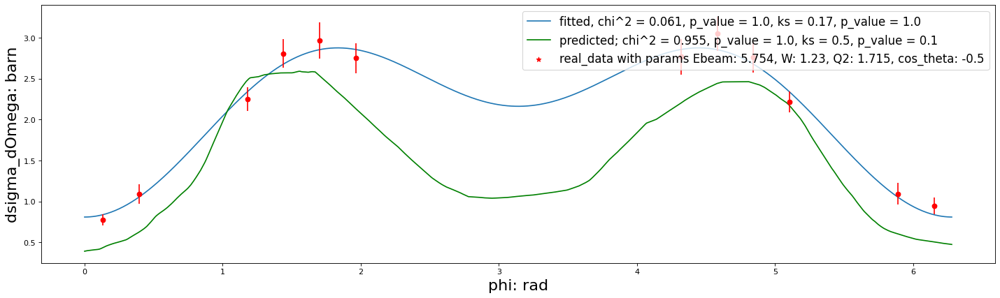

0 5.754 1.23 1.715 -0.4
a = 1.810098378115832 , b = -1.178121919602248, c = 0.3183917246651936


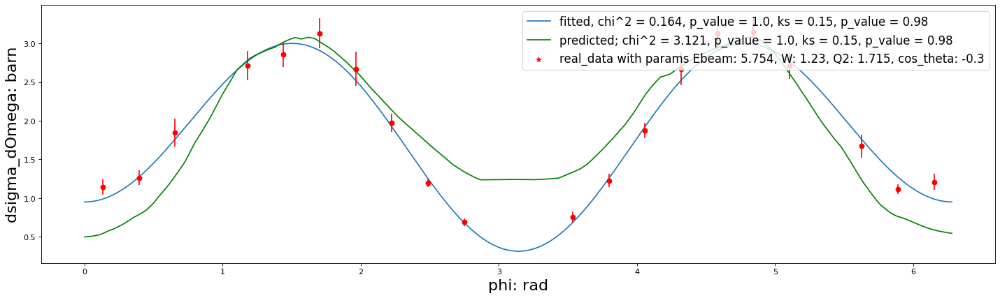

0 5.754 1.23 1.715 -0.2
a = 2.05620925374947 , b = -1.1281076101256344, c = 0.38588289379957597


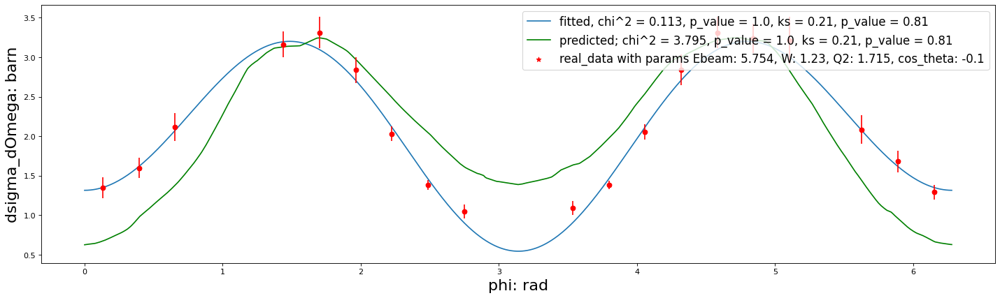

a = 2.073231014521072 , b = -1.0128563780277868, c = 0.40009432922344895


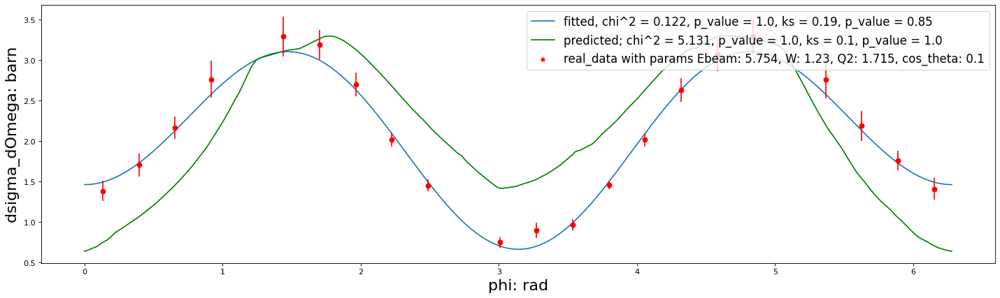

0 5.754 1.23 1.715 0.2
a = 2.1836822922173487 , b = -1.0593555569137472, c = 0.29529487243494407


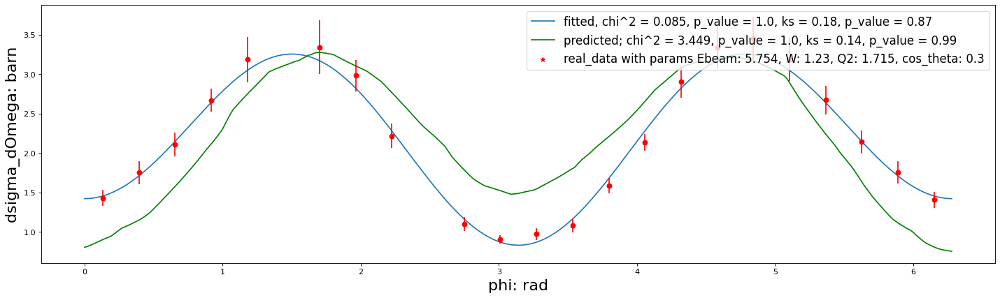

0 5.754 1.23 1.715 0.4
a = 2.1468947575026736 , b = -0.8824468121696372, c = 0.29773156305838794


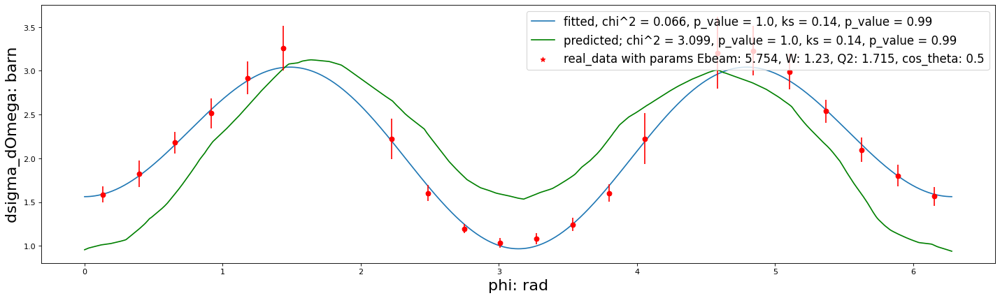

0 5.754 1.23 1.715 0.6
a = 2.014999500312523 , b = -0.598812254462378, c = 0.3354824198870219


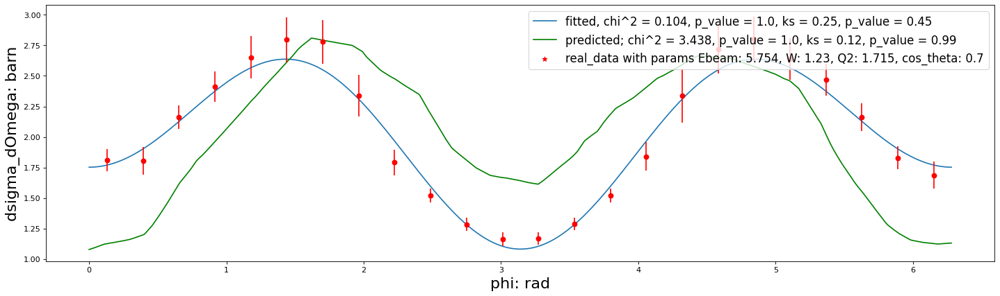

0 5.754 1.23 1.715 0.8
a = 2.0203841860056766 , b = -0.38392799429090513, c = 0.22608510702161286


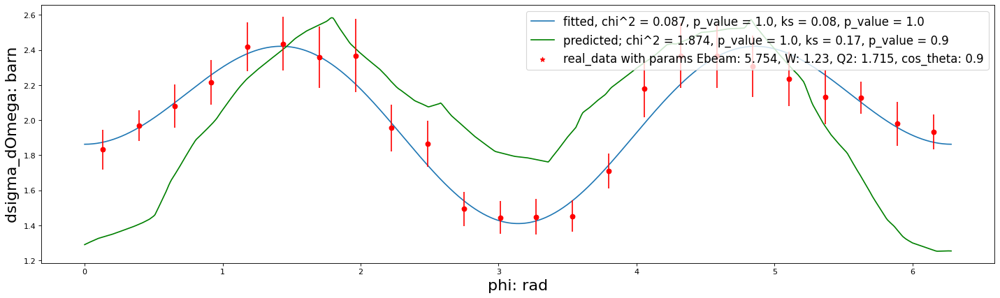


 25%|██▌       | 1/4 [00:04<00:12,  4.24s/it]

5.754 1.53 1.715 -0.9
0 5.754 1.53 1.715 -0.8
a = 1.4629575853625127 , b = -0.3455448030686062, c = -0.15111150262783604


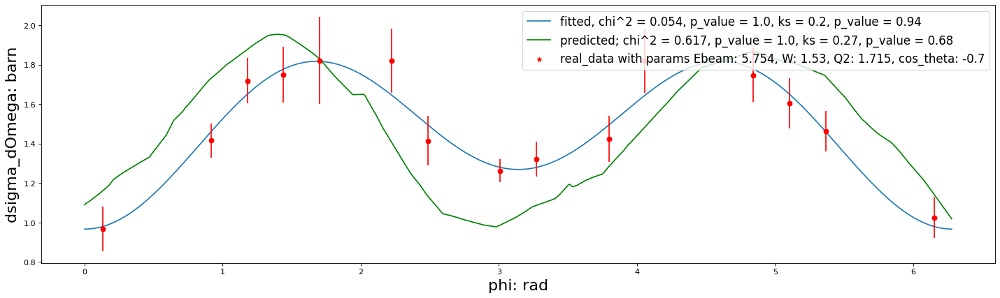

0 5.754 1.53 1.715 -0.6
a = 1.9159664758810433 , b = -0.363854630511921, c = -0.3219861103372936


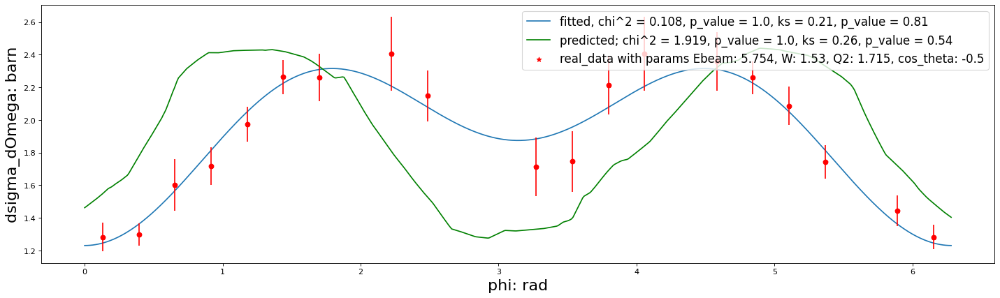

0 5.754 1.53 1.715 -0.4
a = 2.2404399888090274 , b = -0.4694269920794136, c = -0.28464431202340085


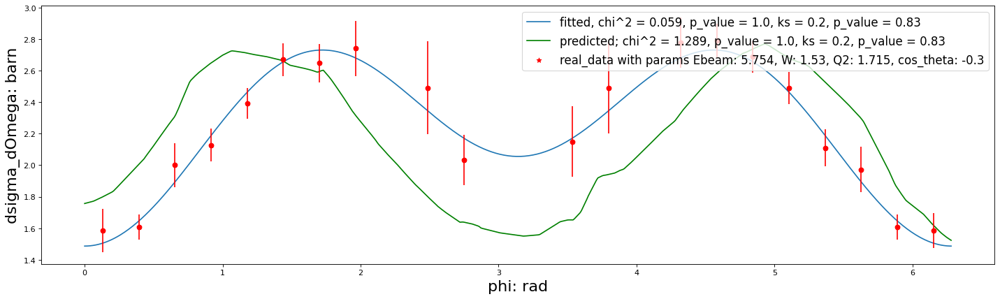

0 5.754 1.53 1.715 -0.2
a = 1.9655536117736312 , b = -0.5670386659590976, c = -0.010923257374144235


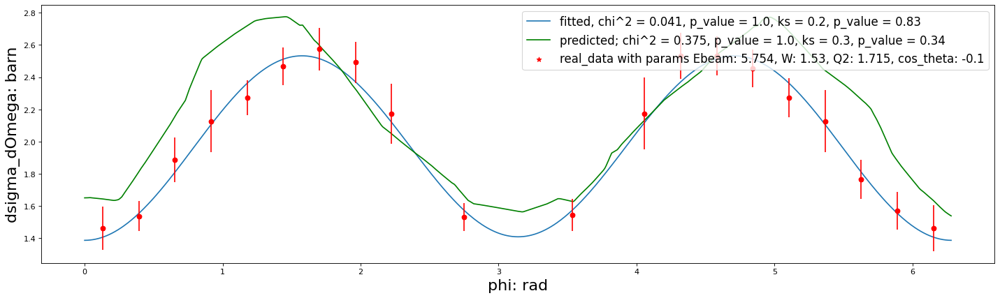

a = 2.0767682083685677 , b = -0.37815966457514505, c = -0.1831955382269511


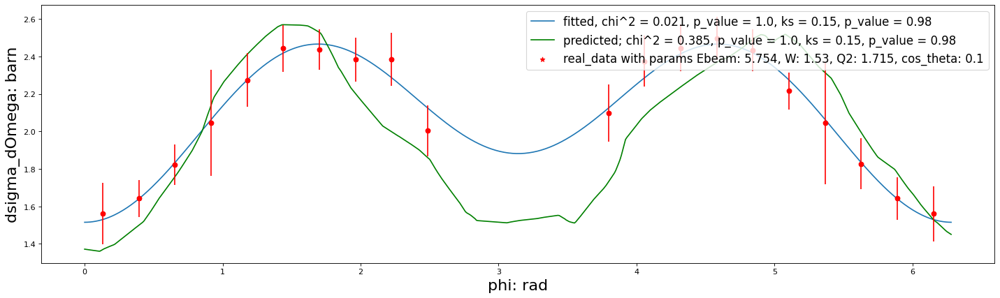

0 5.754 1.53 1.715 0.2
a = 1.7272961912187441 , b = -0.539131598153387, c = 0.21219879500810074


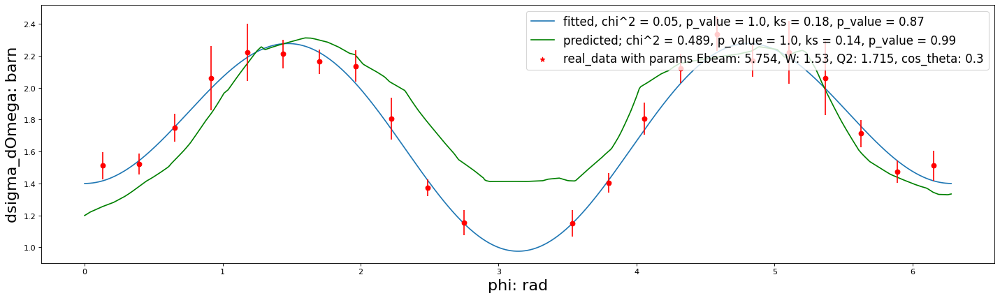

0 5.754 1.53 1.715 0.4
a = 1.7185332089687748 , b = -0.4612814882248366, c = 0.07355141583340039


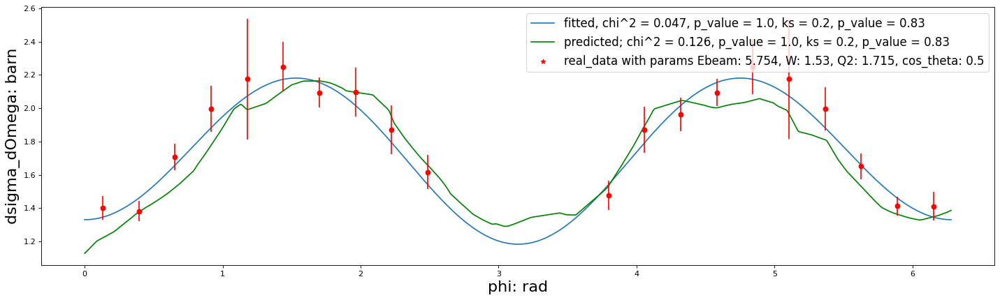

0 5.754 1.53 1.715 0.6
a = 1.610744321677838 , b = -0.31661596338606046, c = -0.04782446301792284


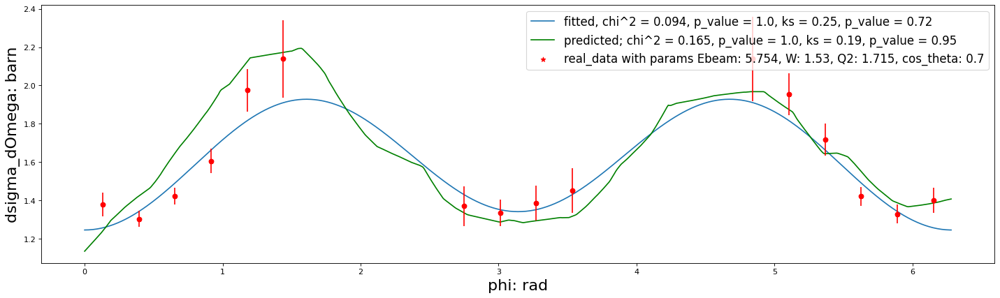

0 5.754 1.53 1.715 0.8
a = 1.5392520475659666 , b = -0.05597875348548306, c = -0.01968771546181038


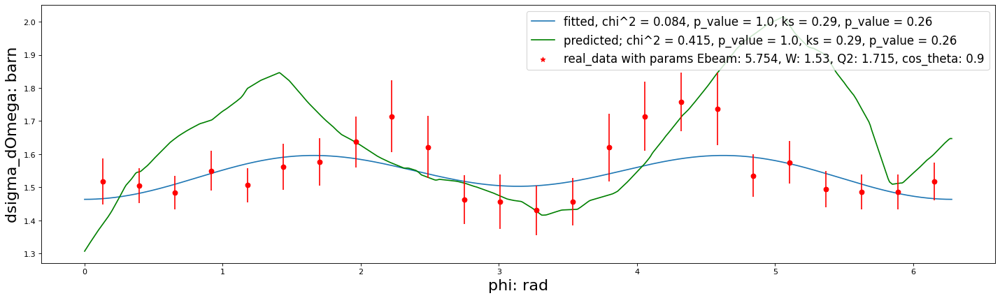


 50%|█████     | 2/4 [00:09<00:09,  4.76s/it]

a = 0.45069912910041837 , b = -0.04706459946538949, c = -0.11836566305793395


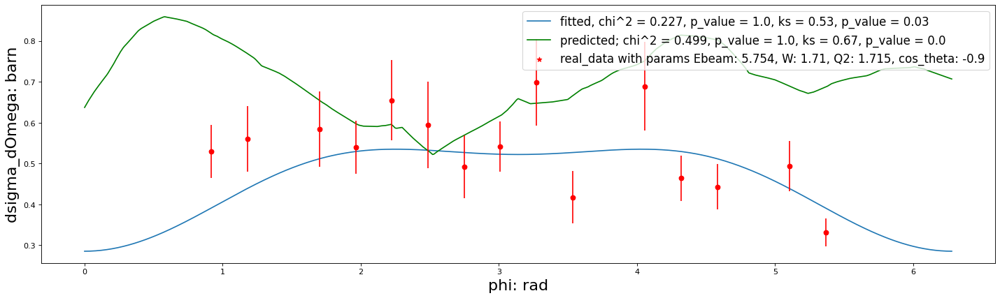

0 5.754 1.71 1.715 -0.8
a = 0.45305556011268294 , b = 0.0074720649289276965, c = -0.05076984944522251


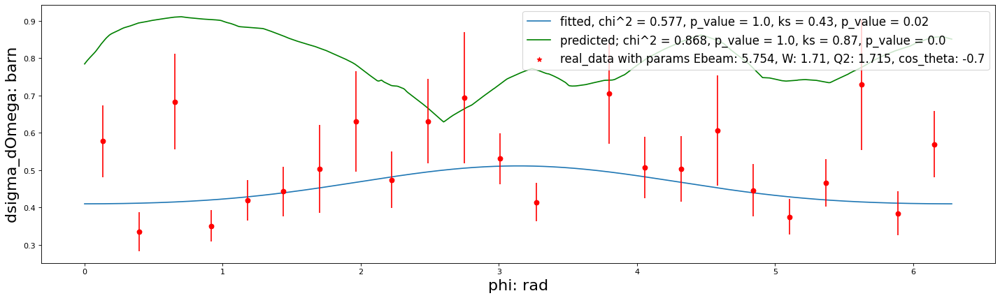

0 5.754 1.71 1.715 -0.6
a = 0.5331347901921785 , b = -0.026564095288825085, c = 0.004473598537281465


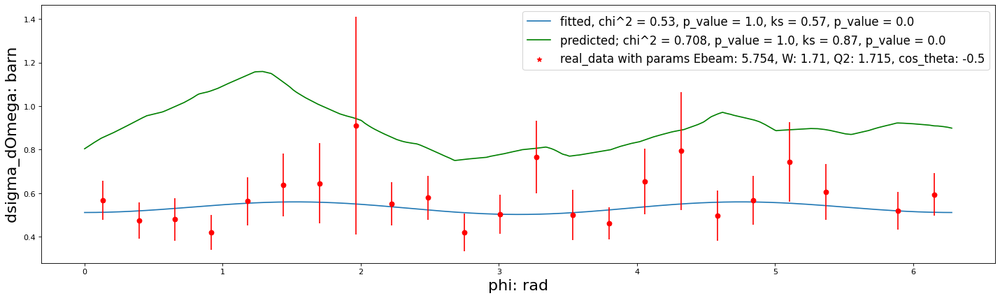

0 5.754 1.71 1.715 -0.4
a = 0.635083181773035 , b = -0.2285324057968977, c = -0.010203926507357656


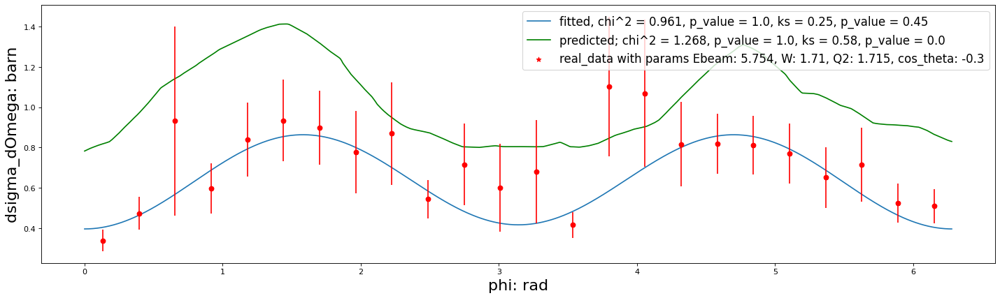

0 5.754 1.71 1.715 -0.2
a = 0.7171620145521531 , b = -0.1939787650141771, c = 0.0023595307137798116


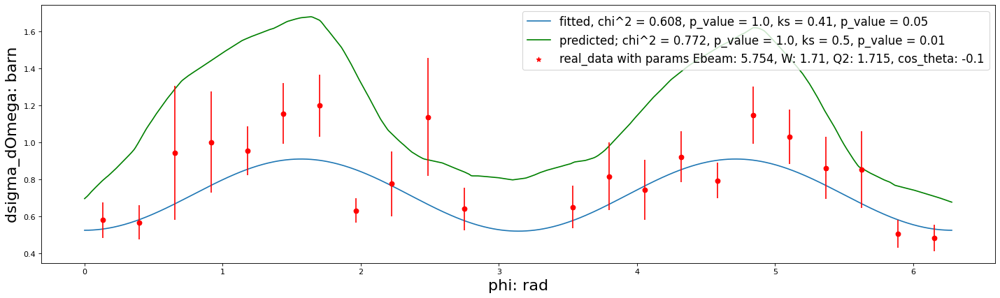

a = 0.7665280919998733 , b = -0.3750404340459983, c = 0.04502994568525498


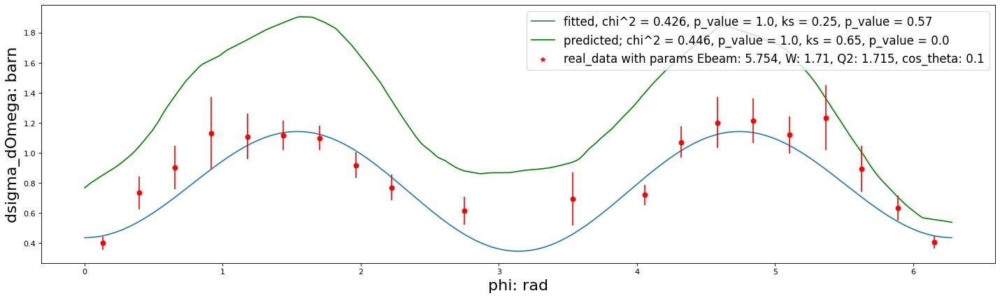

0 5.754 1.71 1.715 0.2
a = 0.805502537720588 , b = -0.4575010004379639, c = 0.06679088925971642


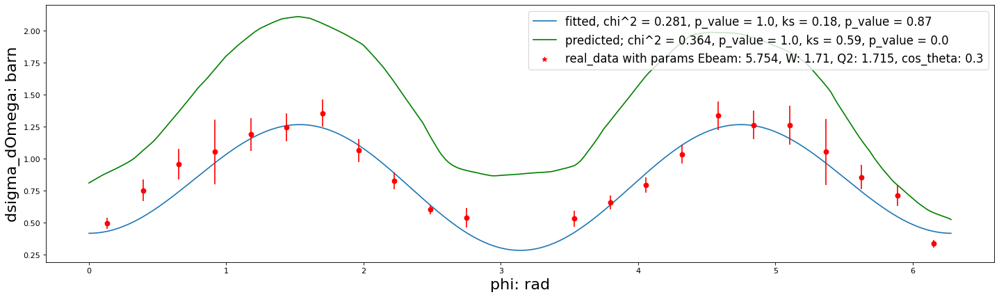

0 5.754 1.71 1.715 0.4
a = 0.8059898898537593 , b = -0.4919695234714186, c = 0.1803878928892367


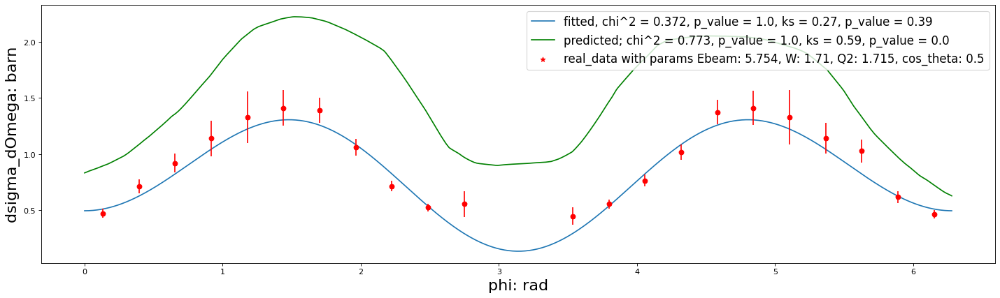

0 5.754 1.71 1.715 0.6
a = 0.9262034035587593 , b = -0.4037010835384626, c = 0.10589329451130365


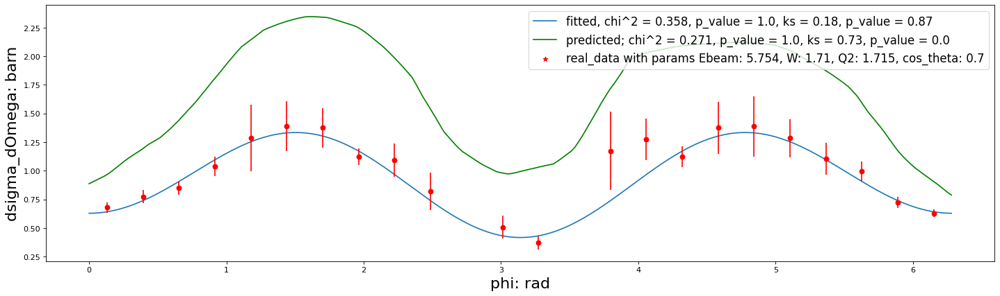

0 5.754 1.71 1.715 0.8
a = 1.1718014431526185 , b = -0.14616769687901954, c = 0.28092461103239863


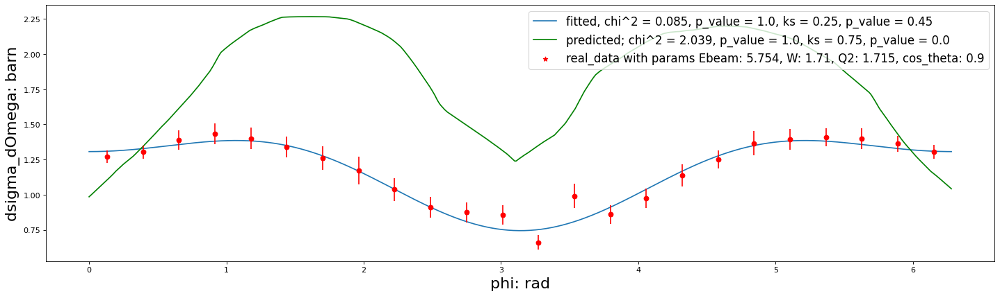


  9%|▉         | 1/11 [00:15<02:36, 15.60s/it]

0 5.754 1.95 1.715 -0.9
0 5.754 1.95 1.715 -0.8
0 5.754 1.95 1.715 -0.7
0 5.754 1.95 1.715 -0.6
0 5.754 1.95 1.715 -0.5
0 5.754 1.95 1.715 -0.4
0 5.754 1.95 1.715 -0.3
0 5.754 1.95 1.715 -0.2
0 5.754 1.95 1.715 -0.1
0 5.754 1.95 1.715 0.1
0 5.754 1.95 1.715 0.2
0 5.754 1.95 1.715 0.3
0 5.754 1.95 1.715 0.4
0 5.754 1.95 1.715 0.5
0 5.754 1.95 1.715 0.6
0 5.754 1.95 1.715 0.7
0 5.754 1.95 1.715 0.8
0 5.754 1.95 1.715 0.9



  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 1.72 -0.9
0 5.754 1.23 1.72 -0.8
0 5.754 1.23 1.72 -0.7
0 5.754 1.23 1.72 -0.6
0 5.754 1.23 1.72 -0.5
0 5.754 1.23 1.72 -0.4
a = 1.853406426226728 , b = -1.201565950350254, c = -0.3431448869981999


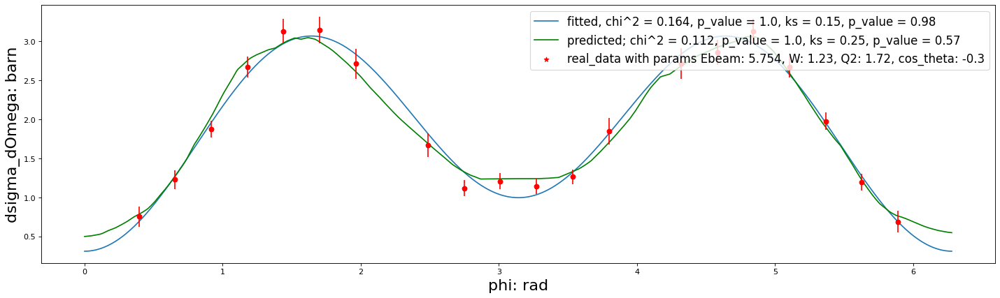

0 5.754 1.23 1.72 -0.2
a = 2.082058857016071 , b = -1.1919795226212302, c = -0.4113342252256771


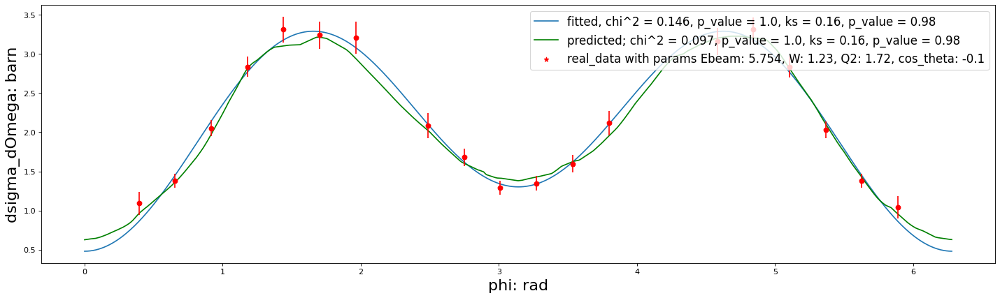

a = 2.094711743935602 , b = -1.079495760083949, c = -0.41960288873405677


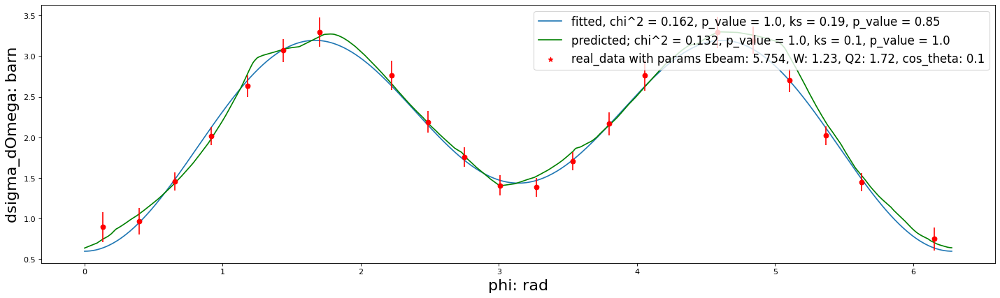

0 5.754 1.23 1.72 0.2
a = 2.218416626289154 , b = -1.1169059616086294, c = -0.30076105928201274


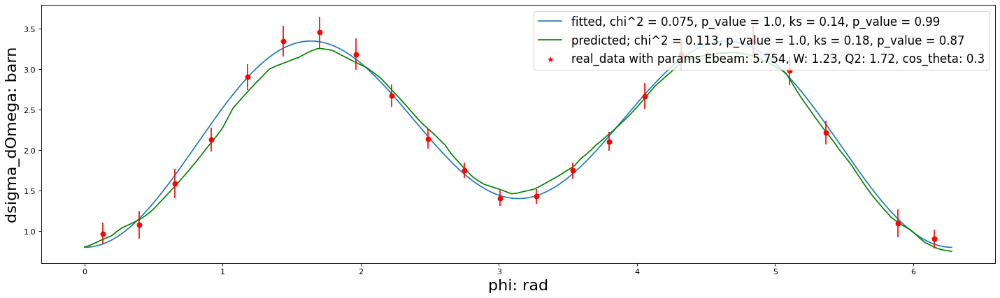

0 5.754 1.23 1.72 0.4
a = 2.183739105325976 , b = -0.9263932143121886, c = -0.28141922401447217


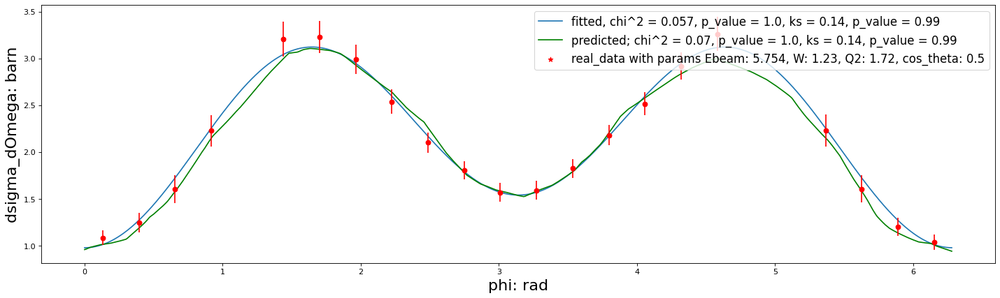

0 5.754 1.23 1.72 0.6
a = 2.0374081056025313 , b = -0.6496207554227635, c = -0.3305461596864166


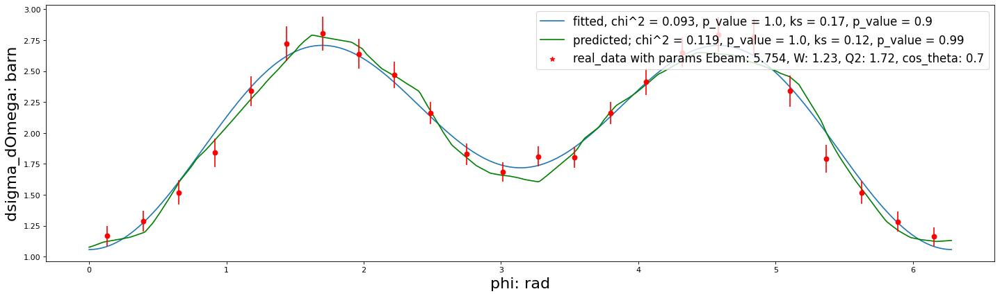

0 5.754 1.23 1.72 0.8
a = 2.025615184232393 , b = -0.3911229072499763, c = -0.2103320575037507


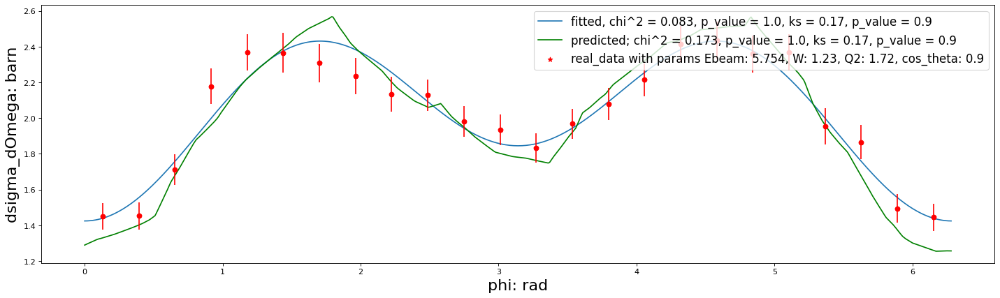


 25%|██▌       | 1/4 [00:04<00:13,  4.56s/it]

0 5.754 1.53 1.72 -0.9
0 5.754 1.53 1.72 -0.8
a = 1.4716633684420133 , b = -0.3402383692972722, c = 0.1597189984252181


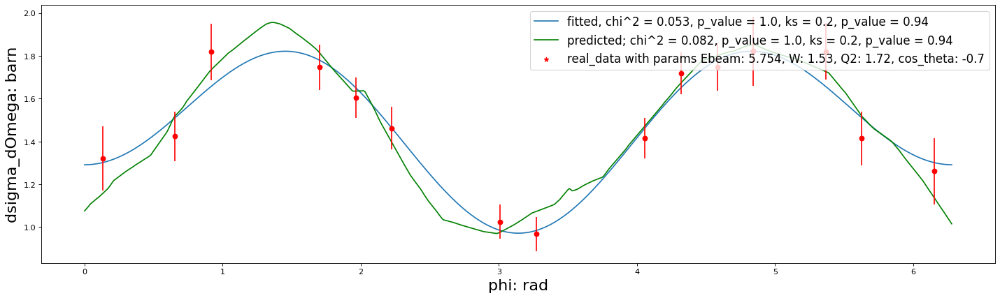

0 5.754 1.53 1.72 -0.6
a = 1.9375179890263081 , b = -0.3523054755152565, c = 0.34435172593707036


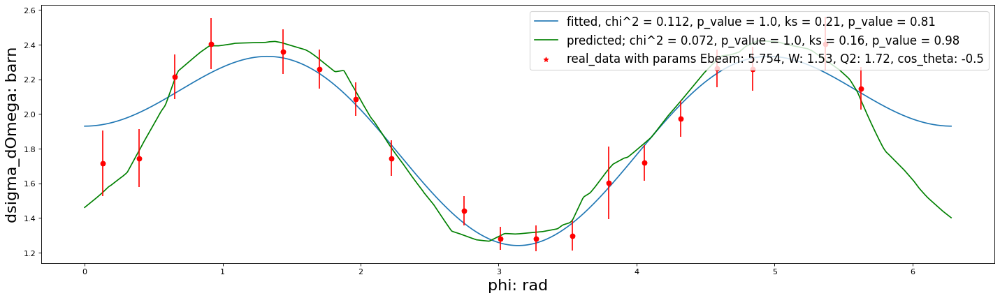

0 5.754 1.53 1.72 -0.4
a = 2.265024305432866 , b = -0.4481300677809356, c = 0.30525221287892834


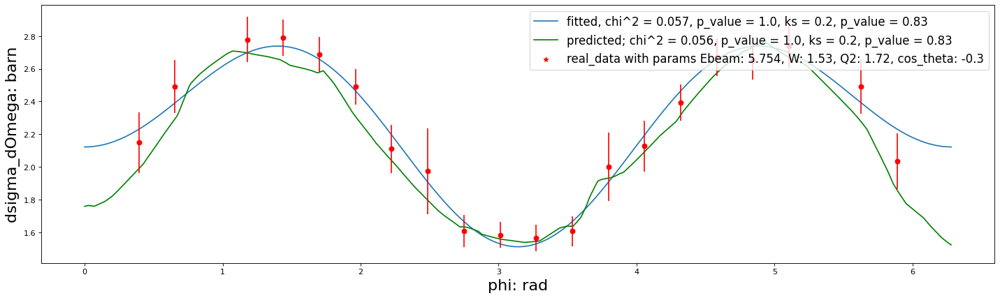

0 5.754 1.53 1.72 -0.2
a = 2.003556602279458 , b = -0.5286080051260531, c = 0.0576799754071784


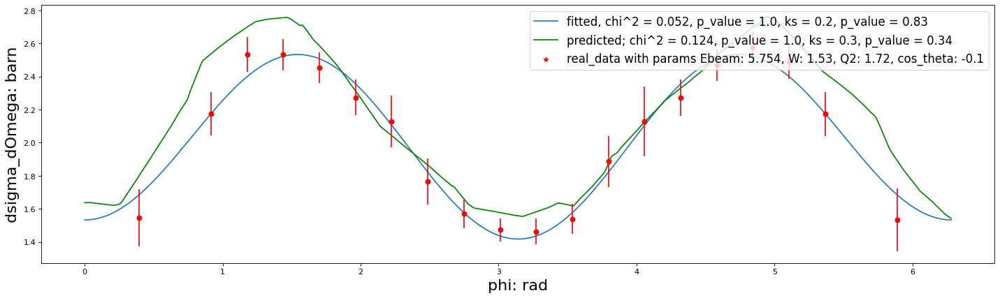

a = 2.081457261711121 , b = -0.3601270682137221, c = 0.21436568223329608


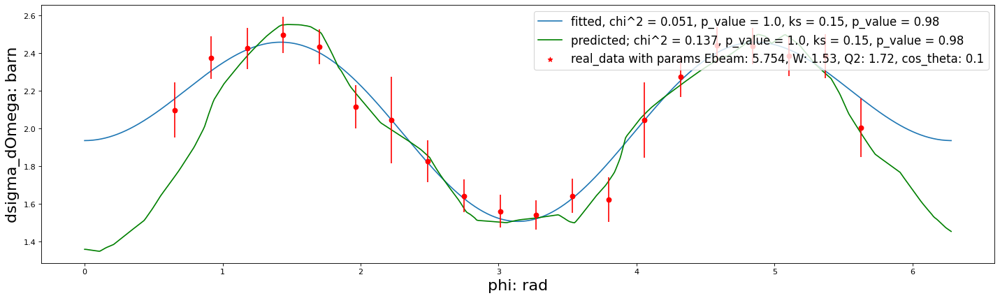

0 5.754 1.53 1.72 0.2
a = 1.7428426575342302 , b = -0.5459630683698233, c = -0.20964286870885035


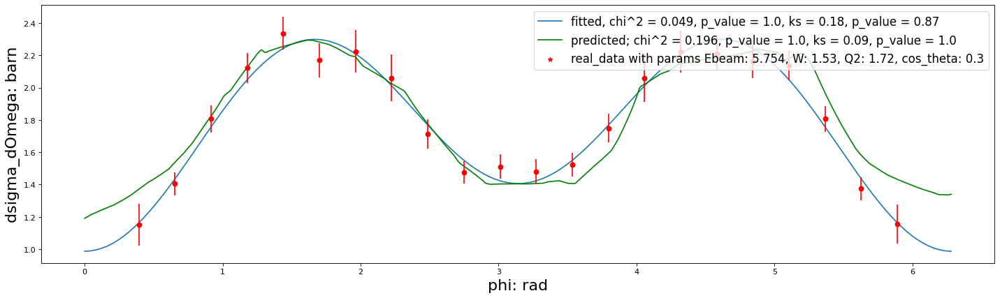

0 5.754 1.53 1.72 0.4
a = 1.7433783596576764 , b = -0.4777839846443417, c = -0.07328402705405379


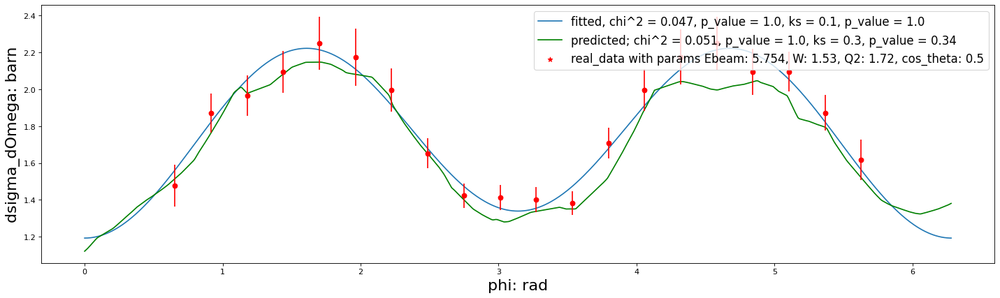

0 5.754 1.53 1.72 0.6
a = 1.6507712435042659 , b = -0.3499386194889751, c = 0.0455019930449615


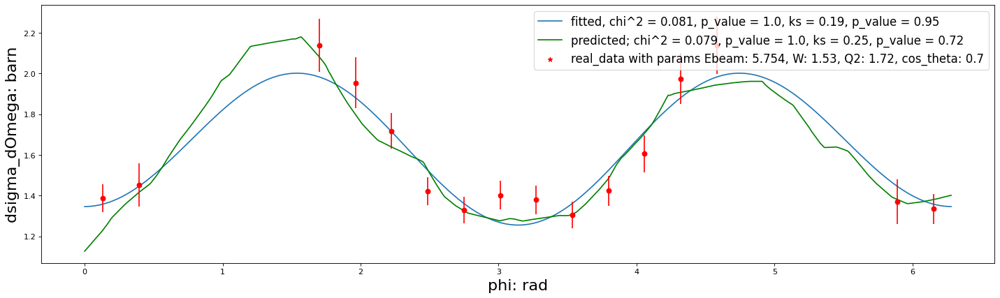

0 5.754 1.53 1.72 0.8
a = 1.552738590024736 , b = -0.08434797214266876, c = 0.023274602911101838


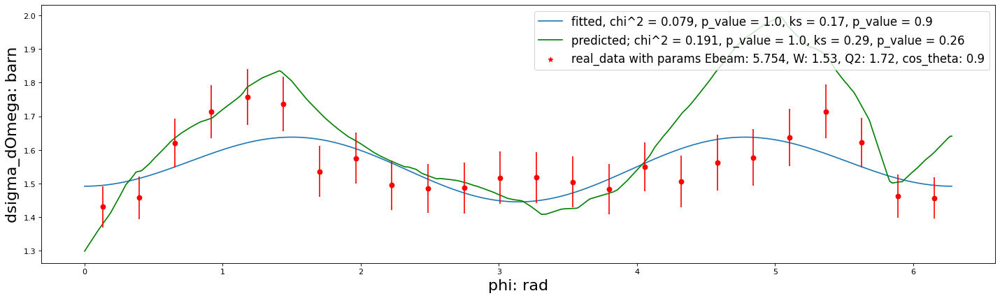


 18%|█▊        | 2/11 [00:26<01:55, 12.87s/it]

0 5.754 1.71 1.72 -0.9
0 5.754 1.71 1.72 -0.8
0 5.754 1.71 1.72 -0.7
0 5.754 1.71 1.72 -0.6
0 5.754 1.71 1.72 -0.5
0 5.754 1.71 1.72 -0.4
0 5.754 1.71 1.72 -0.3
0 5.754 1.71 1.72 -0.2
0 5.754 1.71 1.72 -0.1
0 5.754 1.71 1.72 0.1
0 5.754 1.71 1.72 0.2
0 5.754 1.71 1.72 0.3
0 5.754 1.71 1.72 0.4
0 5.754 1.71 1.72 0.5
0 5.754 1.71 1.72 0.6
0 5.754 1.71 1.72 0.7
0 5.754 1.71 1.72 0.8
0 5.754 1.71 1.72 0.9
0 5.754 1.95 1.72 -0.9
0 5.754 1.95 1.72 -0.8
0 5.754 1.95 1.72 -0.7
0 5.754 1.95 1.72 -0.6
0 5.754 1.95 1.72 -0.5
0 5.754 1.95 1.72 -0.4
0 5.754 1.95 1.72 -0.3
0 5.754 1.95 1.72 -0.2
0 5.754 1.95 1.72 -0.1
0 5.754 1.95 1.72 0.1
0 5.754 1.95 1.72 0.2
0 5.754 1.95 1.72 0.3
0 5.754 1.95 1.72 0.4
0 5.754 1.95 1.72 0.5
0 5.754 1.95 1.72 0.6
0 5.754 1.95 1.72 0.7
0 5.754 1.95 1.72 0.8
0 5.754 1.95 1.72 0.9



  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 1.8 -0.9
0 5.754 1.23 1.8 -0.8
0 5.754 1.23 1.8 -0.7
0 5.754 1.23 1.8 -0.6
0 5.754 1.23 1.8 -0.5
0 5.754 1.23 1.8 -0.4
0 5.754 1.23 1.8 -0.3
0 5.754 1.23 1.8 -0.2
0 5.754 1.23 1.8 -0.1
0 5.754 1.23 1.8 0.1
0 5.754 1.23 1.8 0.2
0 5.754 1.23 1.8 0.3
0 5.754 1.23 1.8 0.4
0 5.754 1.23 1.8 0.5
0 5.754 1.23 1.8 0.6
0 5.754 1.23 1.8 0.7
0 5.754 1.23 1.8 0.8
0 5.754 1.23 1.8 0.9
0 5.754 1.53 1.8 -0.9
0 5.754 1.53 1.8 -0.8
0 5.754 1.53 1.8 -0.7
0 5.754 1.53 1.8 -0.6
0 5.754 1.53 1.8 -0.5
0 5.754 1.53 1.8 -0.4
0 5.754 1.53 1.8 -0.3
0 5.754 1.53 1.8 -0.2
0 5.754 1.53 1.8 -0.1
0 5.754 1.53 1.8 0.1
0 5.754 1.53 1.8 0.2
0 5.754 1.53 1.8 0.3
0 5.754 1.53 1.8 0.4
0 5.754 1.53 1.8 0.5
0 5.754 1.53 1.8 0.6
0 5.754 1.53 1.8 0.7
0 5.754 1.53 1.8 0.8
0 5.754 1.53 1.8 0.9
0 5.754 1.71 1.8 -0.9
0 5.754 1.71 1.8 -0.8
0 5.754 1.71 1.8 -0.7
0 5.754 1.71 1.8 -0.6
0 5.754 1.71 1.8 -0.5
0 5.754 1.71 1.8 -0.4
0 5.754 1.71 1.8 -0.3
0 5.754 1.71 1.8 -0.2
0 5.754 1.71 1.8 -0.1
0 5.754 1.71 1.8 0.1
0 5.754


 27%|██▋       | 3/11 [00:26<00:56,  7.07s/it]

0 5.754 1.71 1.8 0.9
0 5.754 1.95 1.8 -0.9
0 5.754 1.95 1.8 -0.8
0 5.754 1.95 1.8 -0.7
0 5.754 1.95 1.8 -0.6
0 5.754 1.95 1.8 -0.5
0 5.754 1.95 1.8 -0.4
0 5.754 1.95 1.8 -0.3
0 5.754 1.95 1.8 -0.2
0 5.754 1.95 1.8 -0.1
0 5.754 1.95 1.8 0.1
0 5.754 1.95 1.8 0.2
0 5.754 1.95 1.8 0.3
0 5.754 1.95 1.8 0.4
0 5.754 1.95 1.8 0.5
0 5.754 1.95 1.8 0.6
0 5.754 1.95 1.8 0.7
0 5.754 1.95 1.8 0.8
0 5.754 1.95 1.8 0.9



  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 2.05 -0.9
0 5.754 1.23 2.05 -0.8
a = 1.9649015664713132 , b = 0.2056357526517308, c = -1.7605222073691513


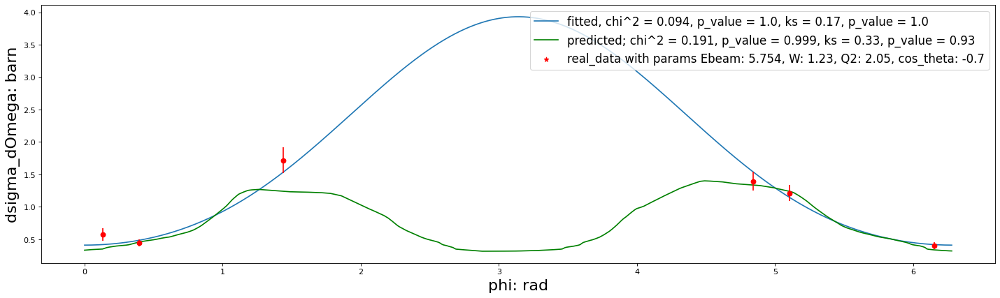

0 5.754 1.23 2.05 -0.6
a = 0.9672862082225838 , b = -0.5121806633361008, c = -0.03300578584182645


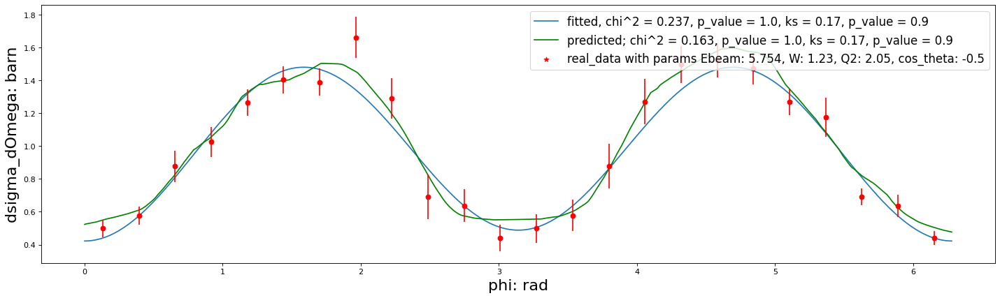

0 5.754 1.23 2.05 -0.4
a = 1.1582555185046435 , b = -0.6638550391114404, c = -0.011049362418536601


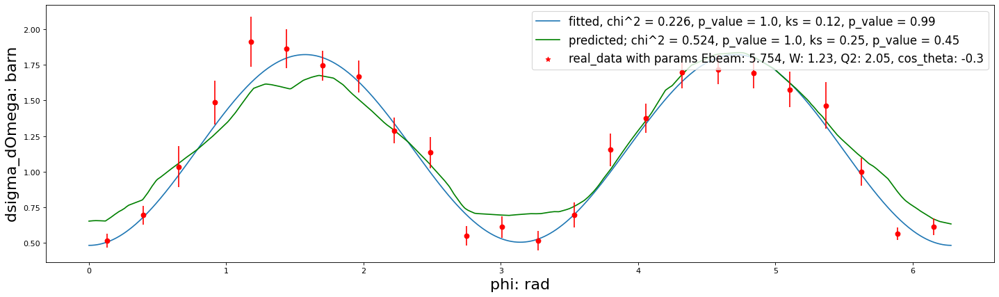

0 5.754 1.23 2.05 -0.2
a = 1.3106474115957625 , b = -0.5249124139574896, c = 0.05628183349170957


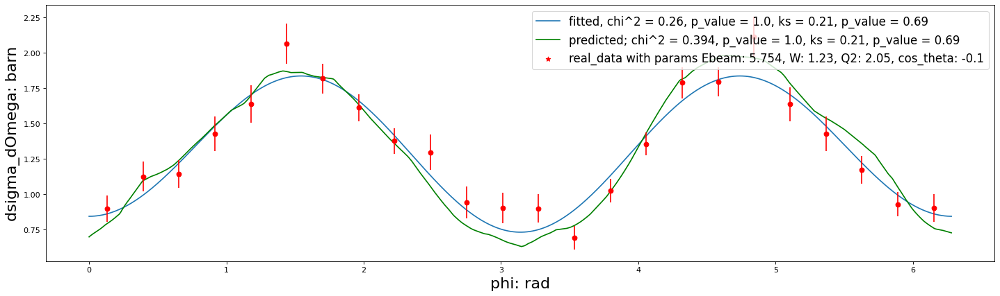

a = 1.380896259279656 , b = -0.7000105482776651, c = 0.2117383781789972


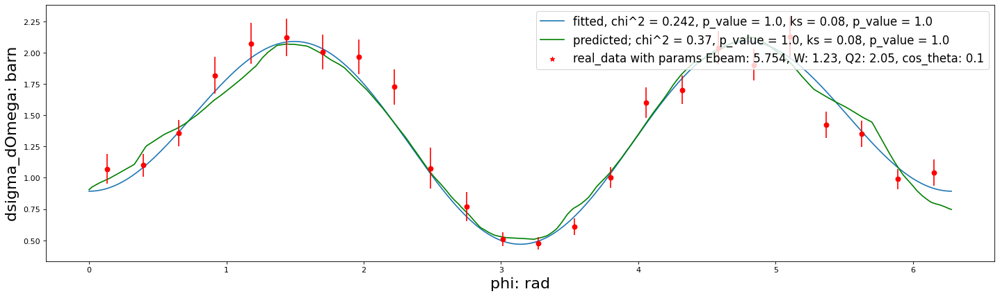

0 5.754 1.23 2.05 0.2
a = 1.4491365345497491 , b = -0.6991179344459617, c = 0.25272296822660634


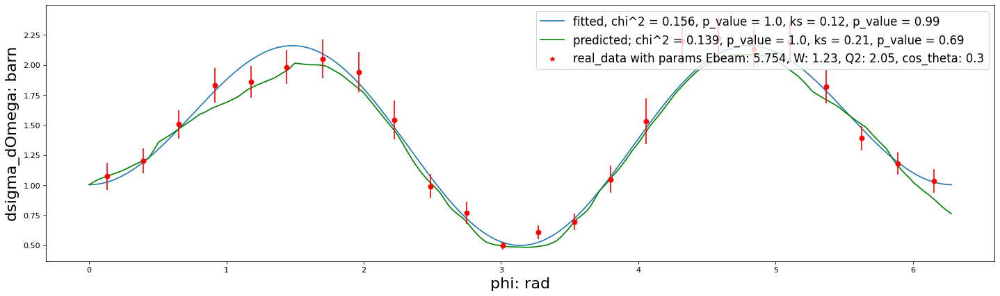

0 5.754 1.23 2.05 0.4
a = 1.3051615061937643 , b = -0.49476945011086115, c = 0.2290503502034101


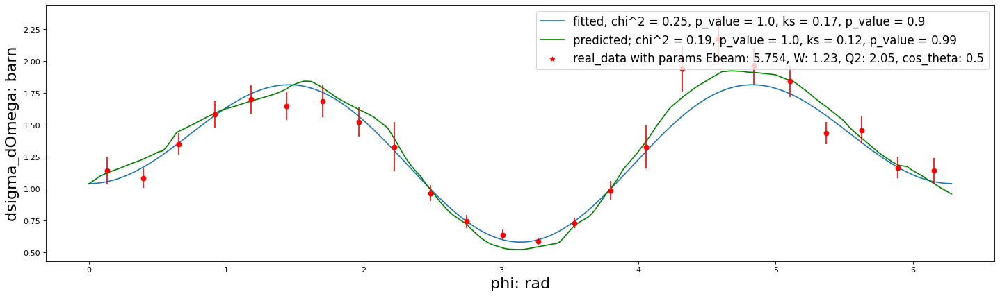

0 5.754 1.23 2.05 0.6
a = 1.2041896190325958 , b = -0.3214020135302569, c = 0.1966974072940035


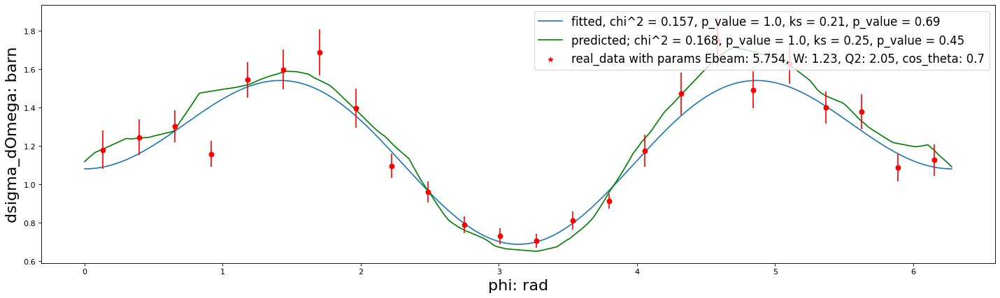

0 5.754 1.23 2.05 0.8
a = 1.226792853495651 , b = -0.1986622523684882, c = 0.21131863121776664


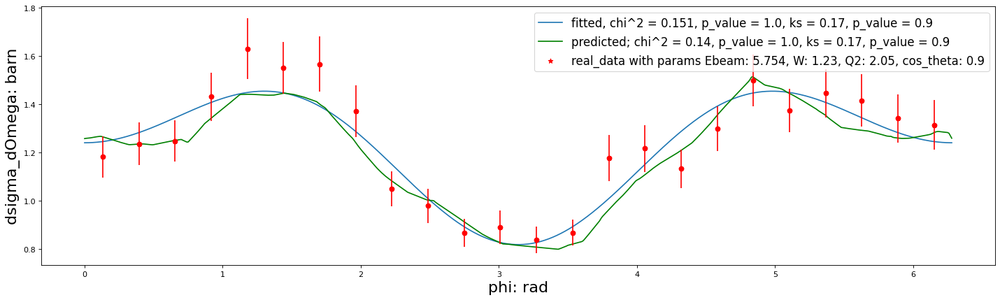


 25%|██▌       | 1/4 [00:06<00:19,  6.65s/it]

a = 0.5535748996939793 , b = -0.039585435950718215, c = 0.0135879271586324


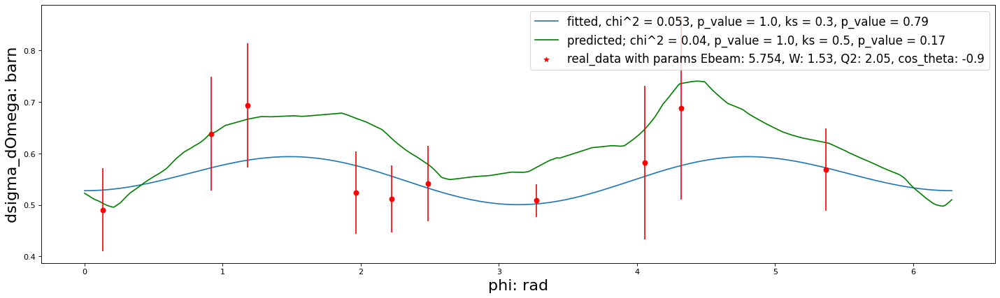

0 5.754 1.53 2.05 -0.8
a = 0.947394584700953 , b = -0.14637410923666408, c = -0.09777813916283053


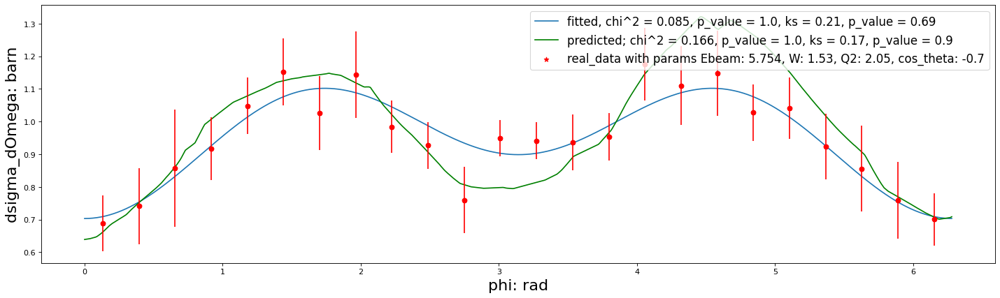

0 5.754 1.53 2.05 -0.6
a = 1.2918058080091694 , b = -0.2750707021628863, c = -0.10166962438447906


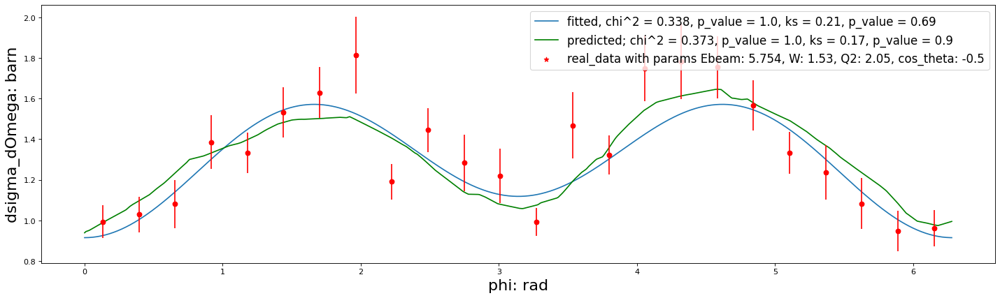

0 5.754 1.53 2.05 -0.4
a = 1.468114860107653 , b = -0.3144066561749485, c = -0.05898359489724101


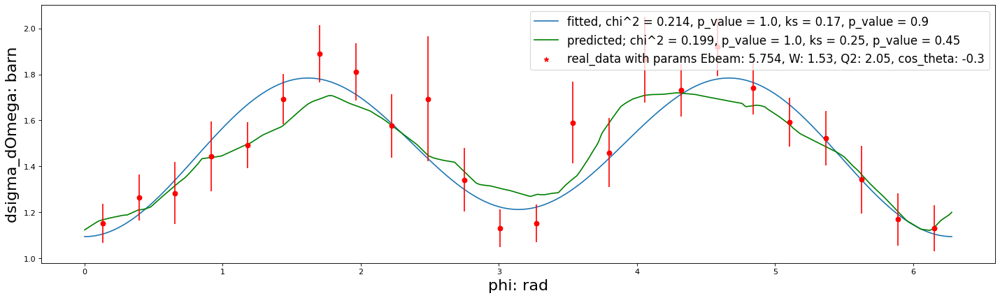

0 5.754 1.53 2.05 -0.2
a = 1.4211204518827951 , b = -0.22669180202659459, c = -0.02485960220407251


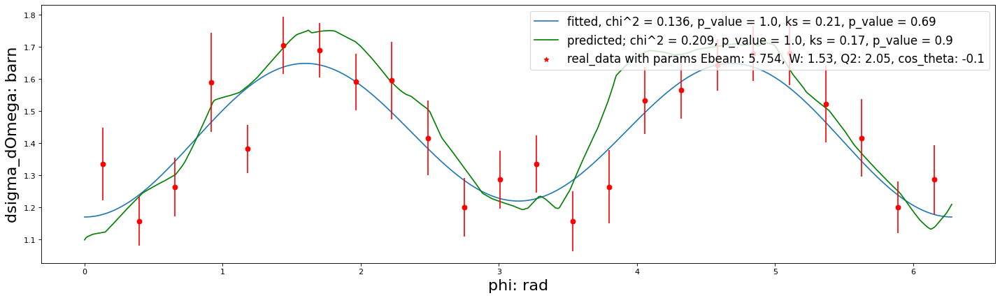

a = 1.3911383461883855 , b = -0.2404008304695086, c = -0.042481617118167635


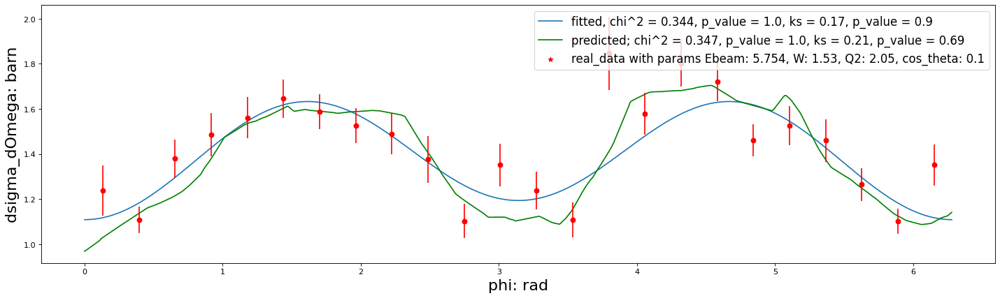

0 5.754 1.53 2.05 0.2
a = 1.1786728113903095 , b = -0.2867453394380739, c = -0.026295039465582315


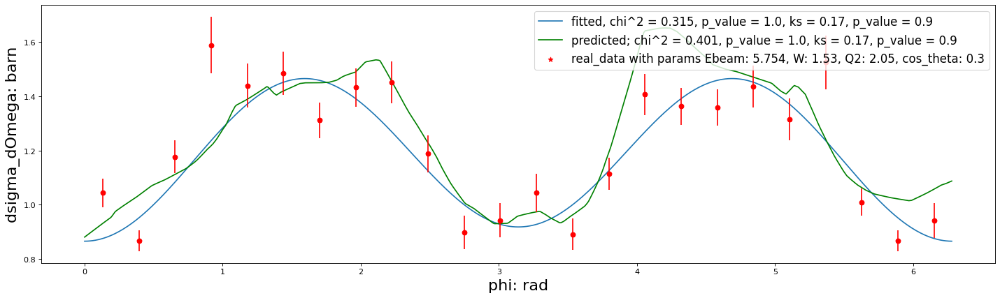

0 5.754 1.53 2.05 0.4
a = 1.1223356708901142 , b = -0.3422523245315422, c = 0.05261313574953851


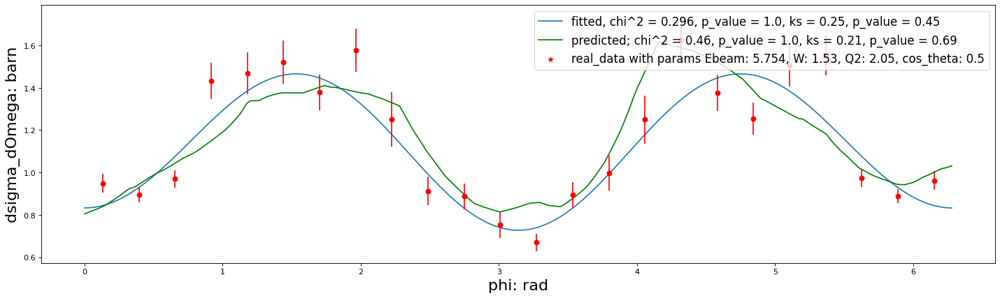

0 5.754 1.53 2.05 0.6
a = 1.0492824372635374 , b = -0.22927799991237013, c = 0.02644816906784234


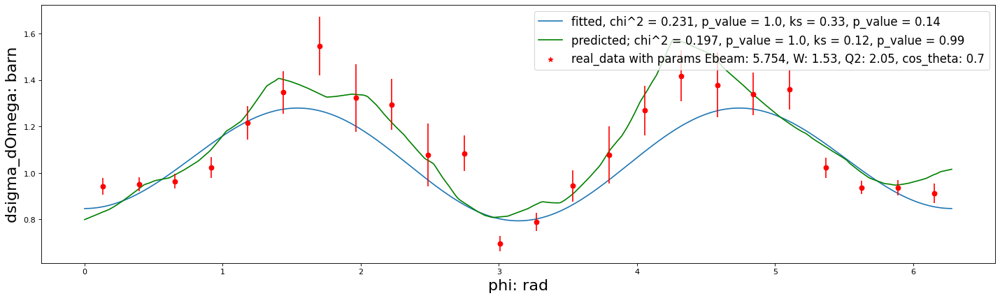

0 5.754 1.53 2.05 0.8
a = 1.0108230186879914 , b = -0.031805326074914486, c = 0.007831470032609533


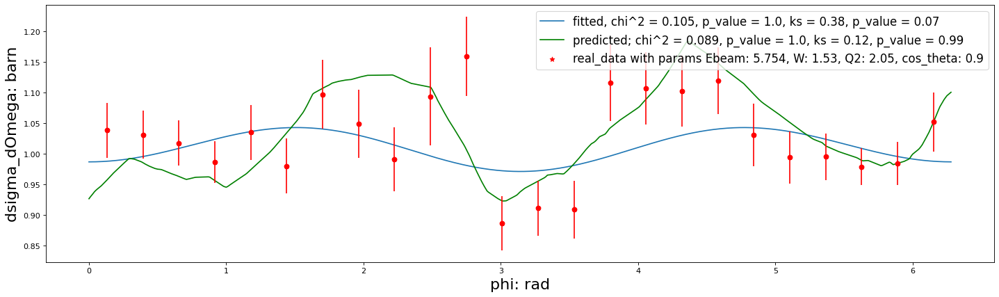


 50%|█████     | 2/4 [00:14<00:14,  7.31s/it]

a = 0.3143062117089564 , b = 0.0058427610432533455, c = 0.035297365302754444


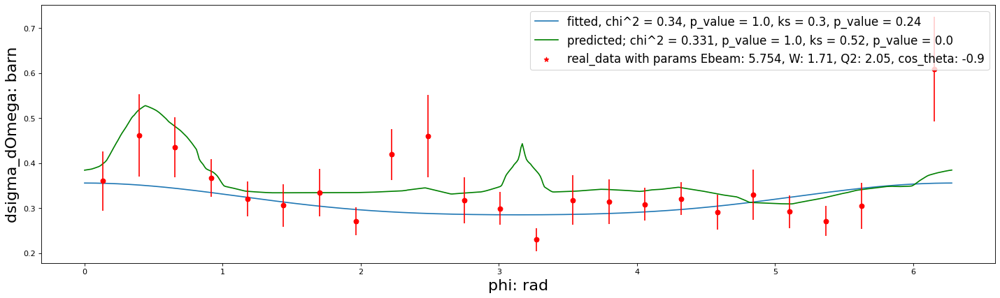

0 5.754 1.71 2.05 -0.8
a = 0.27465577663114615 , b = 0.0030814224977643817, c = -0.007774618033226471


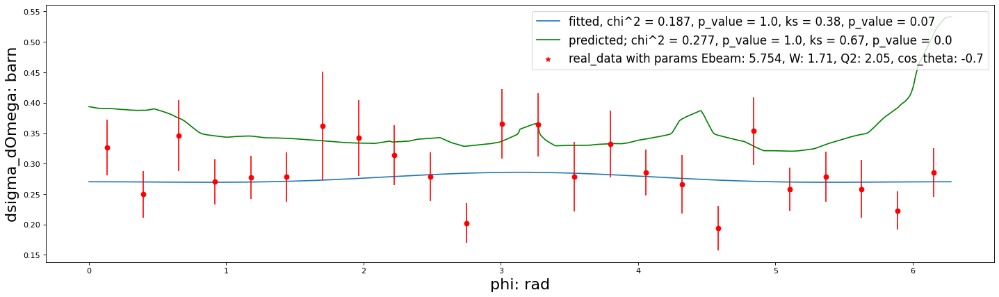

0 5.754 1.71 2.05 -0.6
a = 0.2731063934765277 , b = -0.009804862615009369, c = 0.022213559834599914


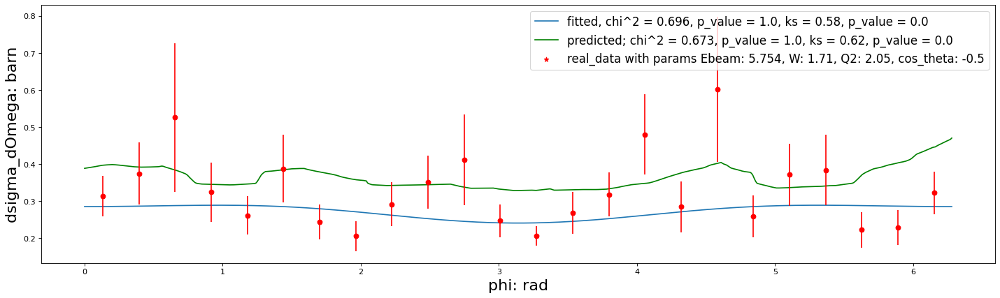

0 5.754 1.71 2.05 -0.4
a = 0.3374586446343276 , b = -0.006000716126773044, c = -0.021156575026095435


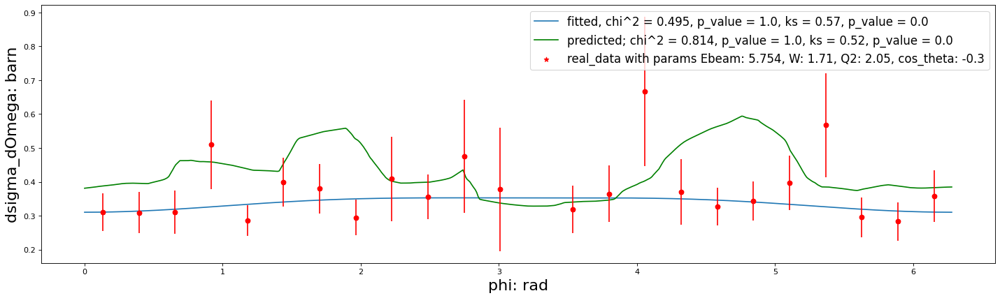

0 5.754 1.71 2.05 -0.2
a = 0.41568783085555944 , b = -0.10573956500028298, c = -0.03723928198181481


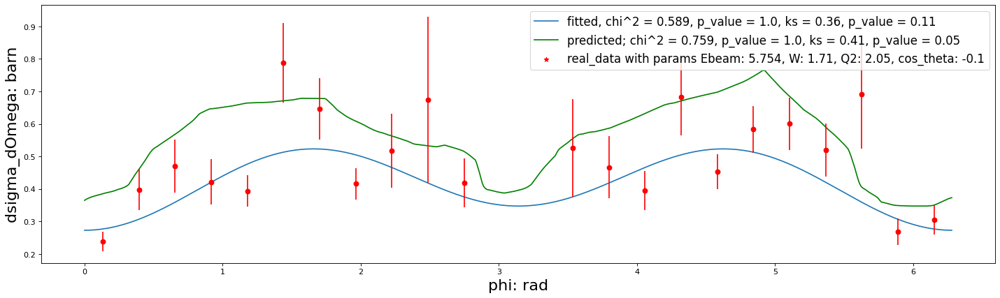

a = 0.46411253754008985 , b = -0.18456767242282957, c = -0.017426453122991292


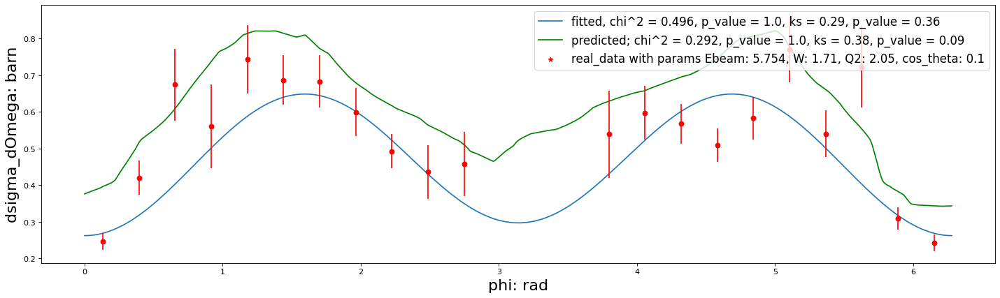

0 5.754 1.71 2.05 0.2
a = 0.4836167703509682 , b = -0.20729039851907036, c = -0.02587472305917629


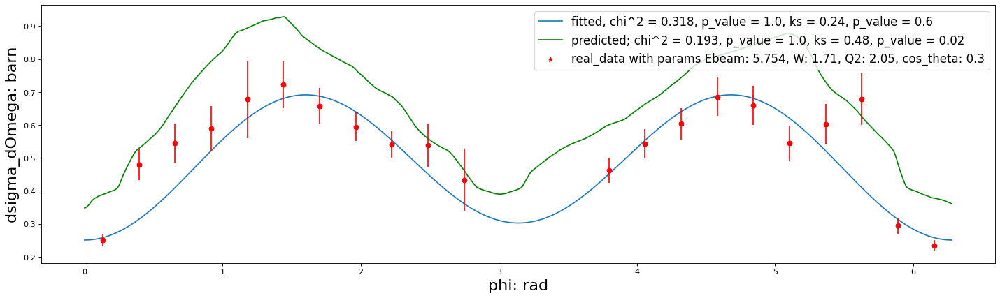

0 5.754 1.71 2.05 0.4
a = 0.47148222214239516 , b = -0.18976721309863034, c = 0.04108467263432643


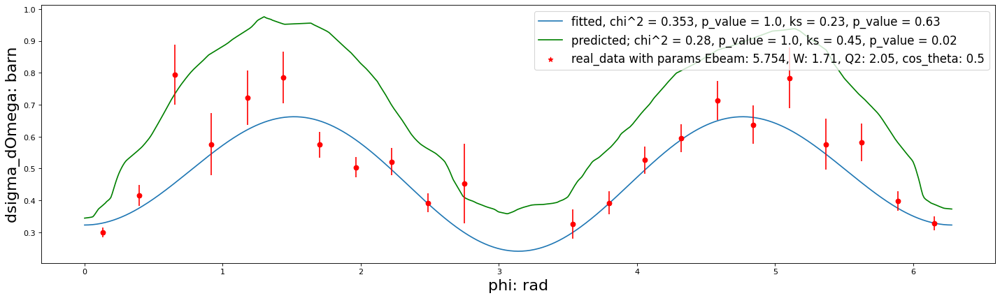

0 5.754 1.71 2.05 0.6
a = 0.5492927351866874 , b = -0.15104872319721627, c = 0.09417416470287629


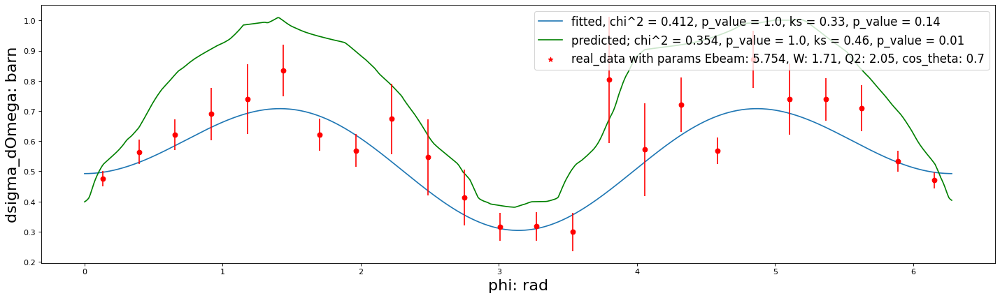

0 5.754 1.71 2.05 0.8
a = 0.7186582804347813 , b = -0.06069763479096659, c = 0.17747371091028494


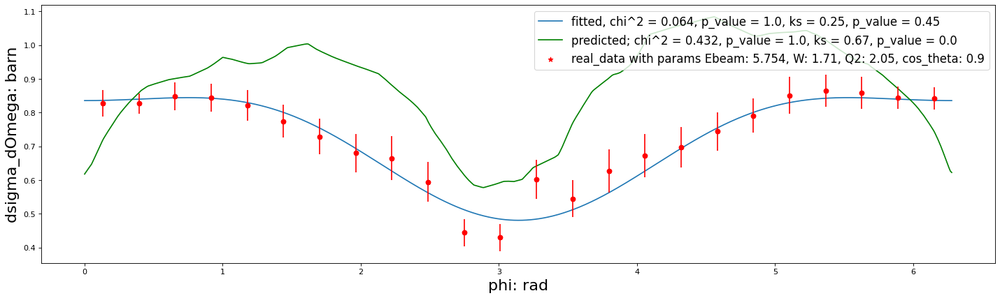


 36%|███▋      | 4/11 [00:50<01:35, 13.65s/it]

0 5.754 1.95 2.05 -0.9
0 5.754 1.95 2.05 -0.8
0 5.754 1.95 2.05 -0.7
0 5.754 1.95 2.05 -0.6
0 5.754 1.95 2.05 -0.5
0 5.754 1.95 2.05 -0.4
0 5.754 1.95 2.05 -0.3
0 5.754 1.95 2.05 -0.2
0 5.754 1.95 2.05 -0.1
0 5.754 1.95 2.05 0.1
0 5.754 1.95 2.05 0.2
0 5.754 1.95 2.05 0.3
0 5.754 1.95 2.05 0.4
0 5.754 1.95 2.05 0.5
0 5.754 1.95 2.05 0.6
0 5.754 1.95 2.05 0.7
0 5.754 1.95 2.05 0.8
0 5.754 1.95 2.05 0.9



 75%|███████▌  | 3/4 [00:00<00:00, 22.73it/s]

0 5.754 1.23 2.115 -0.9
0 5.754 1.23 2.115 -0.8
0 5.754 1.23 2.115 -0.7
0 5.754 1.23 2.115 -0.6
0 5.754 1.23 2.115 -0.5
0 5.754 1.23 2.115 -0.4
0 5.754 1.23 2.115 -0.3
0 5.754 1.23 2.115 -0.2
0 5.754 1.23 2.115 -0.1
0 5.754 1.23 2.115 0.1
0 5.754 1.23 2.115 0.2
0 5.754 1.23 2.115 0.3
0 5.754 1.23 2.115 0.4
0 5.754 1.23 2.115 0.5
0 5.754 1.23 2.115 0.6
0 5.754 1.23 2.115 0.7
0 5.754 1.23 2.115 0.8
0 5.754 1.23 2.115 0.9
0 5.754 1.53 2.115 -0.9
0 5.754 1.53 2.115 -0.8
0 5.754 1.53 2.115 -0.7
0 5.754 1.53 2.115 -0.6
0 5.754 1.53 2.115 -0.5
0 5.754 1.53 2.115 -0.4
0 5.754 1.53 2.115 -0.3
0 5.754 1.53 2.115 -0.2
0 5.754 1.53 2.115 -0.1
0 5.754 1.53 2.115 0.1
0 5.754 1.53 2.115 0.2
0 5.754 1.53 2.115 0.3
0 5.754 1.53 2.115 0.4
0 5.754 1.53 2.115 0.5
0 5.754 1.53 2.115 0.6
0 5.754 1.53 2.115 0.7
0 5.754 1.53 2.115 0.8
0 5.754 1.53 2.115 0.9
0 5.754 1.71 2.115 -0.9
0 5.754 1.71 2.115 -0.8
0 5.754 1.71 2.115 -0.7
0 5.754 1.71 2.115 -0.6
0 5.754 1.71 2.115 -0.5
0 5.754 1.71 2.115 -0.4
0 5.754 1.

 45%|████▌     | 5/11 [00:50<00:52,  8.80s/it]

0 5.754 1.95 2.115 -0.6
0 5.754 1.95 2.115 -0.5
0 5.754 1.95 2.115 -0.4
0 5.754 1.95 2.115 -0.3
0 5.754 1.95 2.115 -0.2
0 5.754 1.95 2.115 -0.1
0 5.754 1.95 2.115 0.1
0 5.754 1.95 2.115 0.2
0 5.754 1.95 2.115 0.3
0 5.754 1.95 2.115 0.4
0 5.754 1.95 2.115 0.5
0 5.754 1.95 2.115 0.6
0 5.754 1.95 2.115 0.7
0 5.754 1.95 2.115 0.8
0 5.754 1.95 2.115 0.9



  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 2.44 -0.9
0 5.754 1.23 2.44 -0.8
0 5.754 1.23 2.44 -0.7
0 5.754 1.23 2.44 -0.6
a = 0.6931705257856744 , b = -0.28167511828102587, c = 0.09951916384220588


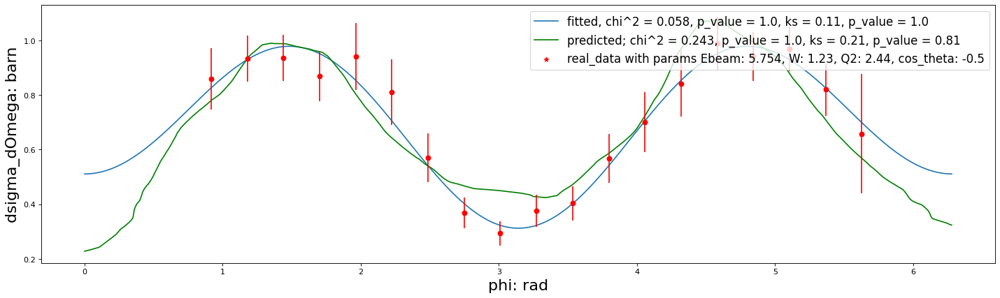

0 5.754 1.23 2.44 -0.4
a = 0.8546800876298042 , b = -0.3094078216943321, c = 0.09220682531115121


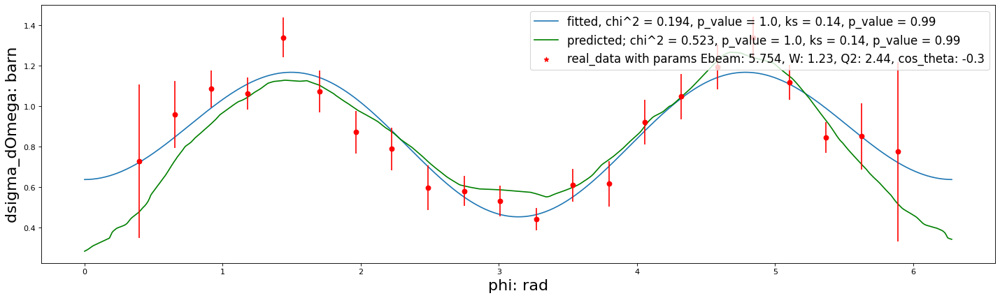

0 5.754 1.23 2.44 -0.2
a = 0.9451589662653229 , b = -0.3339299219177904, c = 0.035642760591073165


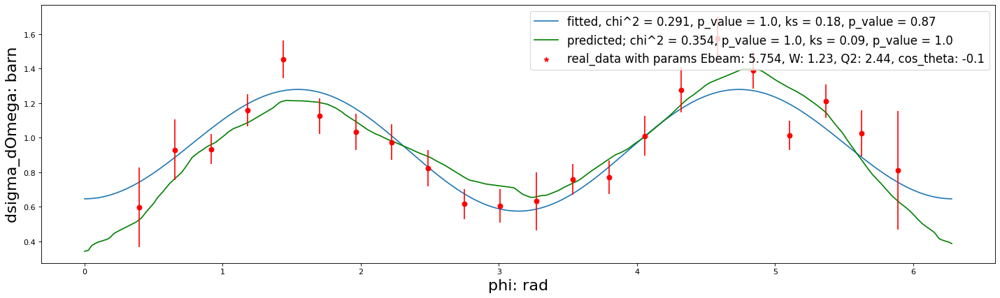

a = 0.9726134078476714 , b = -0.3526593771197868, c = -0.07327237547728412


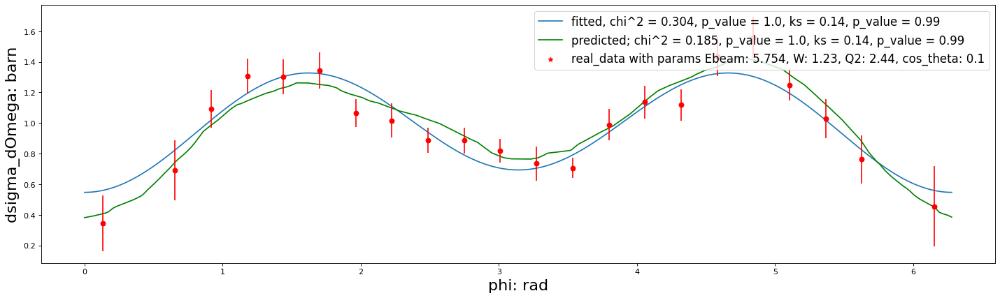

0 5.754 1.23 2.44 0.2
a = 0.9912224715371977 , b = -0.37684849634149964, c = -0.20092380542328372


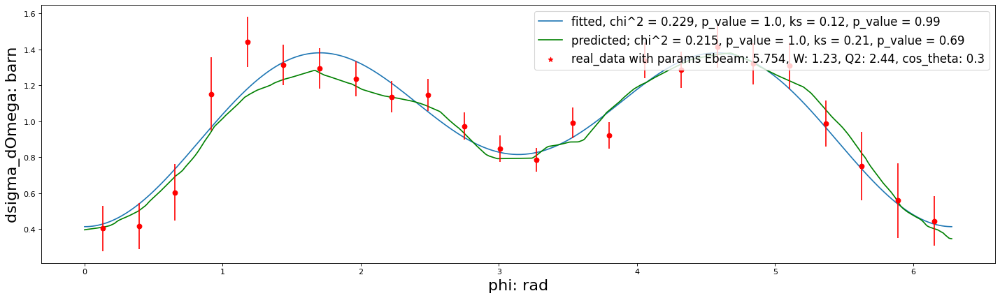

0 5.754 1.23 2.44 0.4
a = 0.8972481658063333 , b = -0.29372884608103156, c = -0.21318854819357697


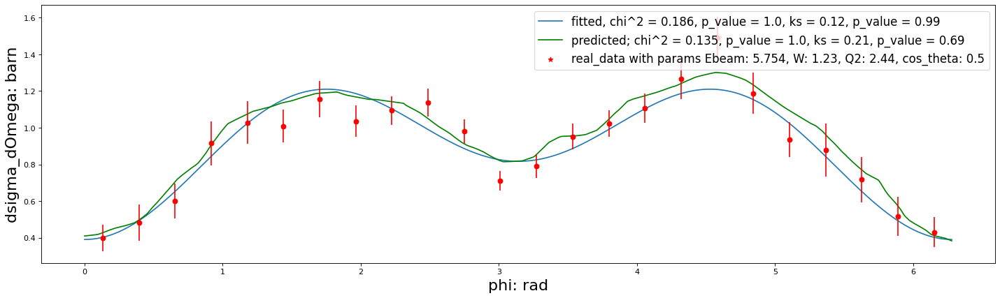

0 5.754 1.23 2.44 0.6
a = 0.9105380531092699 , b = -0.24147217169559013, c = -0.20264033069448606


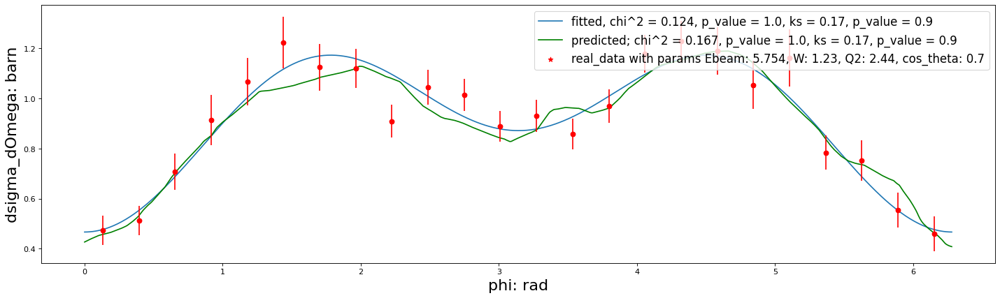

0 5.754 1.23 2.44 0.8
a = 0.8738842807916599 , b = -0.11431785118363127, c = -0.16035317459417905


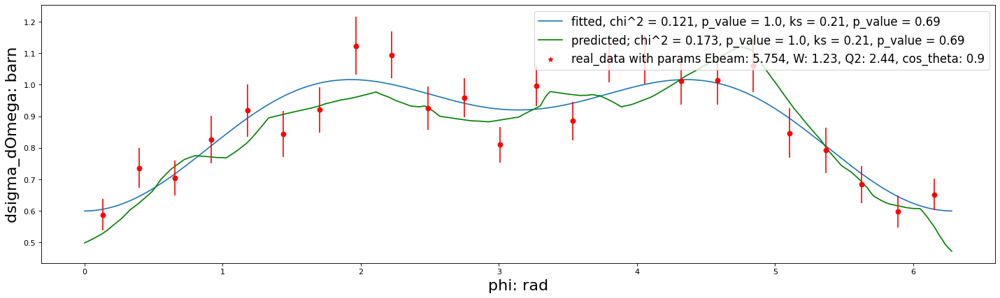


 25%|██▌       | 1/4 [00:06<00:19,  6.50s/it]

a = 0.4063950179384046 , b = -0.09558213732126175, c = -0.005695507239330988


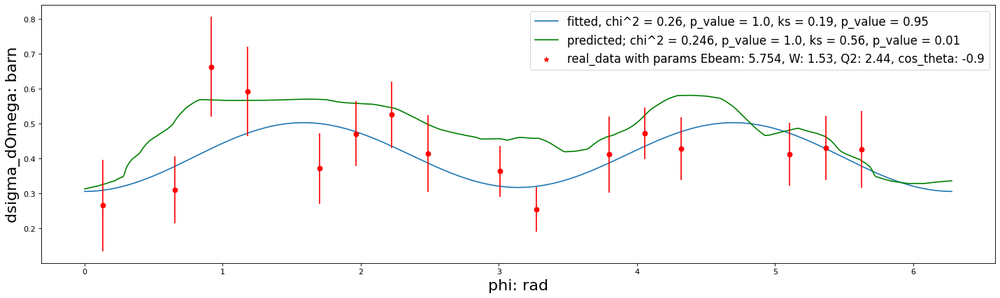

0 5.754 1.53 2.44 -0.8
a = 0.748390921425621 , b = -0.14757835109087122, c = -0.017706951747712633


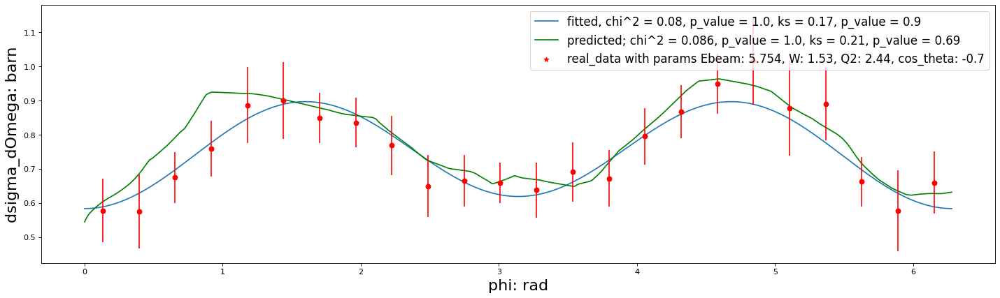

0 5.754 1.53 2.44 -0.6
a = 1.0581847116452345 , b = -0.13016681823576956, c = 0.14181388332924155


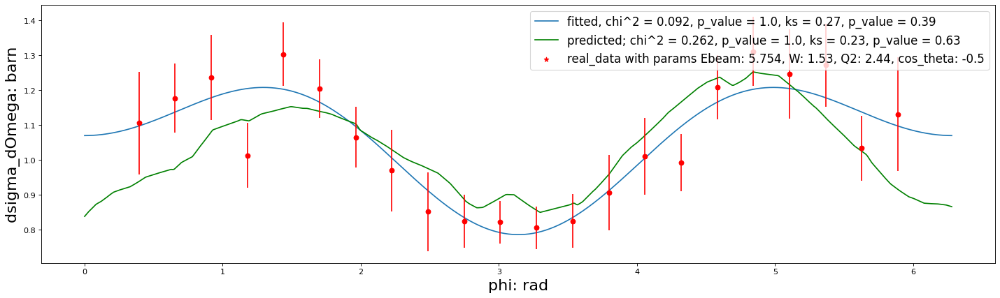

0 5.754 1.53 2.44 -0.4
a = 1.171599864465927 , b = -0.11762219231395628, c = 0.1308603670077882


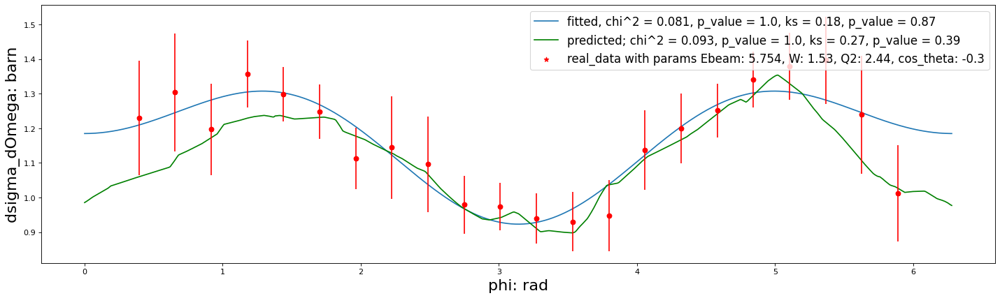

0 5.754 1.53 2.44 -0.2
a = 1.1832329533862842 , b = -0.10517976889581804, c = 0.08889920782066507


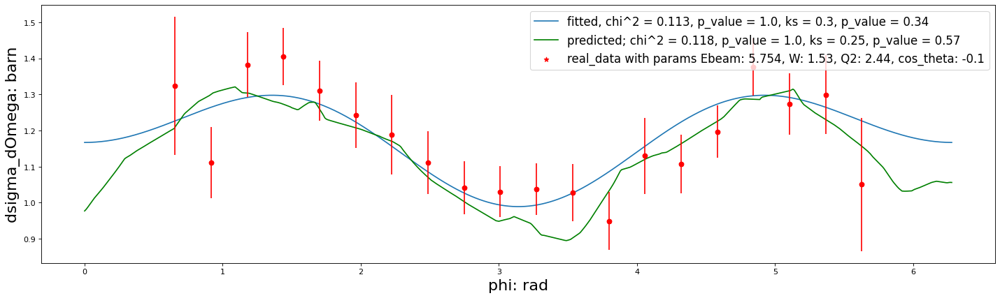

a = 1.072956277570389 , b = -0.15429906418740802, c = -0.03591910540042065


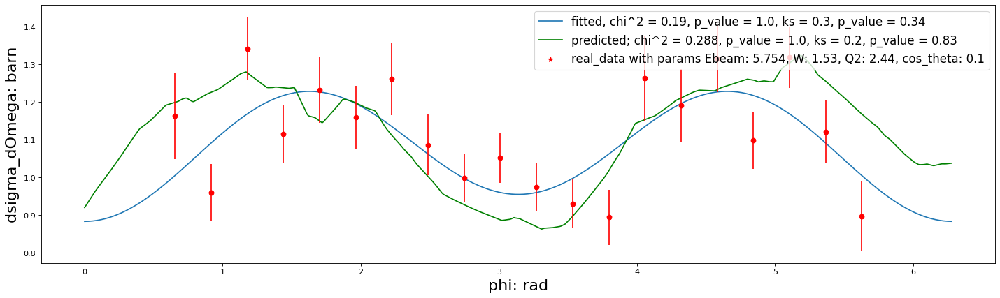

0 5.754 1.53 2.44 0.2
a = 1.0495572648229272 , b = -0.09716267864900896, c = 0.08532469779995899


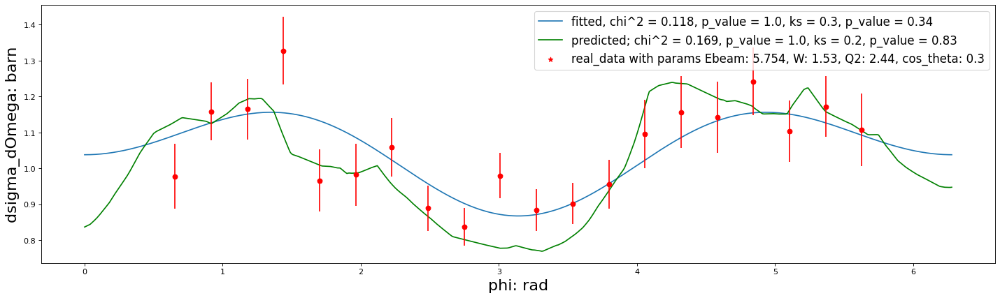

0 5.754 1.53 2.44 0.4
a = 0.869171827738563 , b = -0.14969168541284505, c = 0.05011757020590543


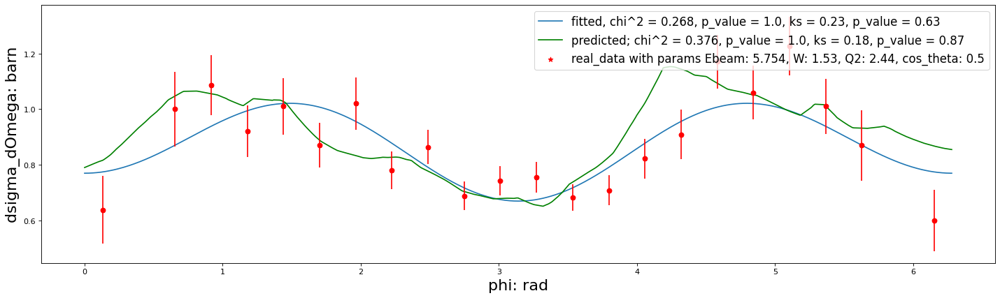

0 5.754 1.53 2.44 0.6
a = 0.7931217611852048 , b = -0.08403256457734398, c = 0.0937975469661369


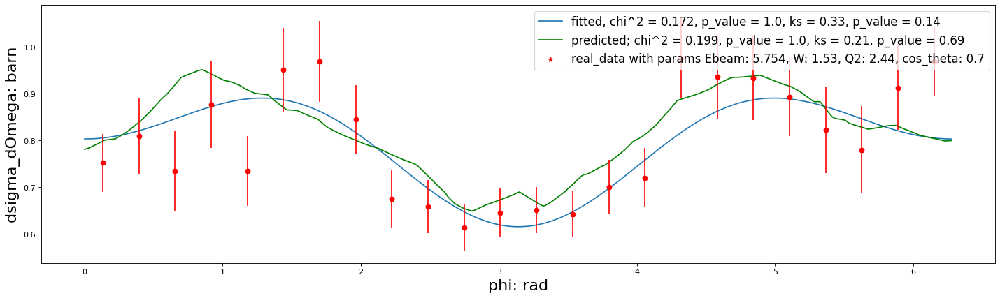

0 5.754 1.53 2.44 0.8
a = 0.7045849183022647 , b = 0.004564937736764474, c = 0.015760500797893484


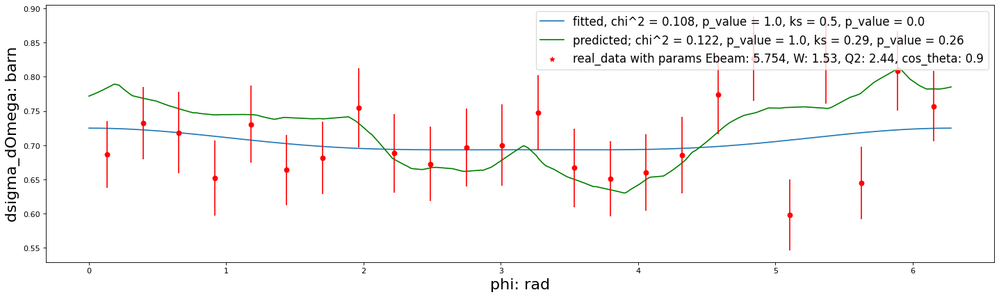


 55%|█████▍    | 6/11 [01:05<00:54, 10.81s/it]

0 5.754 1.71 2.44 -0.9
0 5.754 1.71 2.44 -0.8
0 5.754 1.71 2.44 -0.7
0 5.754 1.71 2.44 -0.6
0 5.754 1.71 2.44 -0.5
0 5.754 1.71 2.44 -0.4
0 5.754 1.71 2.44 -0.3
0 5.754 1.71 2.44 -0.2
0 5.754 1.71 2.44 -0.1
0 5.754 1.71 2.44 0.1
0 5.754 1.71 2.44 0.2
0 5.754 1.71 2.44 0.3
0 5.754 1.71 2.44 0.4
0 5.754 1.71 2.44 0.5
0 5.754 1.71 2.44 0.6
0 5.754 1.71 2.44 0.7
0 5.754 1.71 2.44 0.8
0 5.754 1.71 2.44 0.9
0 5.754 1.95 2.44 -0.9
0 5.754 1.95 2.44 -0.8
0 5.754 1.95 2.44 -0.7
0 5.754 1.95 2.44 -0.6
0 5.754 1.95 2.44 -0.5
0 5.754 1.95 2.44 -0.4
0 5.754 1.95 2.44 -0.3
0 5.754 1.95 2.44 -0.2
0 5.754 1.95 2.44 -0.1
0 5.754 1.95 2.44 0.1
0 5.754 1.95 2.44 0.2
0 5.754 1.95 2.44 0.3
0 5.754 1.95 2.44 0.4
0 5.754 1.95 2.44 0.5
0 5.754 1.95 2.44 0.6
0 5.754 1.95 2.44 0.7
0 5.754 1.95 2.44 0.8
0 5.754 1.95 2.44 0.9



  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 2.445 -0.9
0 5.754 1.23 2.445 -0.8
a = 1.0195179779321166 , b = 0.03404030697943189, c = -0.6264129147557509


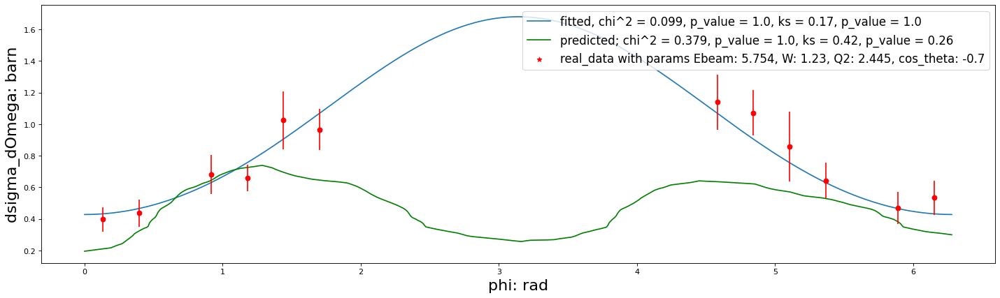

0 5.754 1.23 2.445 -0.6
a = 0.6866942601589355 , b = -0.28189543597333216, c = -0.09703110050004214


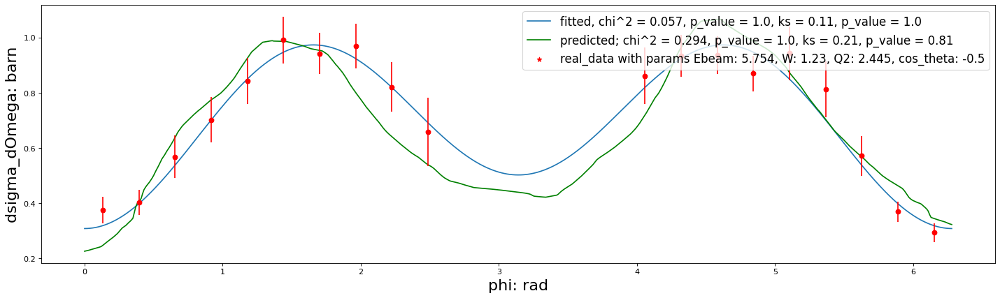

0 5.754 1.23 2.445 -0.4
a = 0.8485556094414527 , b = -0.2791503545512835, c = -0.12137111180769028


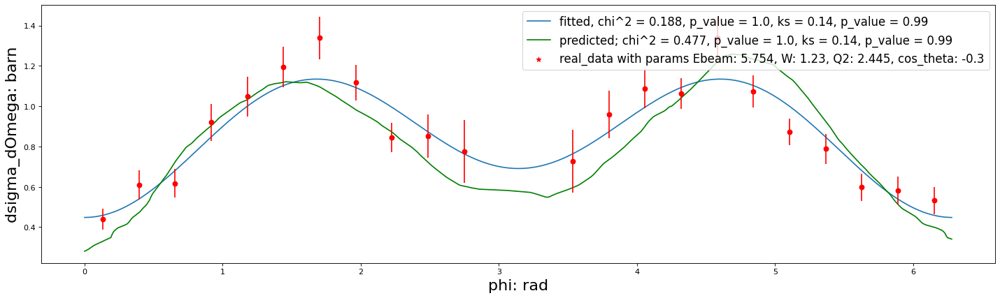

0 5.754 1.23 2.445 -0.2
a = 0.922544038009012 , b = -0.3364503414906803, c = -0.0155964208570476


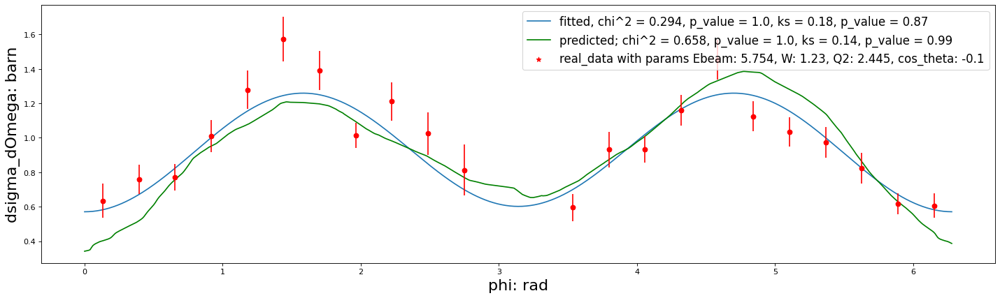

a = 0.9259850406436464 , b = -0.3956995373725586, c = 0.12698738308734406


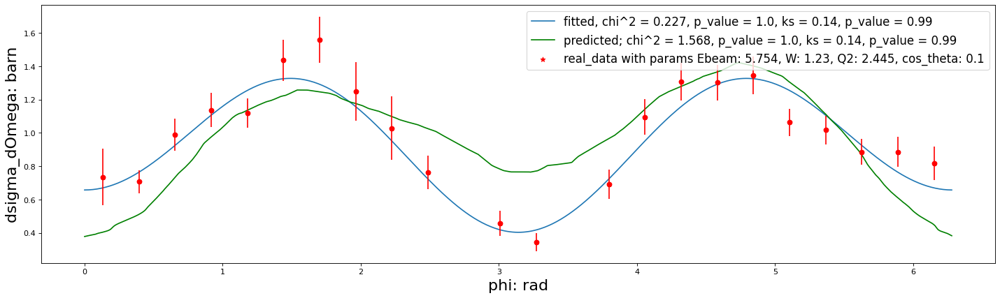

0 5.754 1.23 2.445 0.2
a = 0.9742328057787504 , b = -0.3845954386853091, c = 0.21326630628319462


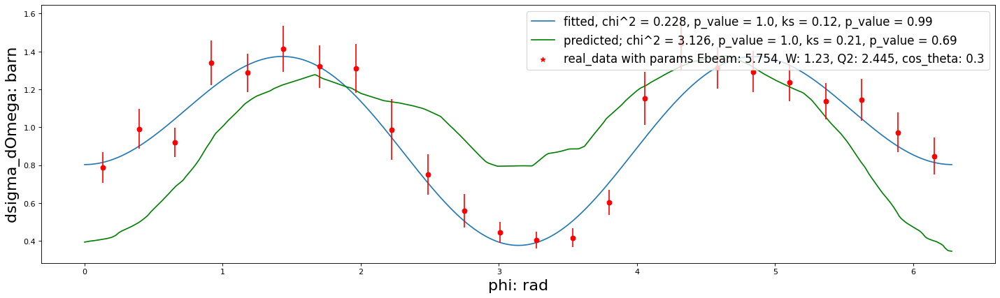

0 5.754 1.23 2.445 0.4
a = 0.8837167456113829 , b = -0.28013451930261035, c = 0.20533867450366594


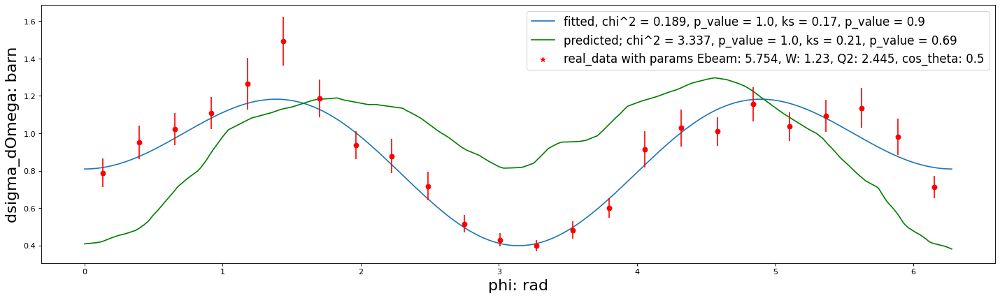

0 5.754 1.23 2.445 0.6
a = 0.9034215904356934 , b = -0.248438223919989, c = 0.197951021669499


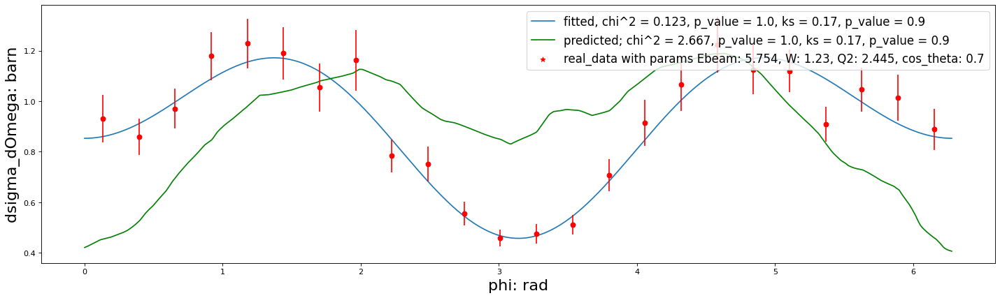

0 5.754 1.23 2.445 0.8
a = 0.8670888008527259 , b = -0.11373034198658465, c = 0.15795830347648934


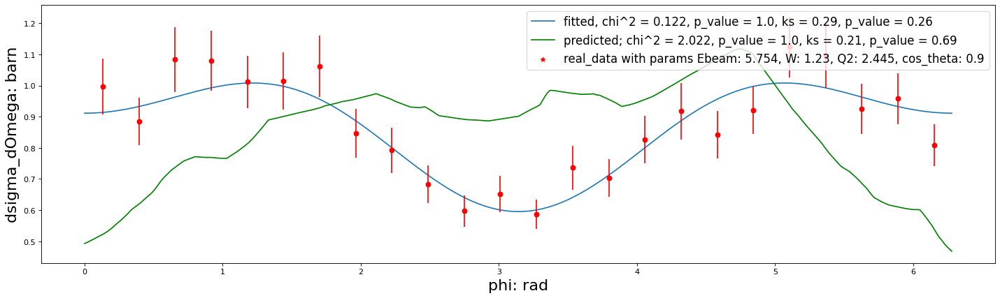


 25%|██▌       | 1/4 [00:07<00:22,  7.37s/it]

a = 0.3815620139936669 , b = -0.103786950670299, c = 0.012944670625828601


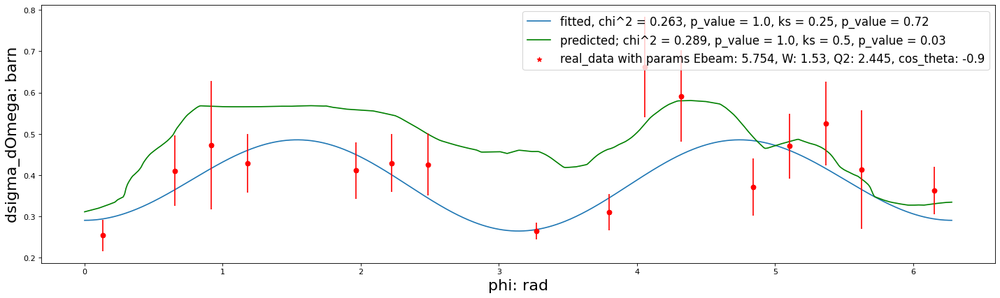

0 5.754 1.53 2.445 -0.8
a = 0.7400013995079272 , b = -0.15660692080677358, c = 0.016198641257035382


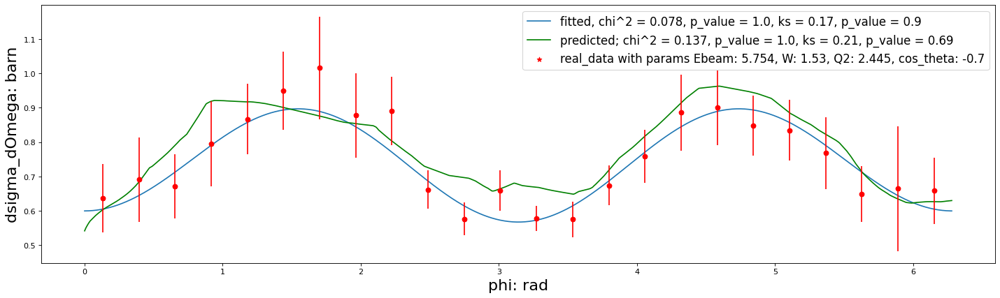

0 5.754 1.53 2.445 -0.6
a = 1.0463923906301056 , b = -0.12060539503353036, c = -0.1425895785281594


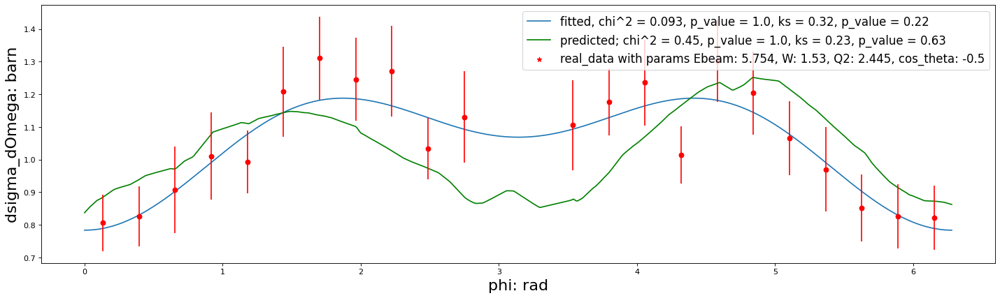

0 5.754 1.53 2.445 -0.4
a = 1.1565198039192024 , b = -0.13033937827034758, c = -0.12149941489677174


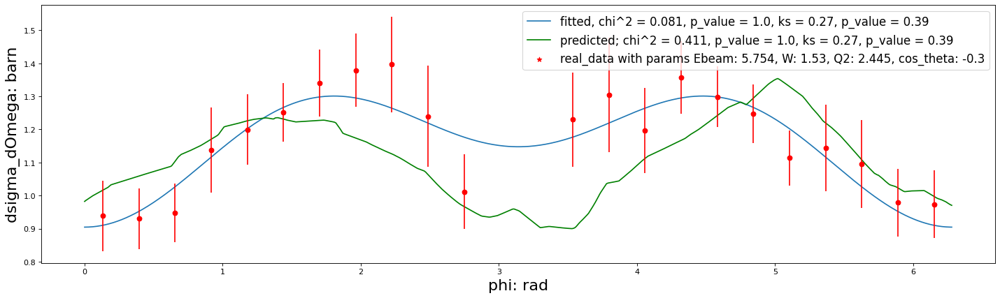

0 5.754 1.53 2.445 -0.2
a = 1.1665717907340407 , b = -0.10922847853077516, c = -0.08164315582470832


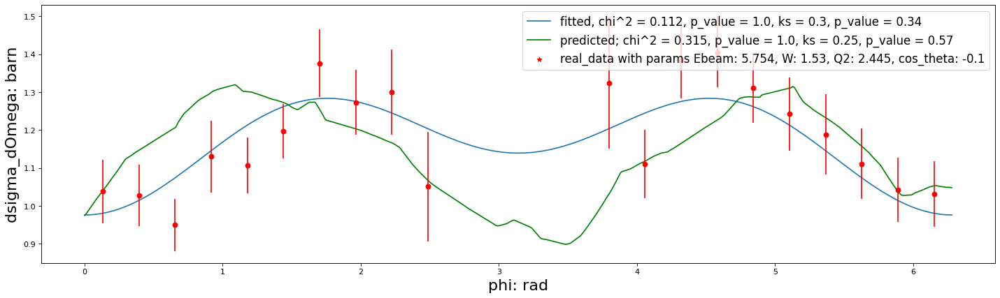

a = 1.0563366816721427 , b = -0.15435796142760827, c = 0.03734848421099901


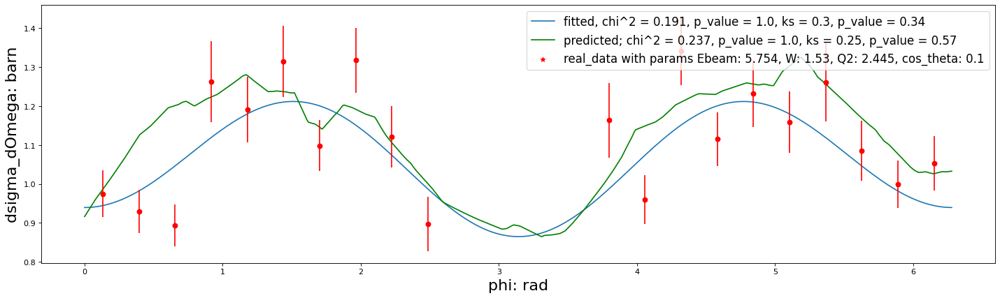

0 5.754 1.53 2.445 0.2
a = 1.0433854466719723 , b = -0.09180647215064203, c = -0.0842637471078404


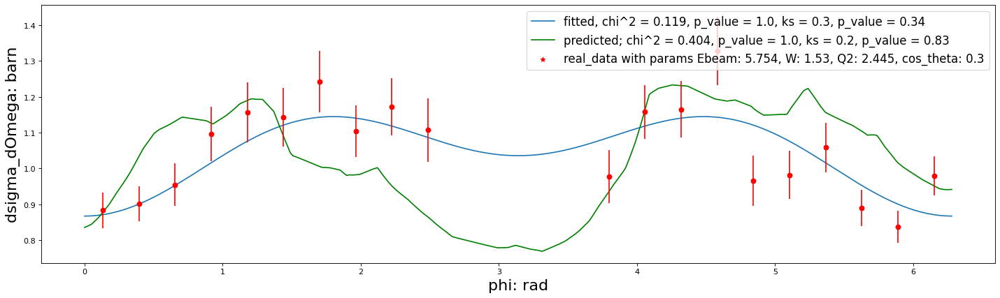

0 5.754 1.53 2.445 0.4
a = 0.8416342694130176 , b = -0.1579636755183215, c = -0.01804743434372474


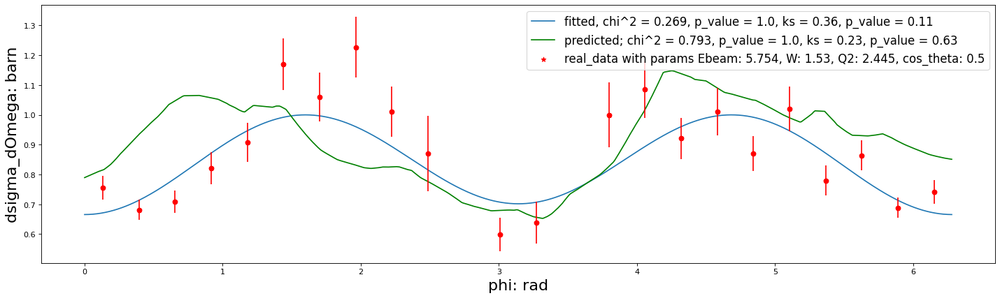

0 5.754 1.53 2.445 0.6
a = 0.7806382200924654 , b = -0.0782049670876651, c = -0.09285392111548997


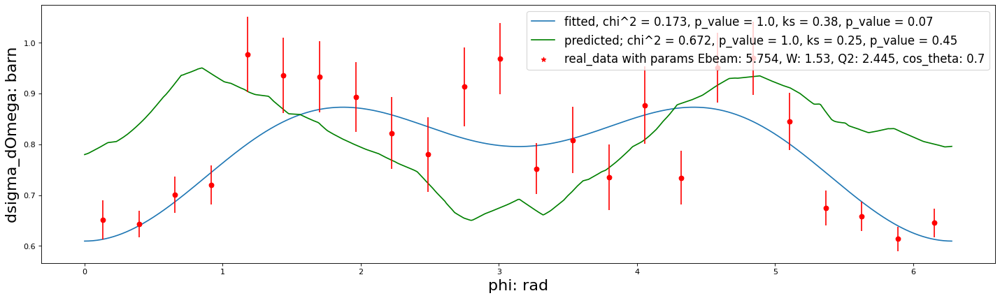

0 5.754 1.53 2.445 0.8
a = 0.6969203811199205 , b = 0.006779287903218083, c = -0.01727200797907026


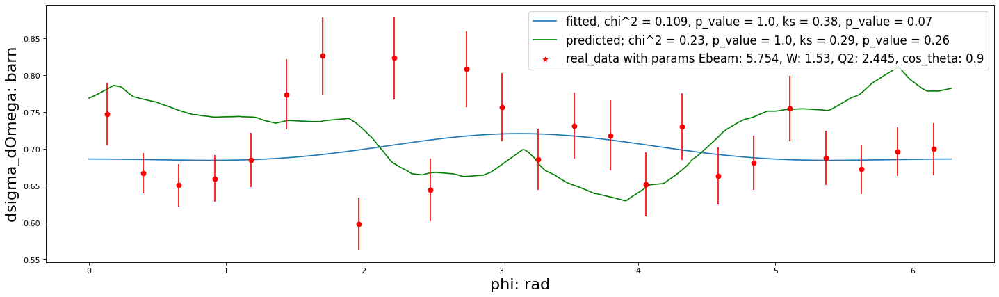


 50%|█████     | 2/4 [00:15<00:15,  7.96s/it]

a = 0.23097293550881048 , b = 0.0011194250952379914, c = 0.012325544013124579


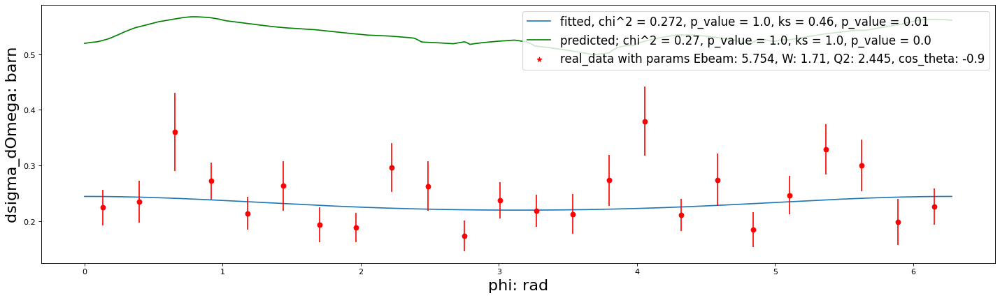

0 5.754 1.71 2.445 -0.8
a = 0.20616227438728088 , b = 0.01449475508651581, c = -0.015138000173047941


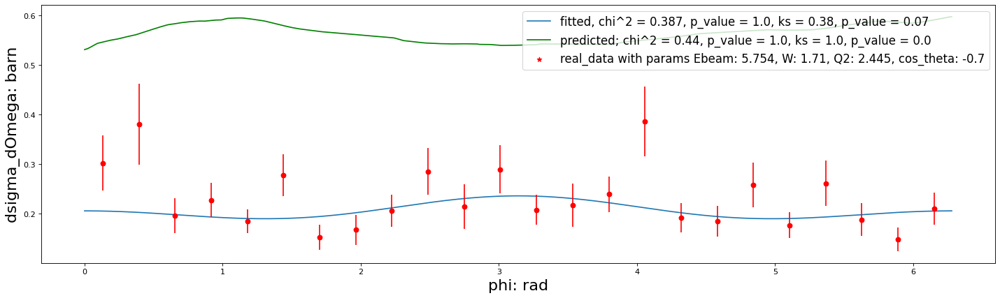

0 5.754 1.71 2.445 -0.6
a = 0.2520878617030855 , b = 0.0020844299297785307, c = 0.010306512433605364


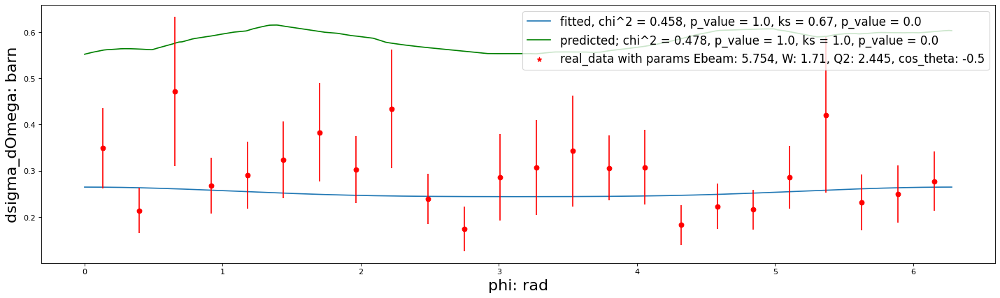

0 5.754 1.71 2.445 -0.4
a = 0.2922956245882861 , b = -0.03294322697844513, c = 0.025170123121401967


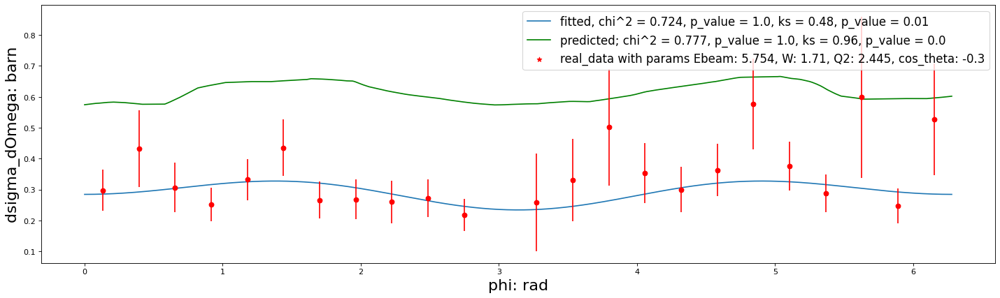

0 5.754 1.71 2.445 -0.2
a = 0.3380073629834838 , b = -0.06404898407971413, c = 0.03188631350463897


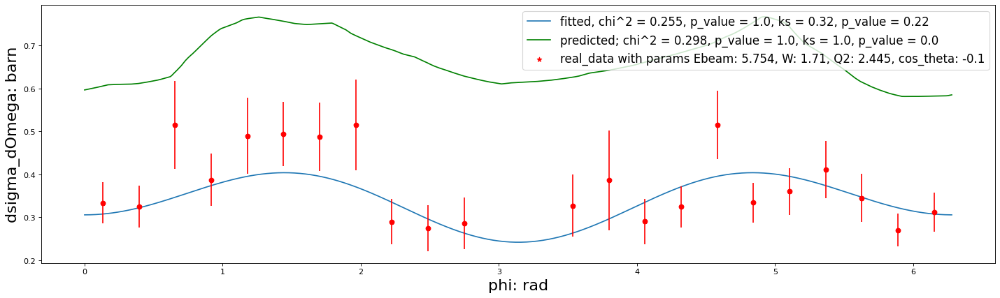

a = 0.38478509603729844 , b = -0.1319937104686393, c = 0.05192730123733436


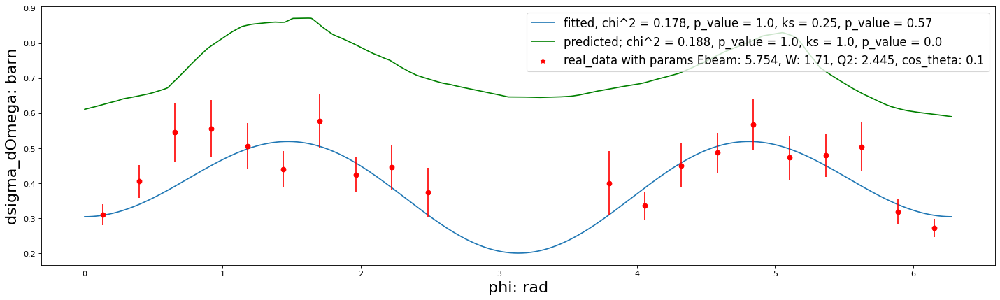

0 5.754 1.71 2.445 0.2
a = 0.3584479022167154 , b = -0.10650615612218095, c = 9.100496548197778e-05


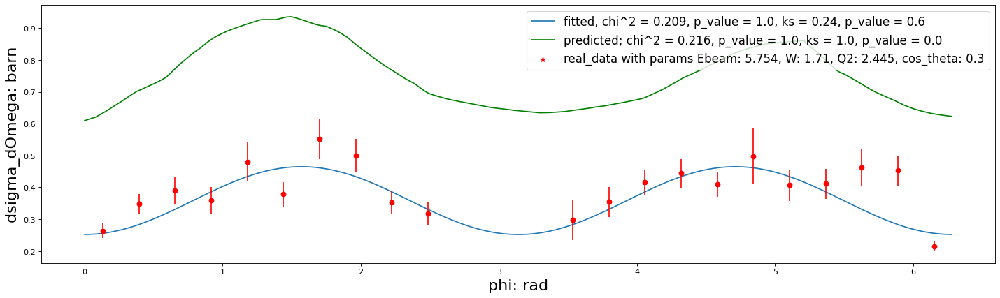

0 5.754 1.71 2.445 0.4
a = 0.3600250477414253 , b = -0.11871739429659849, c = 0.006810971966697908


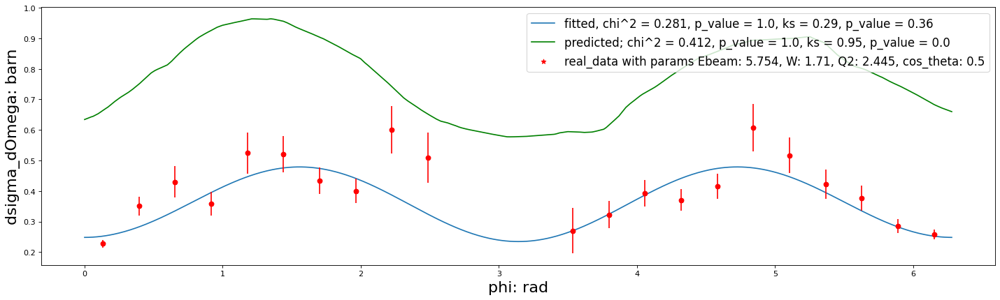

0 5.754 1.71 2.445 0.6
a = 0.3873489869611689 , b = -0.11797119636603988, c = 0.05133305494454049


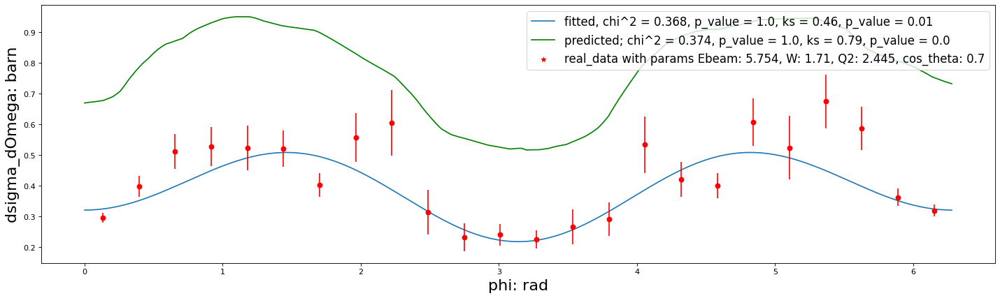

0 5.754 1.71 2.445 0.8
a = 0.4670707795791838 , b = -0.013456391839524181, c = 0.029119232602613947


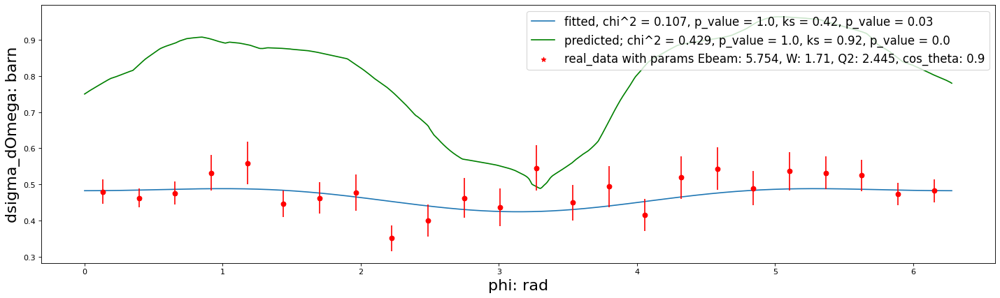


 64%|██████▎   | 7/11 [01:31<01:02, 15.72s/it]

0 5.754 1.95 2.445 -0.9
0 5.754 1.95 2.445 -0.8
0 5.754 1.95 2.445 -0.7
0 5.754 1.95 2.445 -0.6
0 5.754 1.95 2.445 -0.5
0 5.754 1.95 2.445 -0.4
0 5.754 1.95 2.445 -0.3
0 5.754 1.95 2.445 -0.2
0 5.754 1.95 2.445 -0.1
0 5.754 1.95 2.445 0.1
0 5.754 1.95 2.445 0.2
0 5.754 1.95 2.445 0.3
0 5.754 1.95 2.445 0.4
0 5.754 1.95 2.445 0.5
0 5.754 1.95 2.445 0.6
0 5.754 1.95 2.445 0.7
0 5.754 1.95 2.445 0.8
0 5.754 1.95 2.445 0.9



  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 2.91 -0.9
0 5.754 1.23 2.91 -0.8
a = 0.4606902331349334 , b = -0.0973938729905783, c = 0.23741124645972556


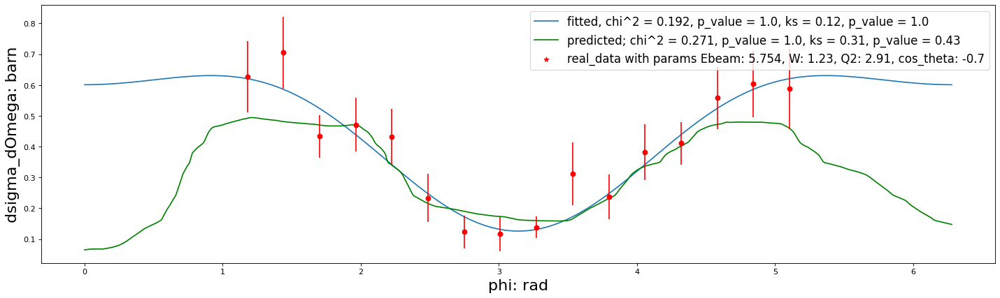

0 5.754 1.23 2.91 -0.6
a = 0.398908555921341 , b = -0.18323234845215128, c = -0.018058468802534536


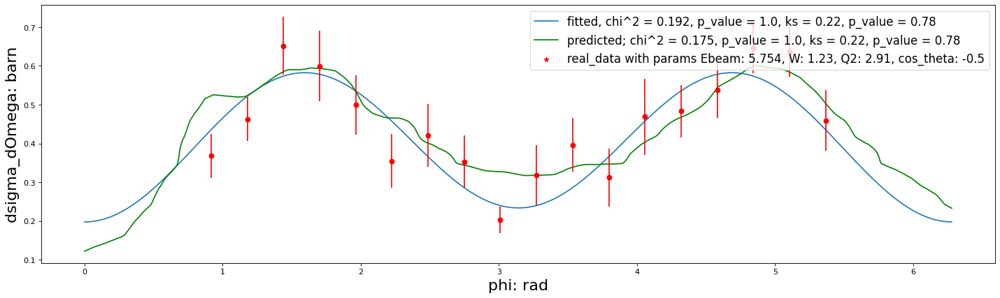

0 5.754 1.23 2.91 -0.4
a = 0.6129045524174538 , b = -0.13680678819341321, c = 0.14489682316070956


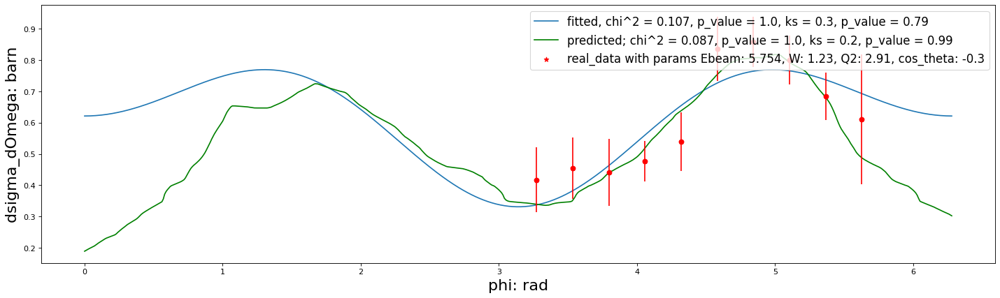

0 5.754 1.23 2.91 -0.2
a = 0.6540429141970302 , b = -0.20795126231912578, c = 0.02217482957036392


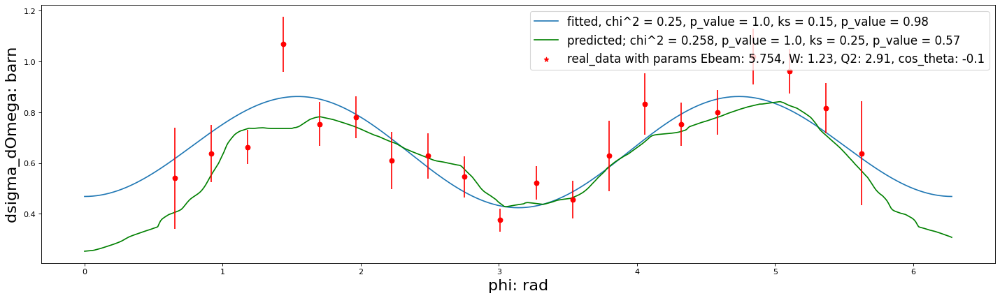

a = 0.5898541174788593 , b = -0.18059706745595183, c = -0.04870504180179114


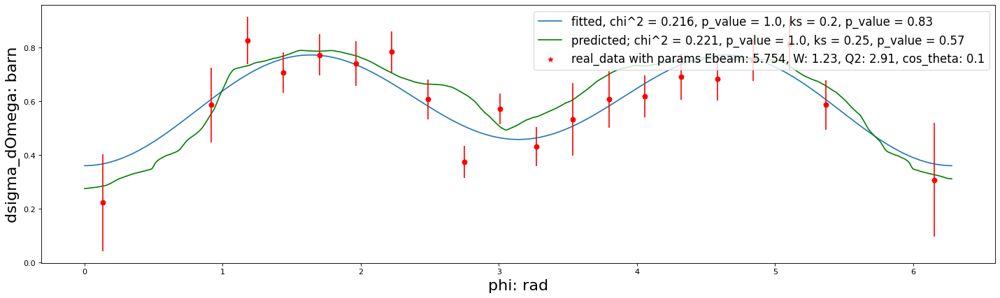

0 5.754 1.23 2.91 0.2
a = 0.5372880261668892 , b = -0.14212620125051525, c = -0.17869274608856797


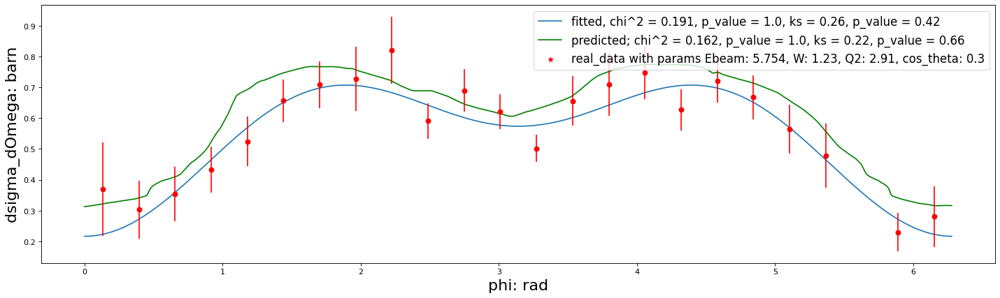

0 5.754 1.23 2.91 0.4
a = 0.5997596951661354 , b = -0.14279536646355964, c = -0.16126744627212908


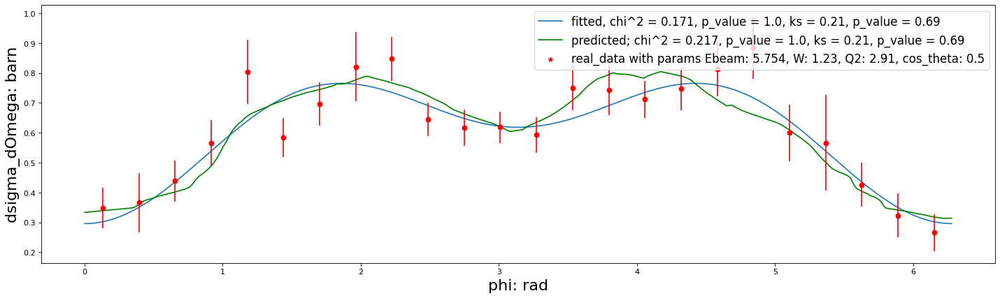

0 5.754 1.23 2.91 0.6
a = 0.6123340556774558 , b = -0.14084958430046515, c = -0.14194632623224765


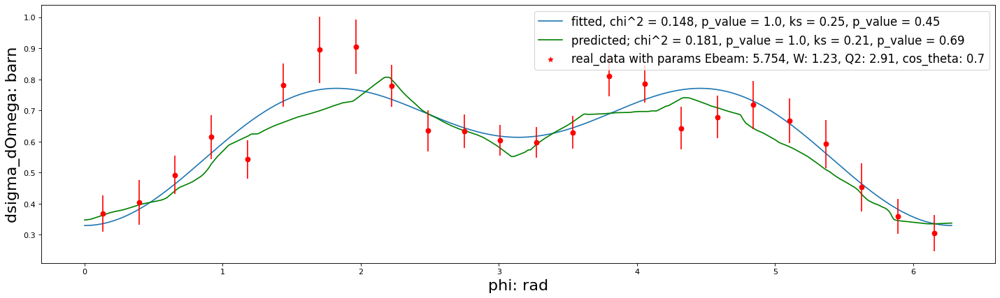

0 5.754 1.23 2.91 0.8
a = 0.5717051805238679 , b = -0.07184991668443445, c = -0.10499753851830188


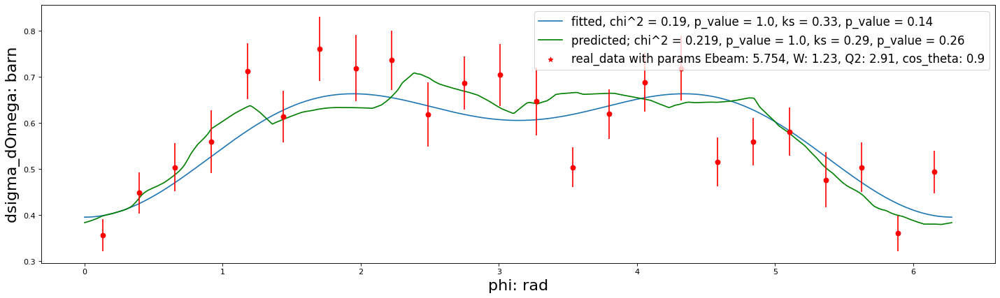


 73%|███████▎  | 8/11 [01:40<00:40, 13.66s/it]

0 5.754 1.53 2.91 -0.9
0 5.754 1.53 2.91 -0.8
0 5.754 1.53 2.91 -0.7
0 5.754 1.53 2.91 -0.6
0 5.754 1.53 2.91 -0.5
0 5.754 1.53 2.91 -0.4
0 5.754 1.53 2.91 -0.3
0 5.754 1.53 2.91 -0.2
0 5.754 1.53 2.91 -0.1
0 5.754 1.53 2.91 0.1
0 5.754 1.53 2.91 0.2
0 5.754 1.53 2.91 0.3
0 5.754 1.53 2.91 0.4
0 5.754 1.53 2.91 0.5
0 5.754 1.53 2.91 0.6
0 5.754 1.53 2.91 0.7
0 5.754 1.53 2.91 0.8
0 5.754 1.53 2.91 0.9
0 5.754 1.71 2.91 -0.9
0 5.754 1.71 2.91 -0.8
0 5.754 1.71 2.91 -0.7
0 5.754 1.71 2.91 -0.6
0 5.754 1.71 2.91 -0.5
0 5.754 1.71 2.91 -0.4
0 5.754 1.71 2.91 -0.3
0 5.754 1.71 2.91 -0.2
0 5.754 1.71 2.91 -0.1
0 5.754 1.71 2.91 0.1
0 5.754 1.71 2.91 0.2
0 5.754 1.71 2.91 0.3
0 5.754 1.71 2.91 0.4
0 5.754 1.71 2.91 0.5
0 5.754 1.71 2.91 0.6
0 5.754 1.71 2.91 0.7
0 5.754 1.71 2.91 0.8
0 5.754 1.71 2.91 0.9
0 5.754 1.95 2.91 -0.9
0 5.754 1.95 2.91 -0.8
0 5.754 1.95 2.91 -0.7
0 5.754 1.95 2.91 -0.6
0 5.754 1.95 2.91 -0.5
0 5.754 1.95 2.91 -0.4
0 5.754 1.95 2.91 -0.3
0 5.754 1.95 2.91 -0.2
0 5.75


  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 2.915 -0.9
0 5.754 1.23 2.915 -0.8
a = 0.45231890823602006 , b = -0.09537541548861267, c = -0.24401985225352668


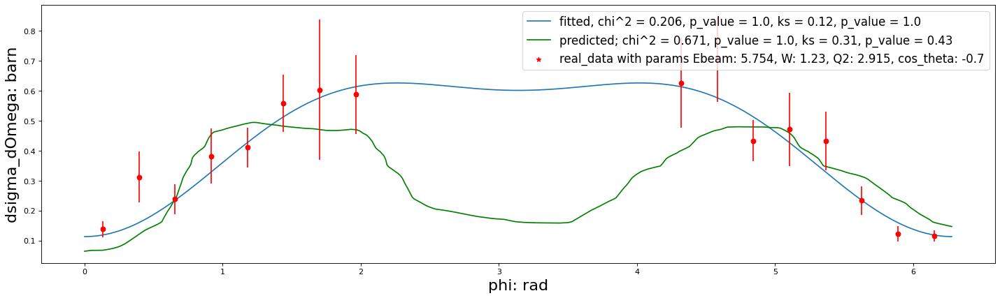

0 5.754 1.23 2.915 -0.6
a = 0.383278869038375 , b = -0.17777644117646596, c = 0.022578050131814523


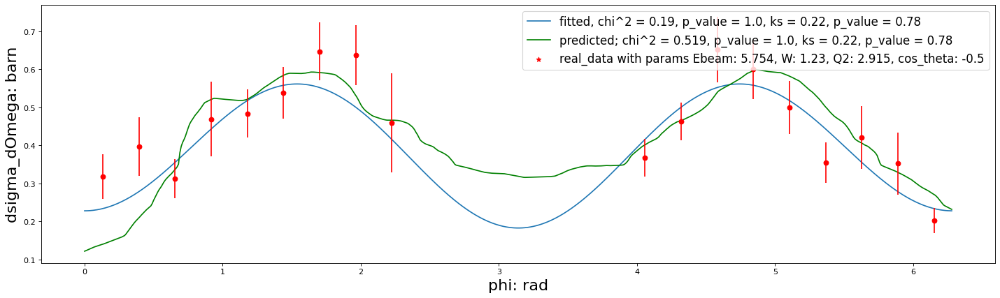

0 5.754 1.23 2.915 -0.4
a = 0.6168673530759508 , b = -0.12194802350916766, c = -0.172973091107649


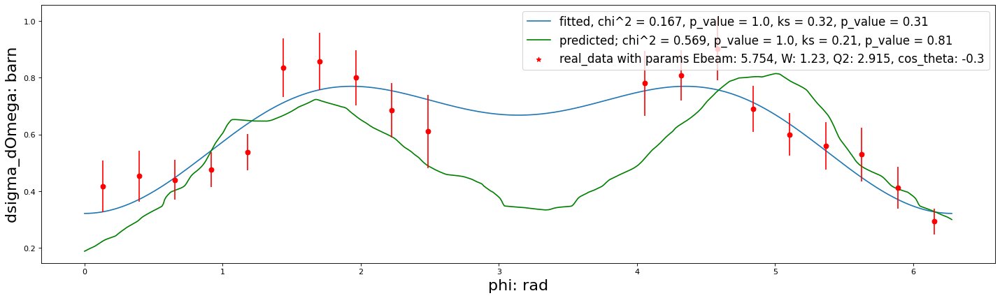

0 5.754 1.23 2.915 -0.2
a = 0.6288835766377294 , b = -0.21638441342464998, c = 0.00046564938917759147


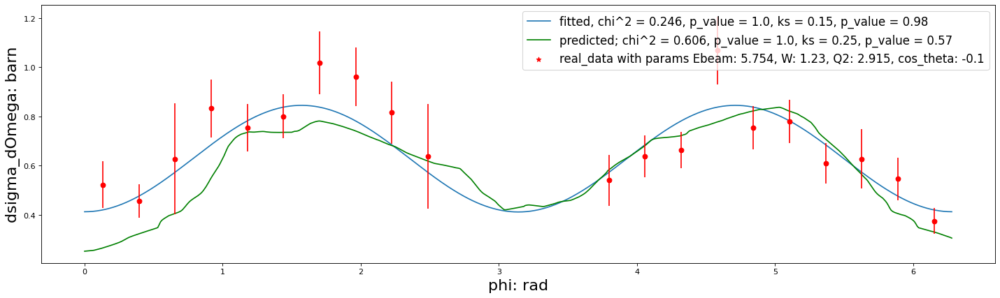

a = 0.5435307257671561 , b = -0.20488448879091675, c = 0.06642921546574249


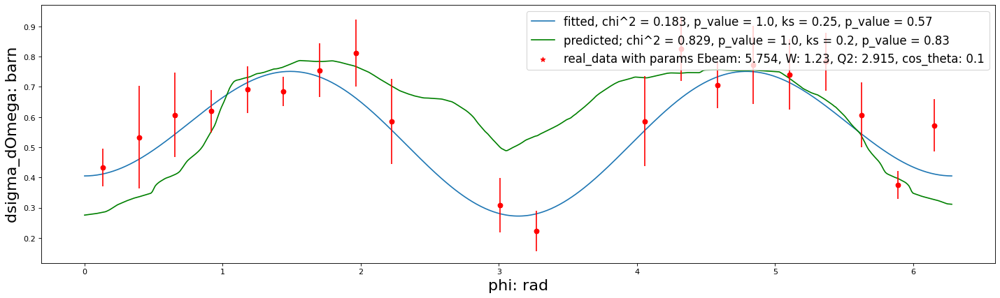

0 5.754 1.23 2.915 0.2
a = 0.5417131867657337 , b = -0.12867419184763415, c = 0.1738860279929927


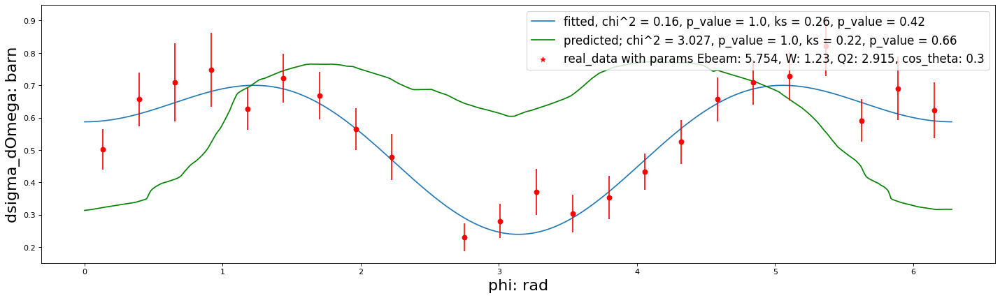

0 5.754 1.23 2.915 0.4
a = 0.5900016387601528 , b = -0.1348845725908465, c = 0.16679791806448868


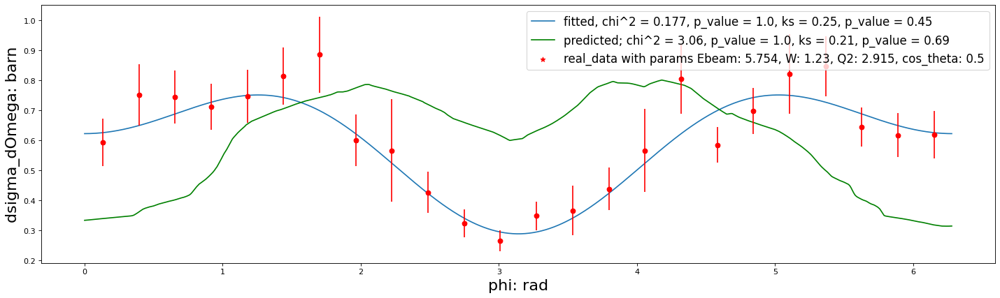

0 5.754 1.23 2.915 0.6
a = 0.6002773837208756 , b = -0.1335447071119472, c = 0.14429831778930705


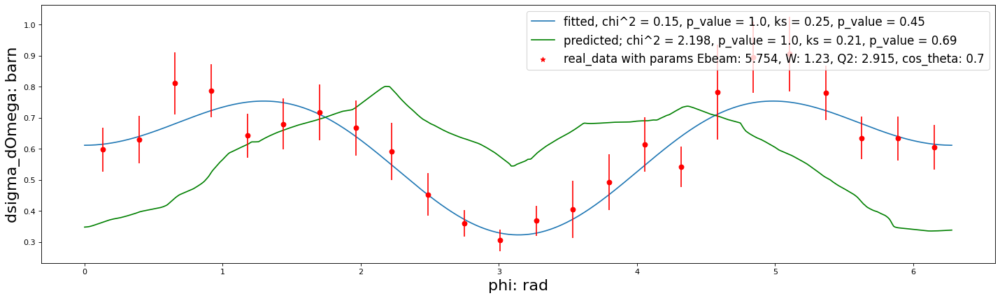

0 5.754 1.23 2.915 0.8
a = 0.5593265251791143 , b = -0.06521422768518832, c = 0.10556330381865665


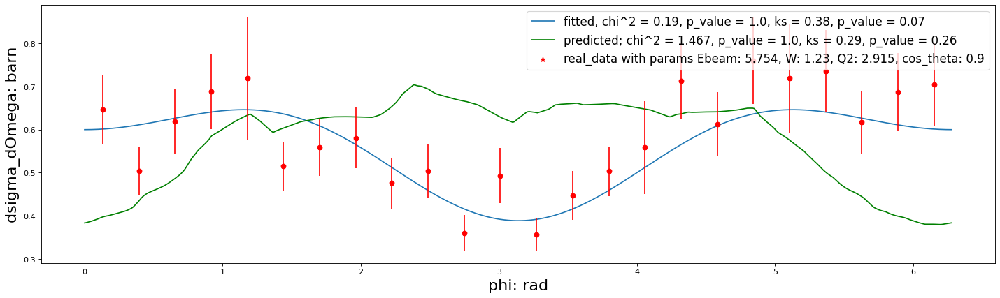


 25%|██▌       | 1/4 [00:08<00:24,  8.15s/it]

a = 0.2791477951072518 , b = -0.07570586676110146, c = 0.056912131229483916


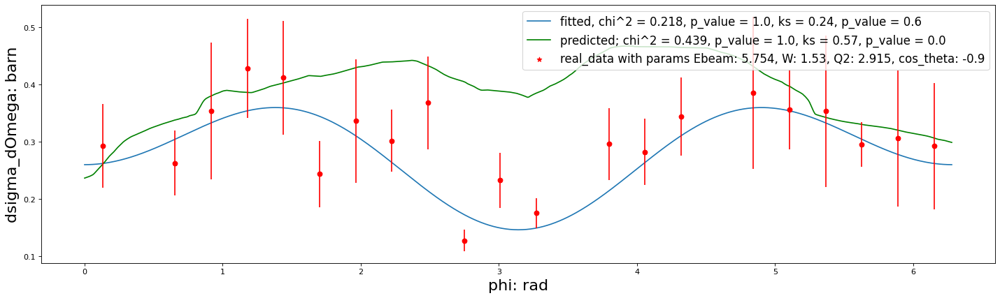

0 5.754 1.53 2.915 -0.8
a = 0.50573229580984 , b = -0.10963956049487802, c = 0.061585242031065385


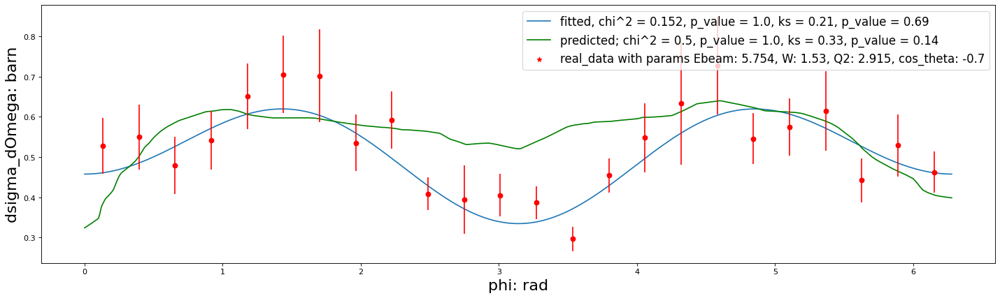

0 5.754 1.53 2.915 -0.6
a = 0.6933300052768945 , b = -0.10299913433535643, c = 0.05442733222254081


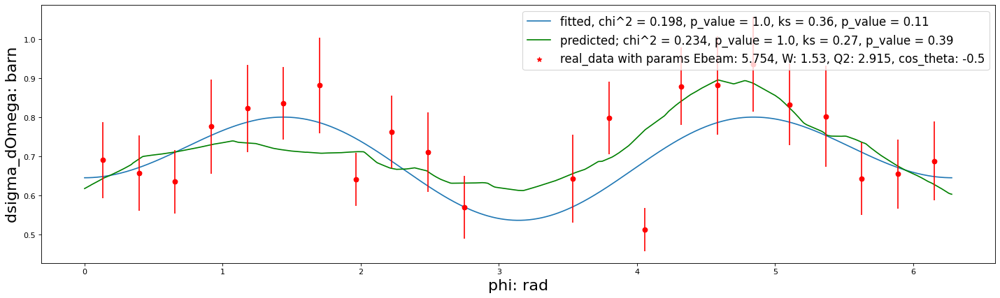

0 5.754 1.53 2.915 -0.4
a = 0.8295832766706576 , b = -0.08626968100018893, c = -0.017139084814734973


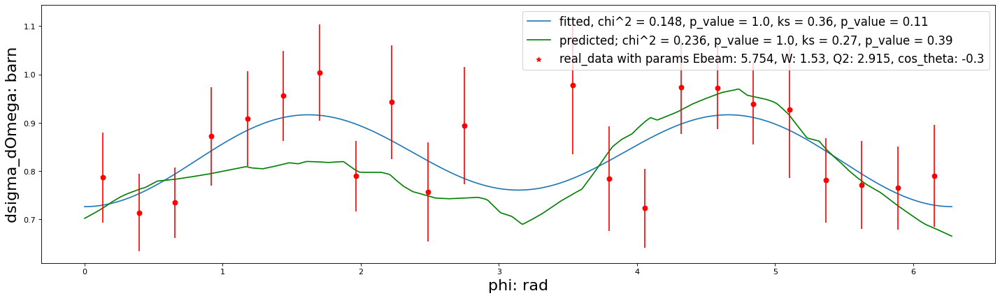

0 5.754 1.53 2.915 -0.2
a = 0.8451109077168338 , b = -0.032547694627174446, c = -0.06942488810909161


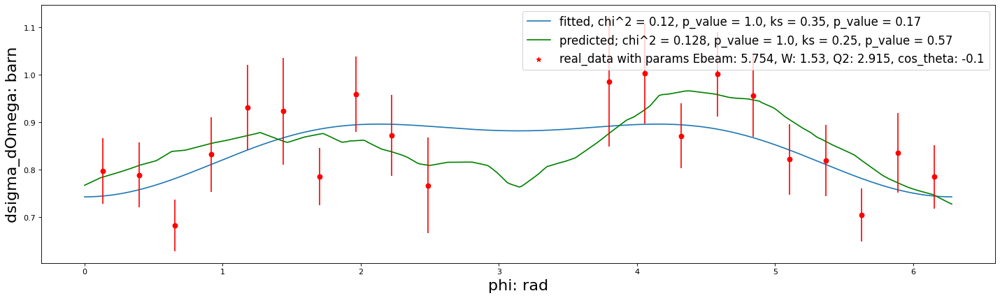

a = 0.8442657829462158 , b = -0.0298286929781547, c = -0.06915677588743564


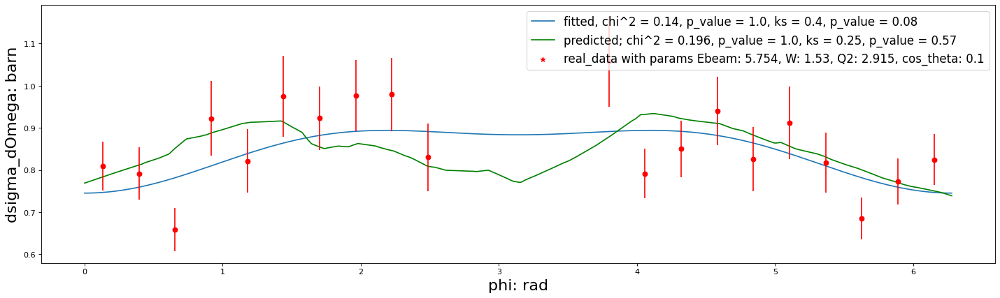

0 5.754 1.53 2.915 0.2
a = 0.7658793236924251 , b = 0.041214292573460855, c = -0.10057797572106131


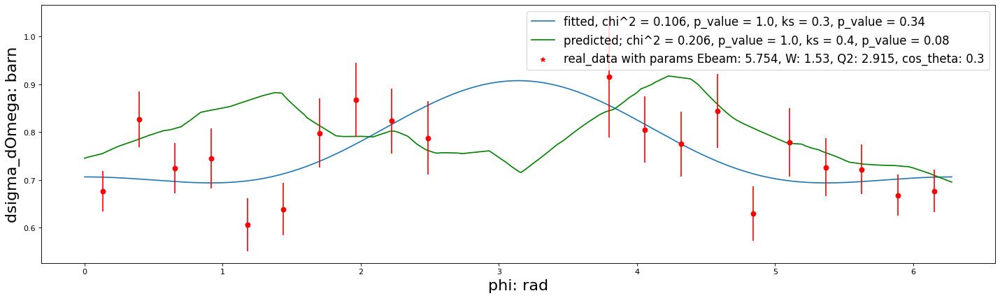

0 5.754 1.53 2.915 0.4
a = 0.6120041598769019 , b = -0.03260719359373572, c = -0.07894395040415528


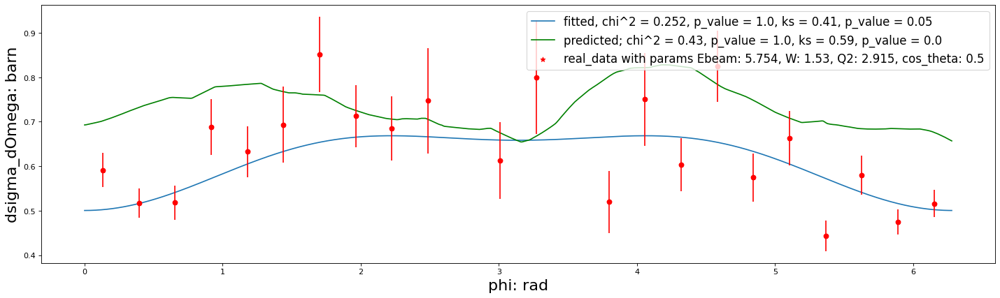

0 5.754 1.53 2.915 0.6
5.754 1.53 2.915 0.7
0 5.754 1.53 2.915 0.8
a = 0.4678307642805801 , b = -0.000441706456212998, c = -0.032265215061881625


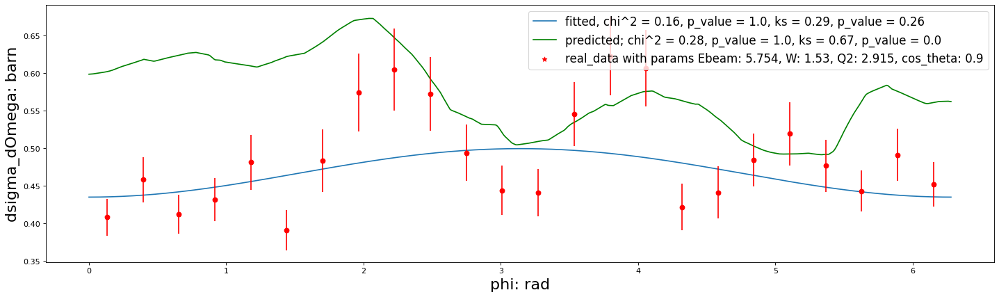


 50%|█████     | 2/4 [00:15<00:15,  7.80s/it]

a = 0.15236120157624042 , b = 0.032844265224436044, c = 0.015720065658895836


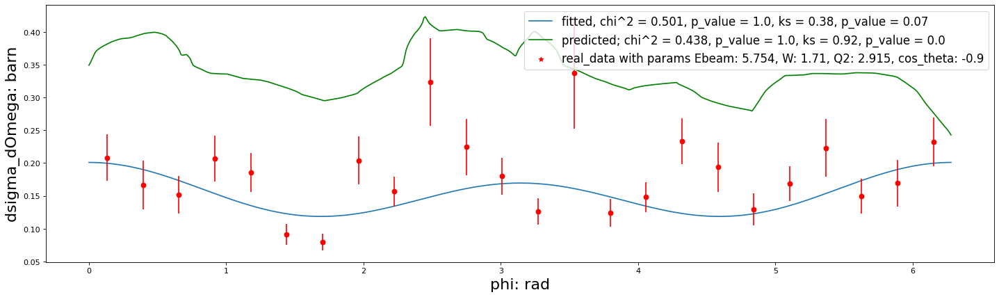

0 5.754 1.71 2.915 -0.8
a = 0.15171152588227552 , b = -0.005782271672189473, c = 0.0055155612822974254


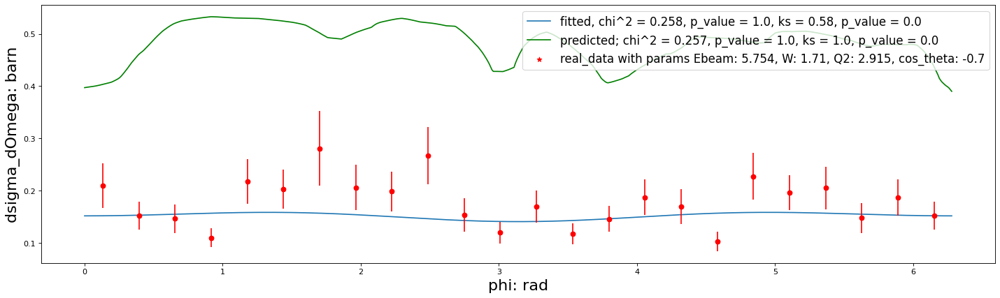

0 5.754 1.71 2.915 -0.6
a = 0.152025940164812 , b = -0.02728906062174648, c = 0.015291748181619842


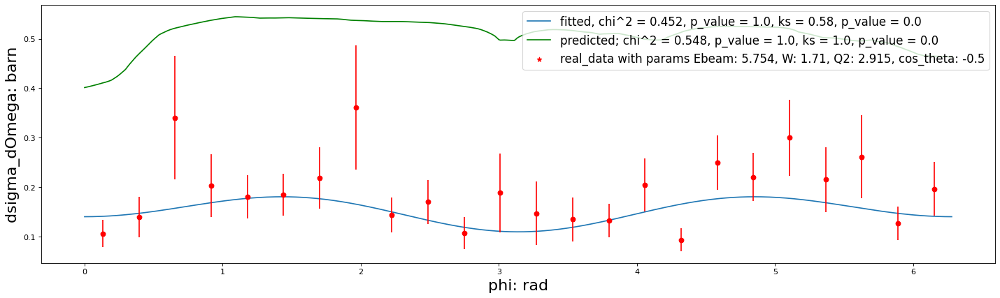

0 5.754 1.71 2.915 -0.4
a = 0.1839147962657205 , b = -0.027283414266187665, c = 0.05407529915345854


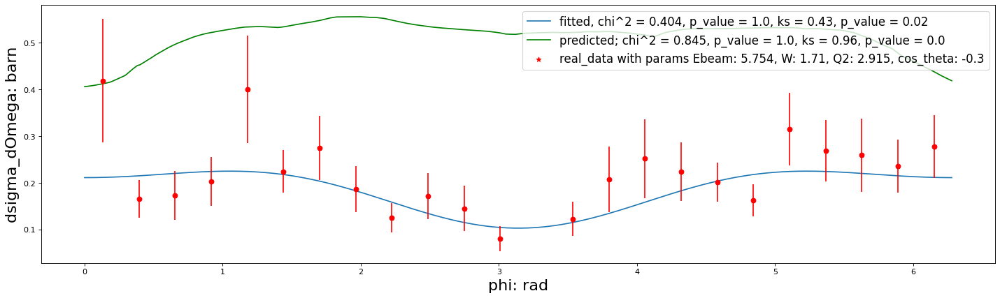

0 5.754 1.71 2.915 -0.2
a = 0.2443161681772154 , b = -0.061928541194768545, c = 0.057444348440378525


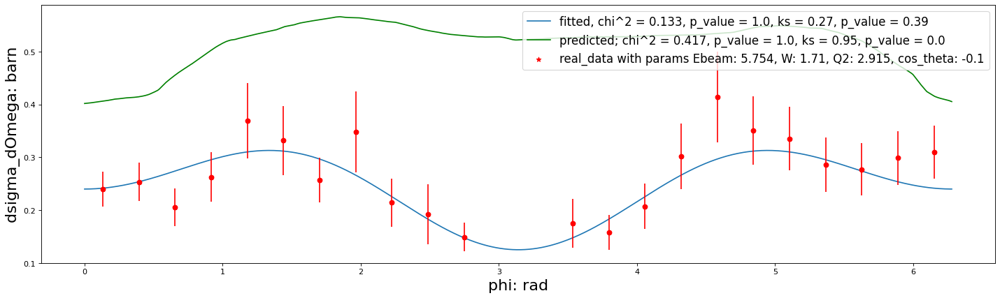

a = 0.22460036426034383 , b = -0.04800204091189727, c = 0.03725728331397495


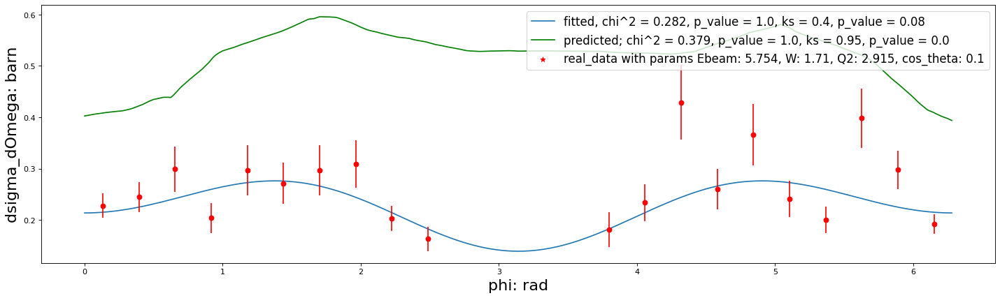

0 5.754 1.71 2.915 0.2
a = 0.26091958257266523 , b = -0.06859407735912809, c = -0.024345329619063726


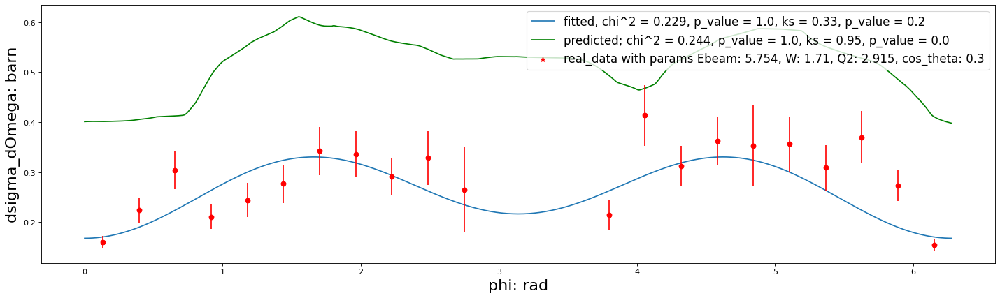

0 5.754 1.71 2.915 0.4
a = 0.26634785839859715 , b = -0.09112477711894902, c = -0.0200248533585282


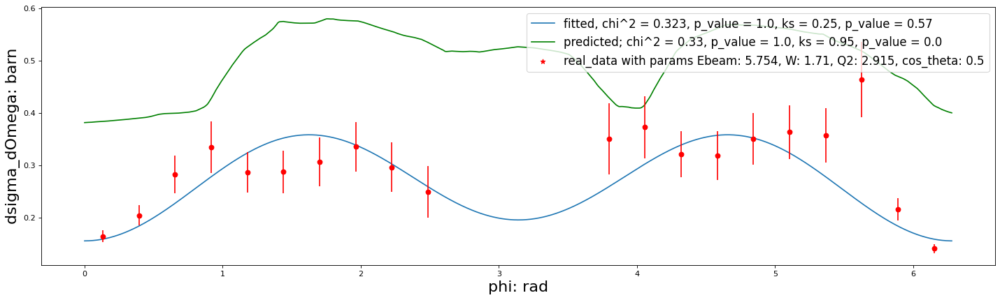

0 5.754 1.71 2.915 0.6
a = 0.23745327906518549 , b = -0.0719500567367888, c = 0.042740199506805916


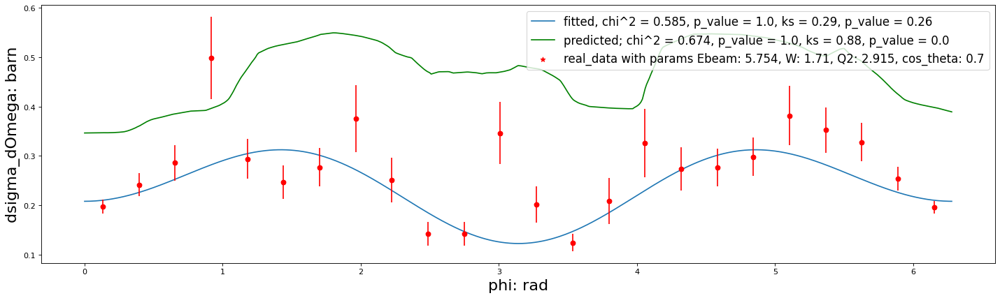

0 5.754 1.71 2.915 0.8
a = 0.28931237786799097 , b = -0.01020619851924808, c = -0.02149175928714503


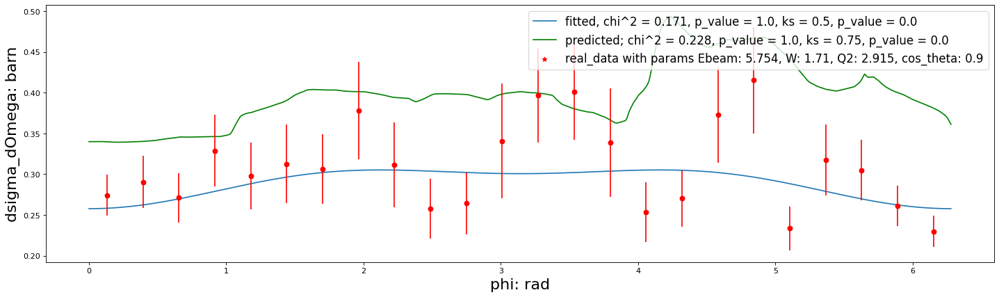


 82%|████████▏ | 9/11 [02:04<00:33, 16.83s/it]

0 5.754 1.95 2.915 -0.9
0 5.754 1.95 2.915 -0.8
0 5.754 1.95 2.915 -0.7
0 5.754 1.95 2.915 -0.6
0 5.754 1.95 2.915 -0.5
0 5.754 1.95 2.915 -0.4
0 5.754 1.95 2.915 -0.3
0 5.754 1.95 2.915 -0.2
0 5.754 1.95 2.915 -0.1
0 5.754 1.95 2.915 0.1
0 5.754 1.95 2.915 0.2
0 5.754 1.95 2.915 0.3
0 5.754 1.95 2.915 0.4
0 5.754 1.95 2.915 0.5
0 5.754 1.95 2.915 0.6
0 5.754 1.95 2.915 0.7
0 5.754 1.95 2.915 0.8
0 5.754 1.95 2.915 0.9



  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 3.48 -0.9
0 5.754 1.23 3.48 -0.8
a = 0.18188499896799876 , b = -0.02270064130298259, c = -0.05865233446837587


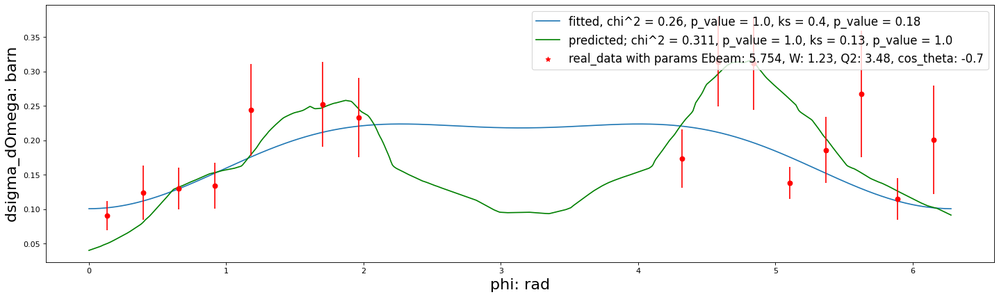

0 5.754 1.23 3.48 -0.6
a = 0.24746184749457287 , b = -0.044942761063822265, c = -0.08698725694999976


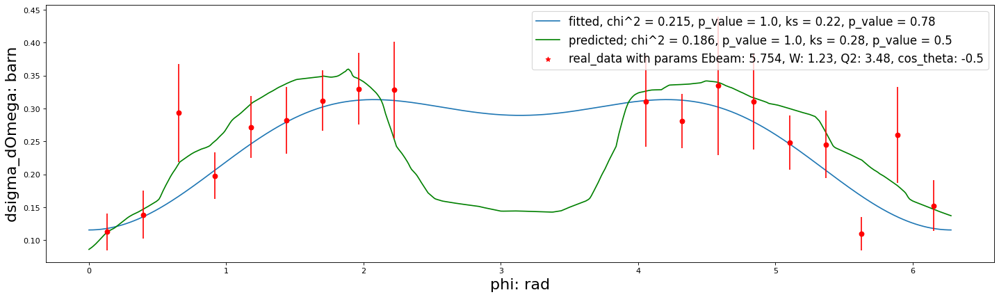

0 5.754 1.23 3.48 -0.4
a = 0.303194694555999 , b = -0.06686608873971202, c = -0.03719563598927185


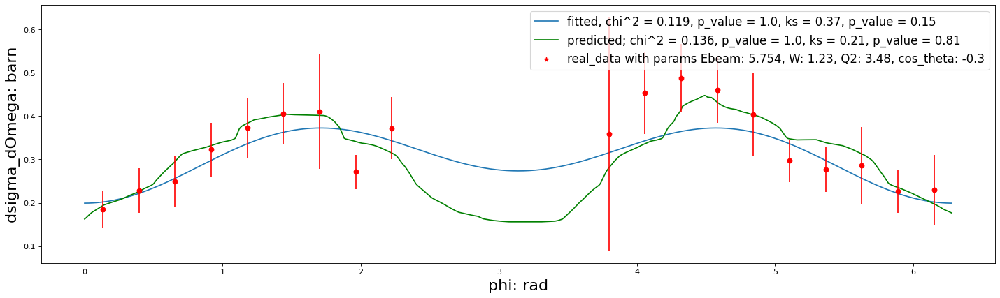

0 5.754 1.23 3.48 -0.2
a = 0.33162390911396483 , b = -0.18444278326051772, c = 0.09987760518812532


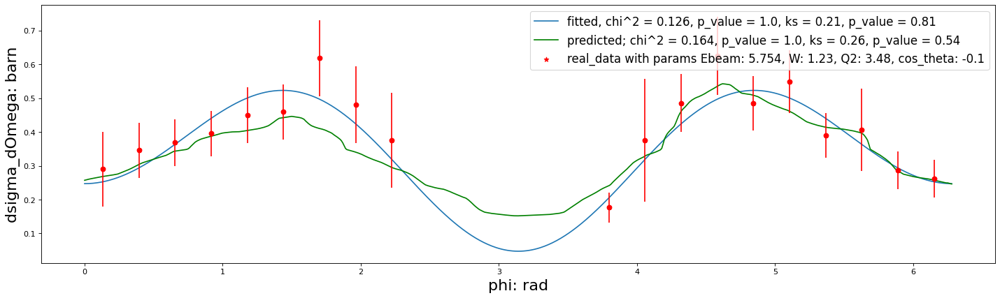

a = 0.33714861481320824 , b = -0.09769762146052975, c = 0.09161911771724883


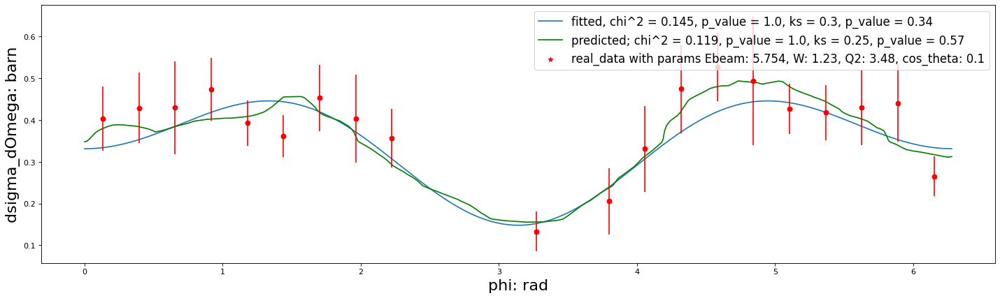

0 5.754 1.23 3.48 0.2
a = 0.3226800630332174 , b = -0.04610036789396412, c = 0.12809782152354587


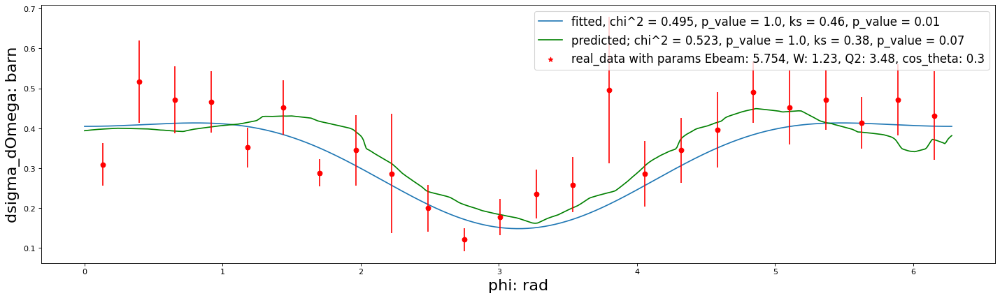

0 5.754 1.23 3.48 0.4
a = 0.3698859770451659 , b = -0.05997133830716889, c = 0.10555954587628695


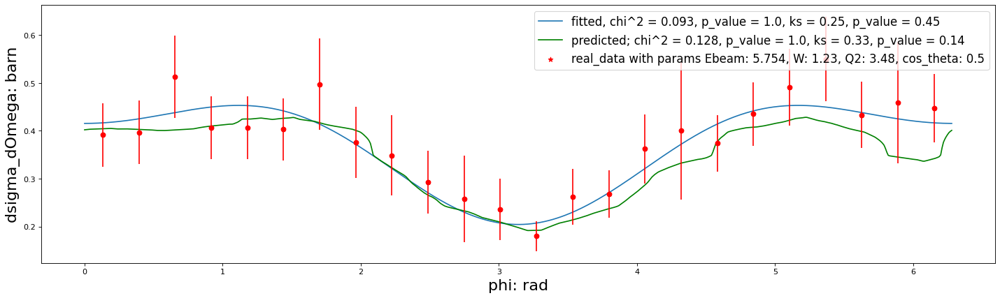

0 5.754 1.23 3.48 0.6
a = 0.3613217426179791 , b = -0.046309378295384306, c = 0.1251775844812071


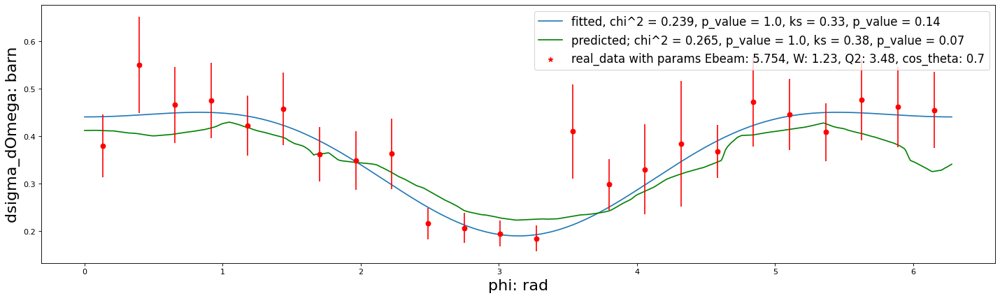

0 5.754 1.23 3.48 0.8
a = 0.3395943173864363 , b = -0.0005635678360986773, c = 0.07216817372625428


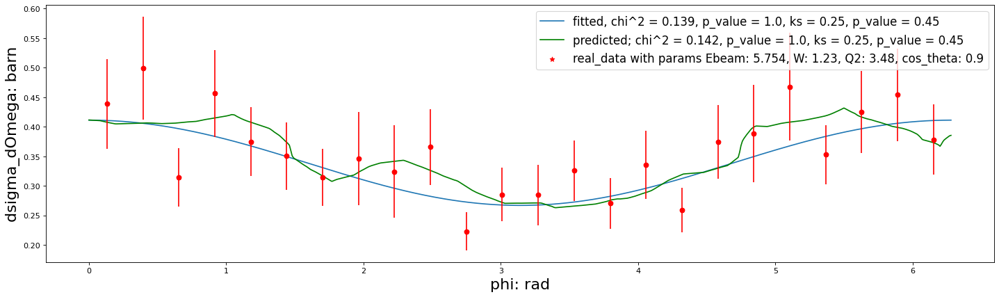


 25%|██▌       | 1/4 [00:07<00:21,  7.30s/it]

a = 0.17167607005769073 , b = 0.01282565614413628, c = 0.05201291100658111


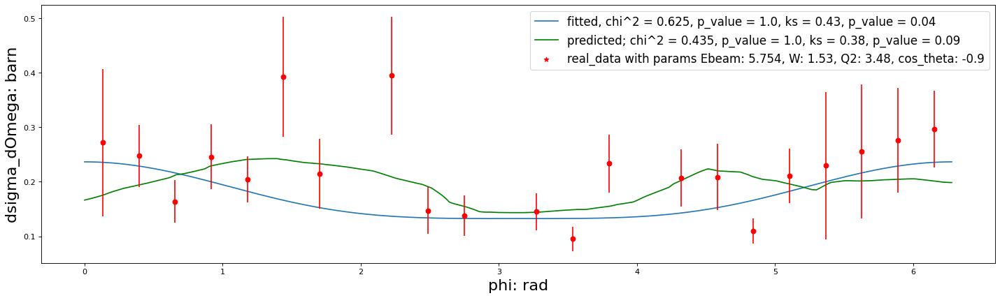

0 5.754 1.53 3.48 -0.8
a = 0.3609046233489375 , b = -0.08056465902608603, c = -0.005755351480346092


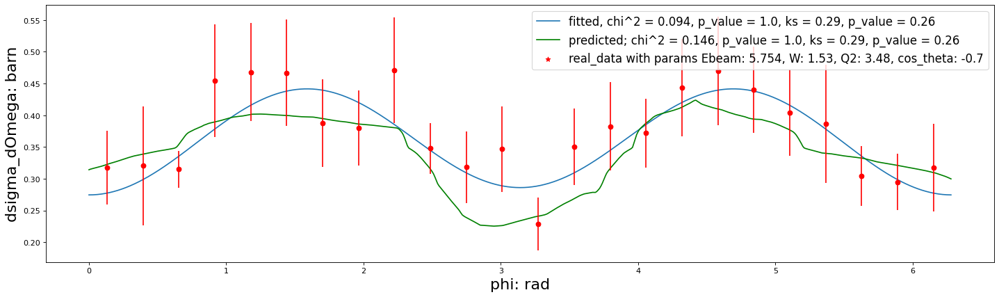

0 5.754 1.53 3.48 -0.6
a = 0.5253899197185978 , b = -0.03200162314775773, c = -0.023636640565038697


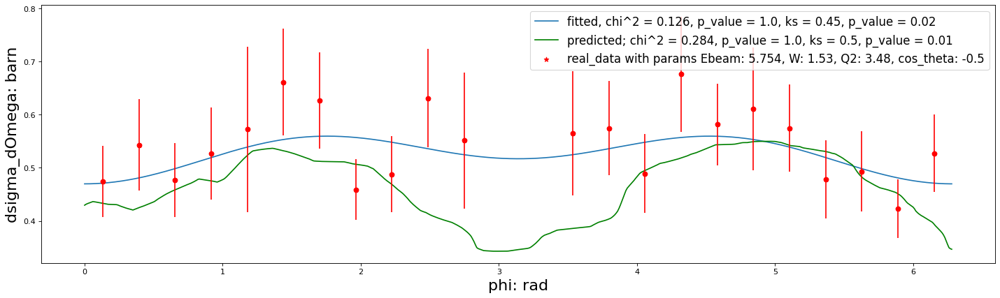

0 5.754 1.53 3.48 -0.4
a = 0.5209012460369152 , b = -0.12206326250944662, c = 0.07688887391850076


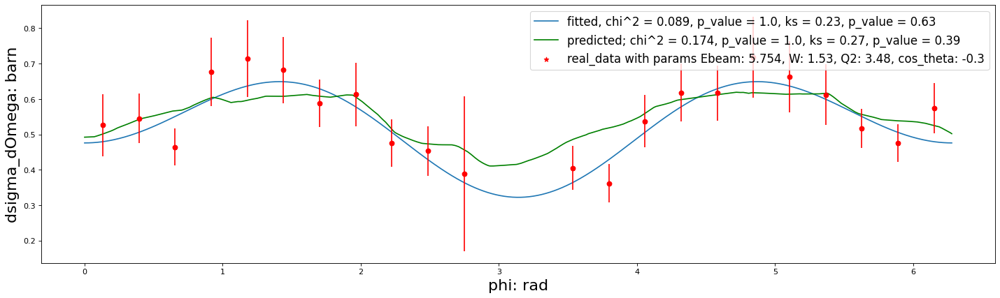

0 5.754 1.53 3.48 -0.2
a = 0.5471393745454896 , b = -0.04972990382911058, c = 0.013350329002503103


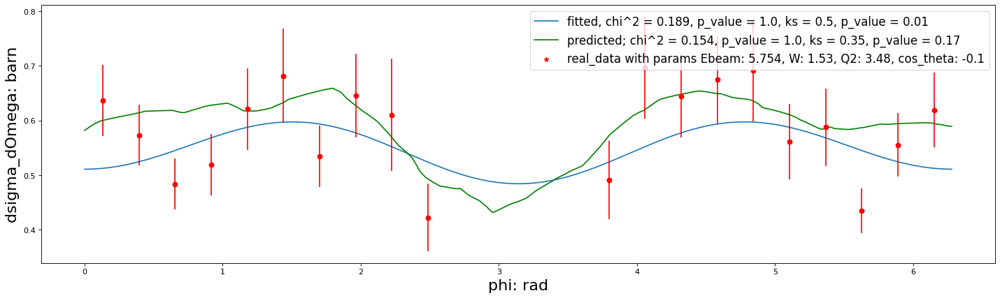

a = 0.4504824971607925 , b = -0.09520140737543599, c = 0.10531031225158423


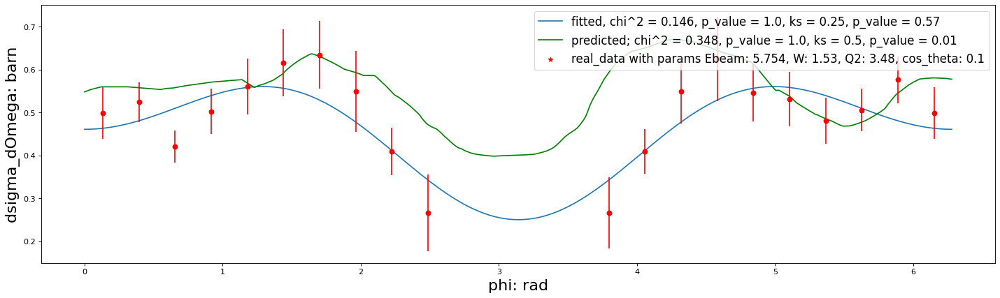

0 5.754 1.53 3.48 0.2
a = 0.4944895341769886 , b = -0.010604314088995759, c = -0.05108907013496844


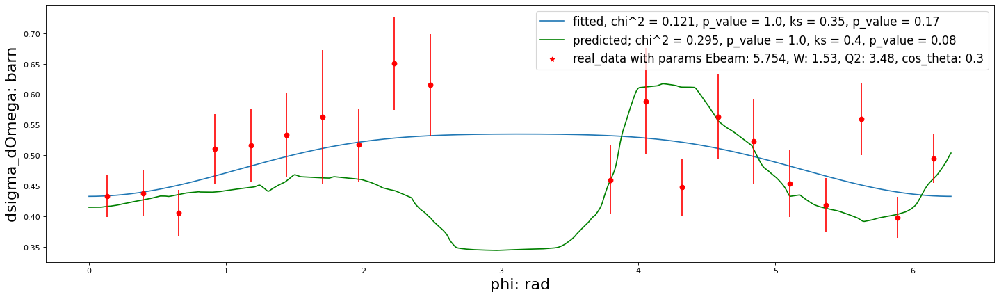

0 5.754 1.53 3.48 0.4
a = 0.32222065976754993 , b = -0.07114983110552285, c = 0.09092051337893339


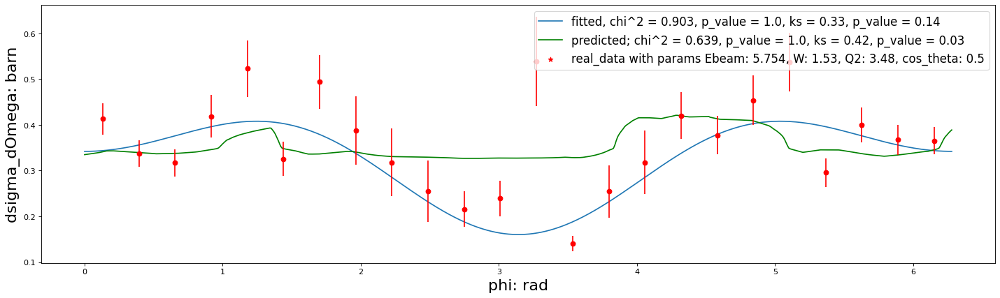

0 5.754 1.53 3.48 0.6
a = 0.29529981110079634 , b = -0.006991008546110451, c = 0.018718944260527046


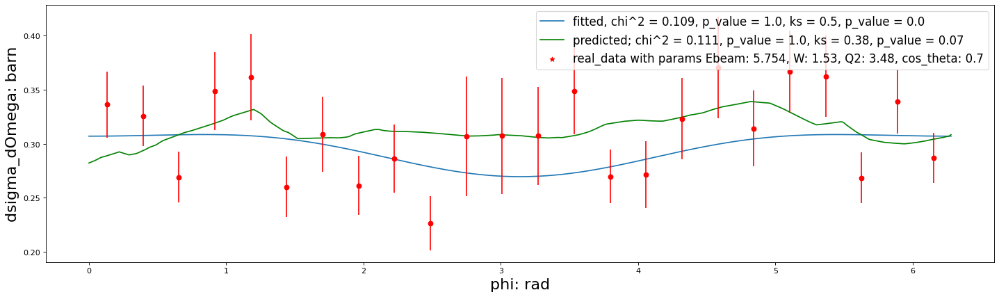

0 5.754 1.53 3.48 0.8
a = 0.2570505392909668 , b = -0.0005912828040788298, c = -0.010632769160946687


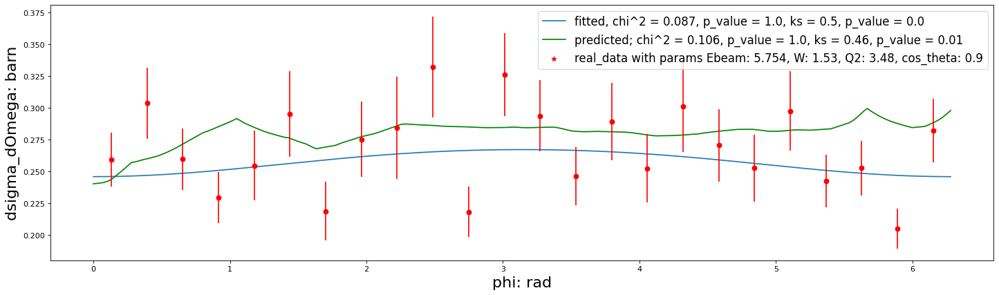


 50%|█████     | 2/4 [00:15<00:15,  7.62s/it]

a = 0.09978664352305329 , b = 0.011282890112811271, c = 0.012830901088658067


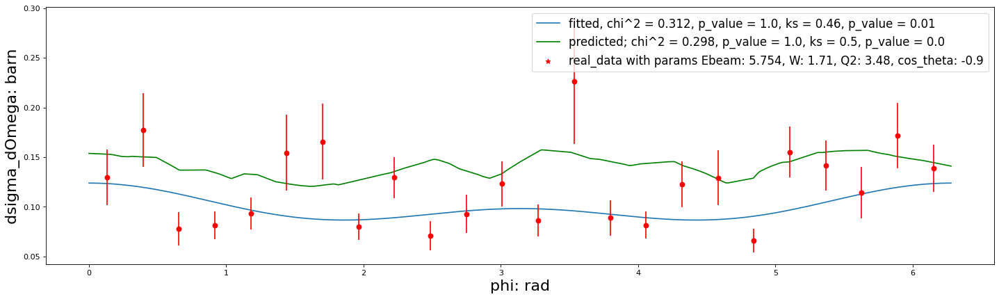

0 5.754 1.71 3.48 -0.8
a = 0.10553324193288365 , b = 0.0018315828588265676, c = 0.009391259132251344


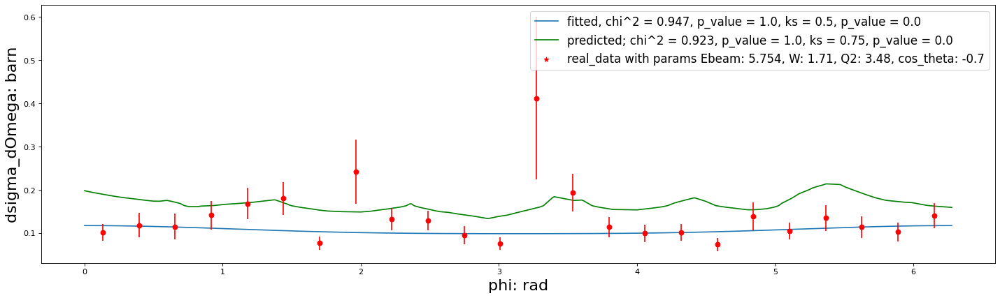

0 5.754 1.71 3.48 -0.6
a = 0.09754653192526651 , b = -0.0050124068116299755, c = 0.032644328685238116


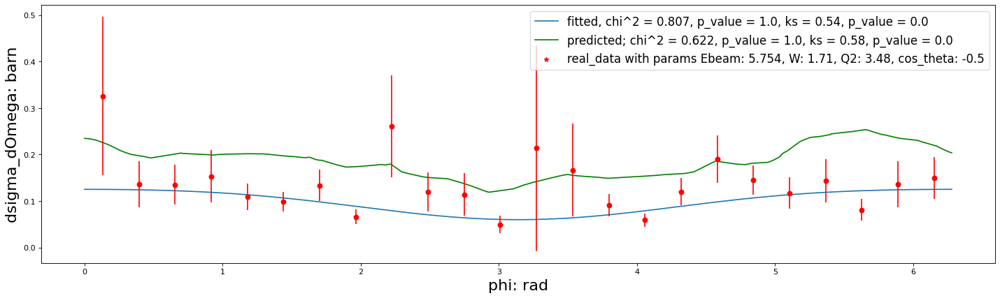

0 5.754 1.71 3.48 -0.4
a = 0.12142505235020239 , b = -0.015997688905480603, c = 0.025959990192010028


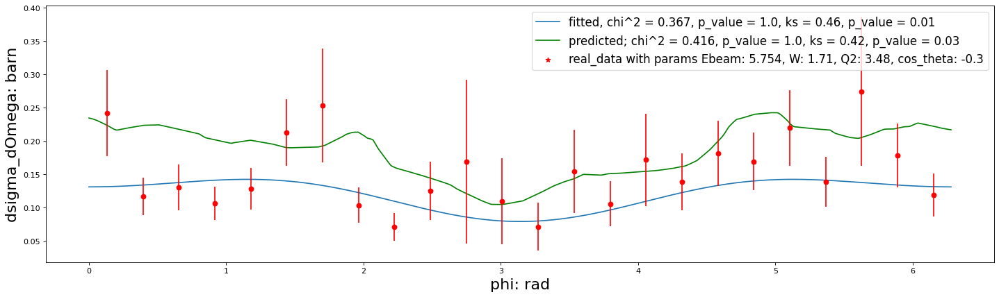

0 5.754 1.71 3.48 -0.2
a = 0.14193089837055406 , b = -0.0578772463024927, c = 0.05616822952099261


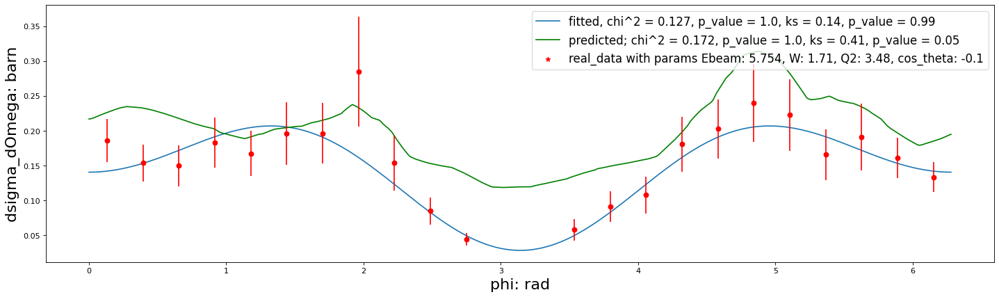

a = 0.13106999830983207 , b = -0.02135106374650818, c = 0.02128006676019588


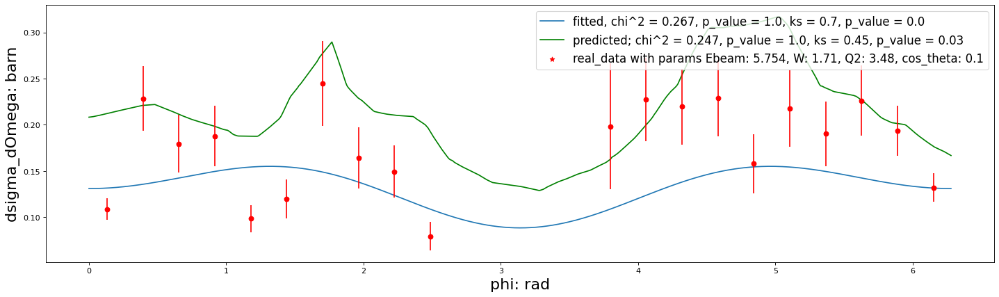

0 5.754 1.71 3.48 0.2
a = 0.17460635439583141 , b = -0.024161100040674396, c = -0.028173846875807932


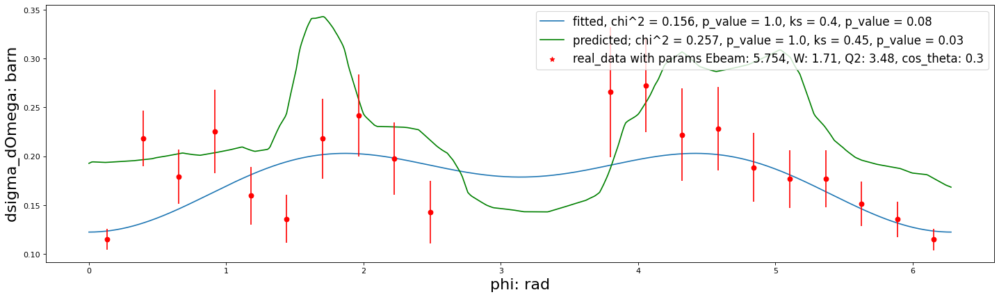

0 5.754 1.71 3.48 0.4
a = 0.15867964701956774 , b = -0.0082713340346763, c = -0.021769118075912947


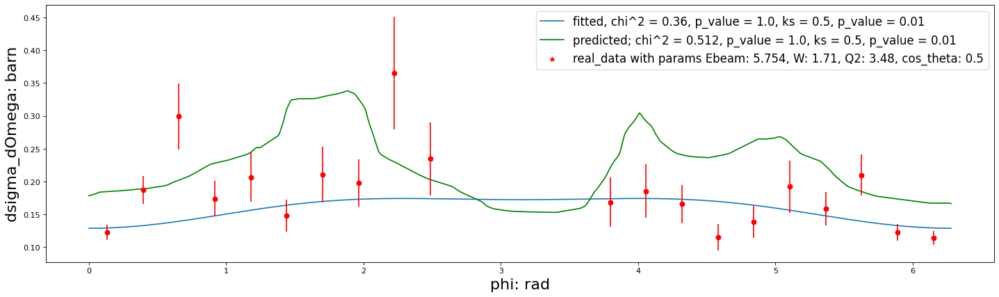

0 5.754 1.71 3.48 0.6
a = 0.11814859753295773 , b = -0.03822149597206147, c = 0.02565038345544005


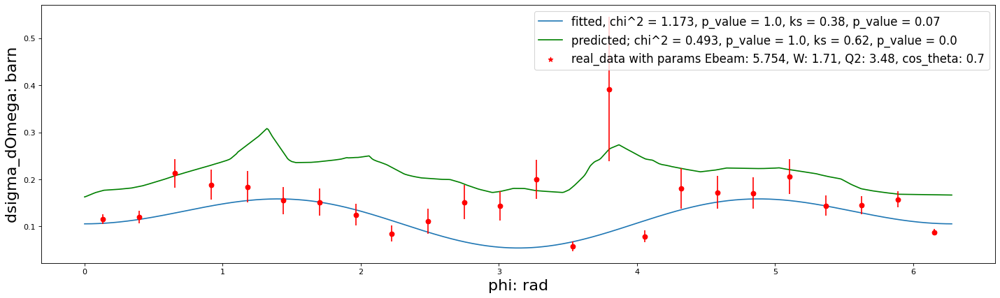

0 5.754 1.71 3.48 0.8
a = 0.16914209303185143 , b = -0.003660992553621394, c = -0.020926248263113588


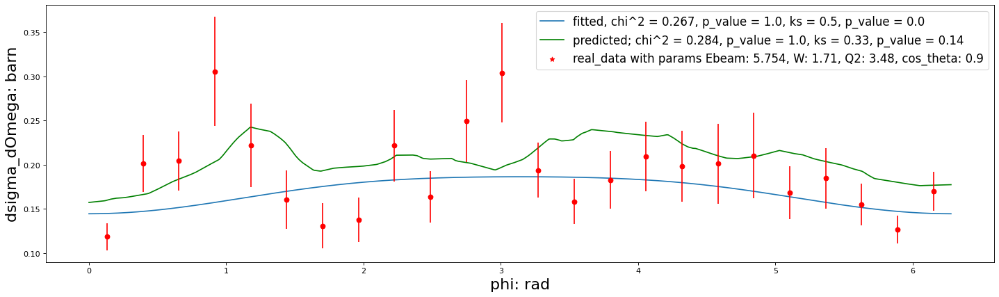


 91%|█████████ | 10/11 [02:27<00:18, 18.80s/it]

0 5.754 1.95 3.48 -0.9
0 5.754 1.95 3.48 -0.8
0 5.754 1.95 3.48 -0.7
0 5.754 1.95 3.48 -0.6
0 5.754 1.95 3.48 -0.5
0 5.754 1.95 3.48 -0.4
0 5.754 1.95 3.48 -0.3
0 5.754 1.95 3.48 -0.2
0 5.754 1.95 3.48 -0.1
0 5.754 1.95 3.48 0.1
0 5.754 1.95 3.48 0.2
0 5.754 1.95 3.48 0.3
0 5.754 1.95 3.48 0.4
0 5.754 1.95 3.48 0.5
0 5.754 1.95 3.48 0.6
0 5.754 1.95 3.48 0.7
0 5.754 1.95 3.48 0.8
0 5.754 1.95 3.48 0.9



  0%|          | 0/4 [00:00<?, ?it/s]

0 5.754 1.23 4.155 -0.9
0 5.754 1.23 4.155 -0.8
a = 0.05561457832347777 , b = -0.06461344186493463, c = 0.02592441529383207


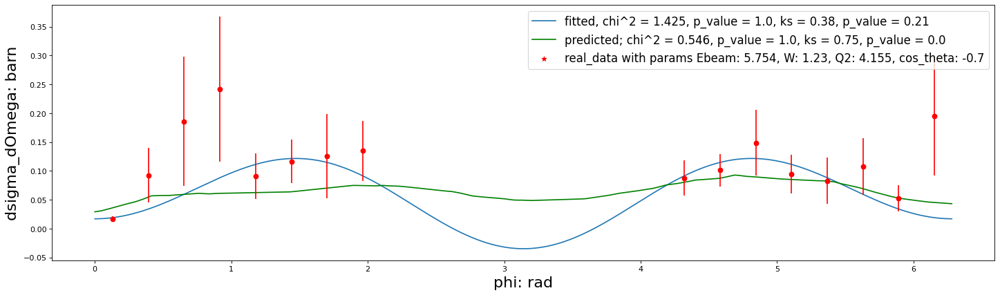

0 5.754 1.23 4.155 -0.6
a = 0.16064187632014104 , b = 0.006380924191445711, c = -0.06832330535138499


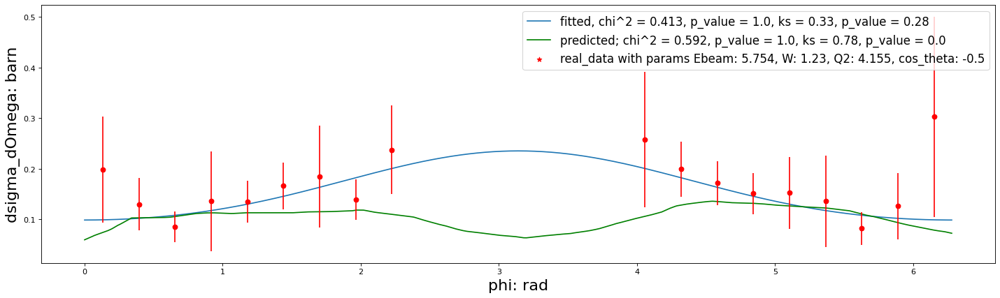

0 5.754 1.23 4.155 -0.4
a = 0.14921441643238448 , b = -0.01699713557764667, c = -0.0389657188698552


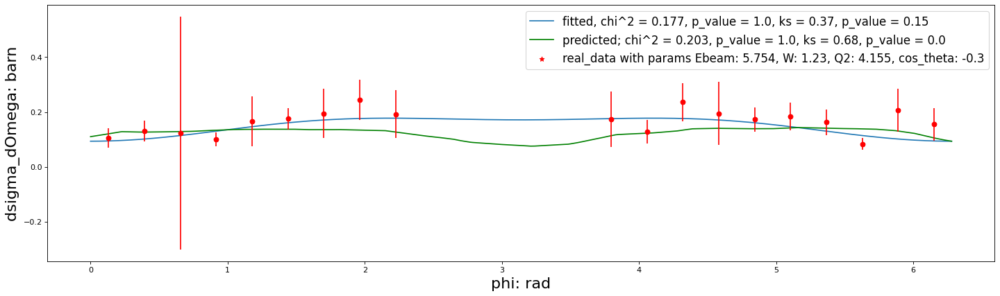

0 5.754 1.23 4.155 -0.2
a = 0.12272013714489483 , b = -0.060368887015048944, c = 0.018419273288979188


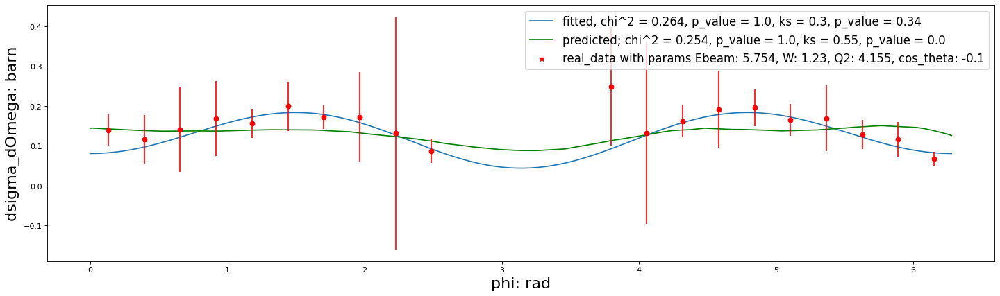

a = 0.12364025019188916 , b = -0.024937964090462297, c = 0.054774314874186346


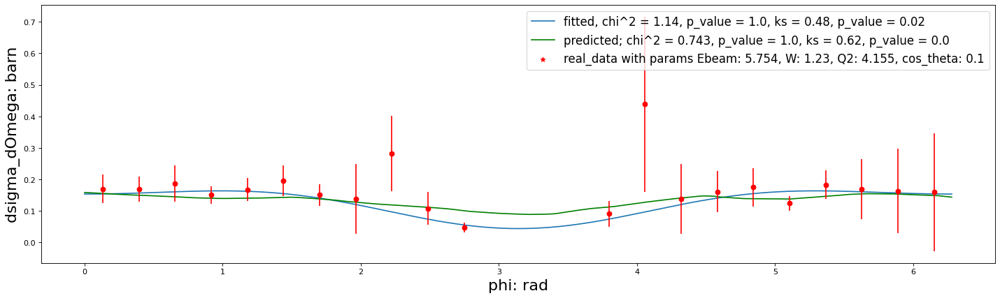

0 5.754 1.23 4.155 0.2
a = 0.17307886313905668 , b = -0.05337986206952555, c = 0.04445852890620032


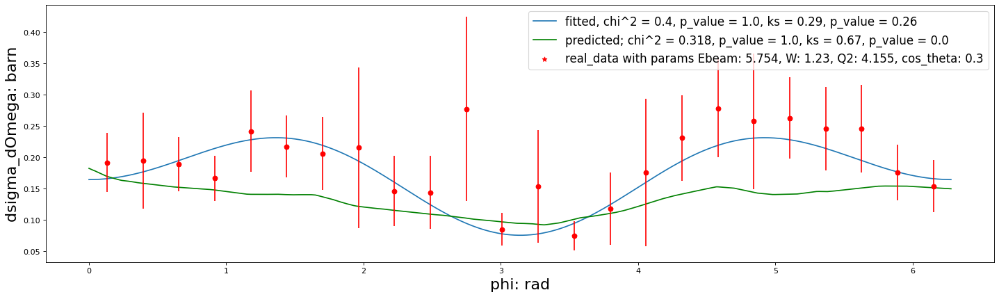

0 5.754 1.23 4.155 0.4
a = 0.14673123488675419 , b = -0.08177372589277764, c = 0.012253518931558438


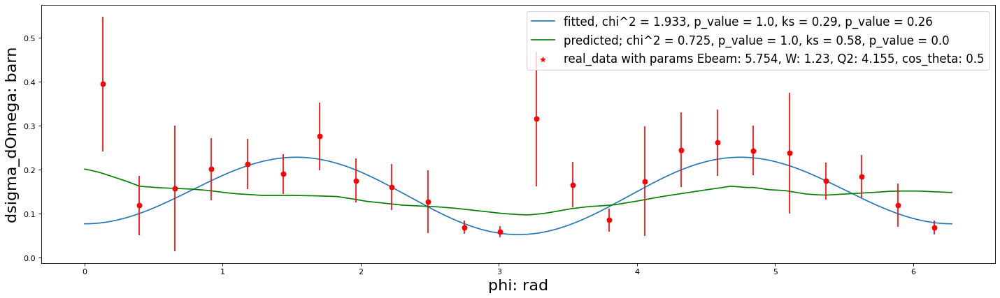

0 5.754 1.23 4.155 0.6
a = 0.1339611651683177 , b = -0.03986057893130357, c = 1.413666775673672e-05


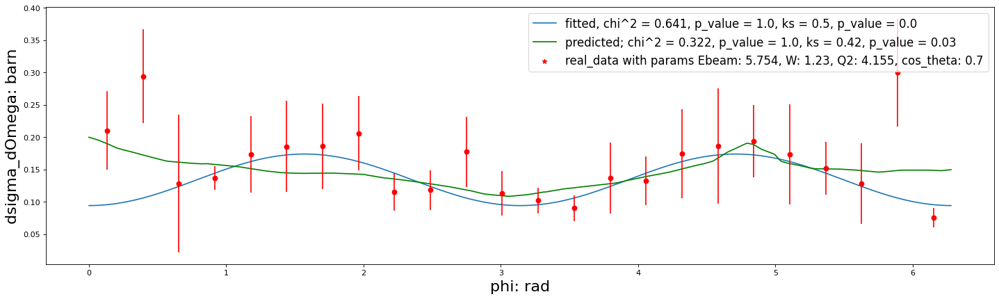

0 5.754 1.23 4.155 0.8
a = 0.15543186014850113 , b = -0.011427500708995529, c = 0.020557331466542334


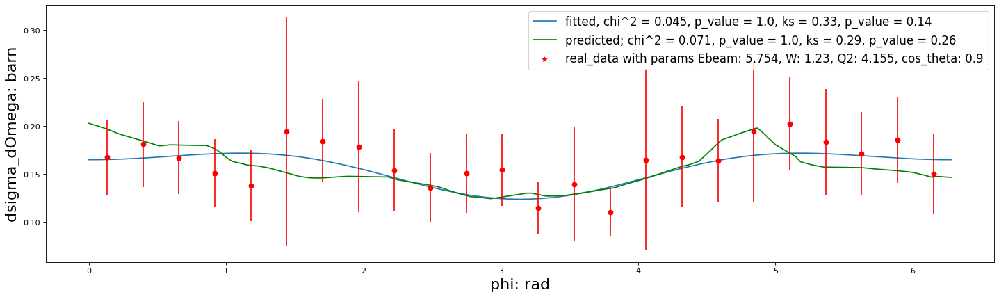


 25%|██▌       | 1/4 [00:06<00:19,  6.48s/it]

a = 0.08448840290529544 , b = -0.01812811527486444, c = 0.035549131477522644


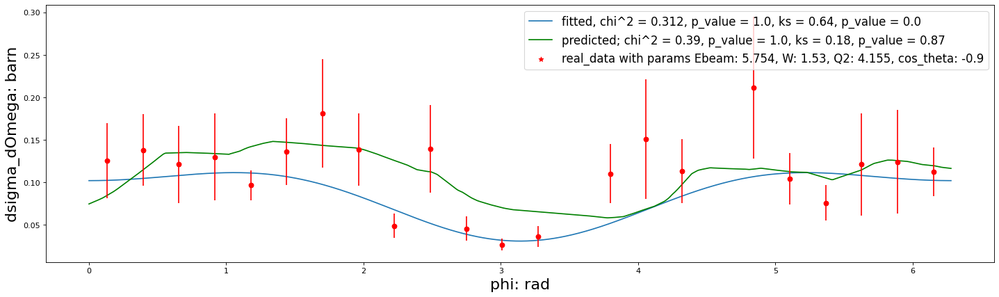

0 5.754 1.53 4.155 -0.8
a = 0.19393428494422765 , b = -0.0060473220618631075, c = 0.06243459804278045


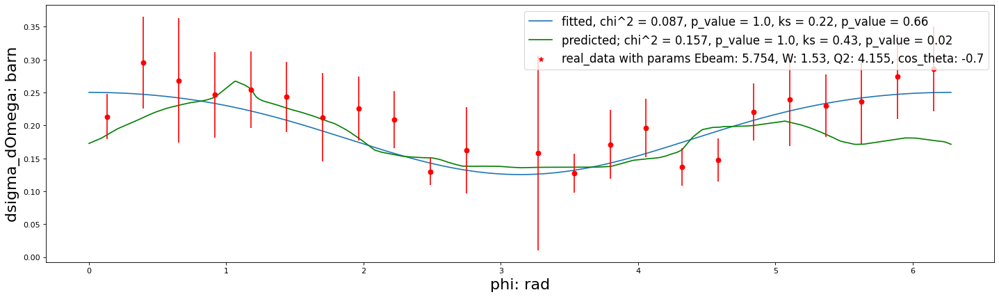

0 5.754 1.53 4.155 -0.6
a = 0.27530193514924045 , b = -0.10594676331765636, c = 0.10269435029369507


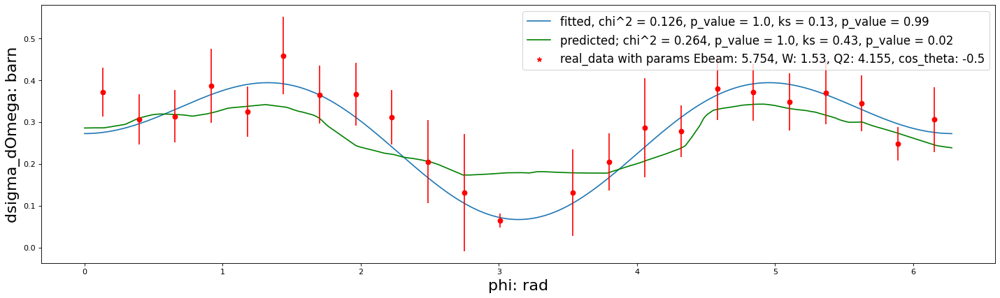

0 5.754 1.53 4.155 -0.4
a = 0.287728443347849 , b = -0.01224880488132589, c = 0.06465040146054848


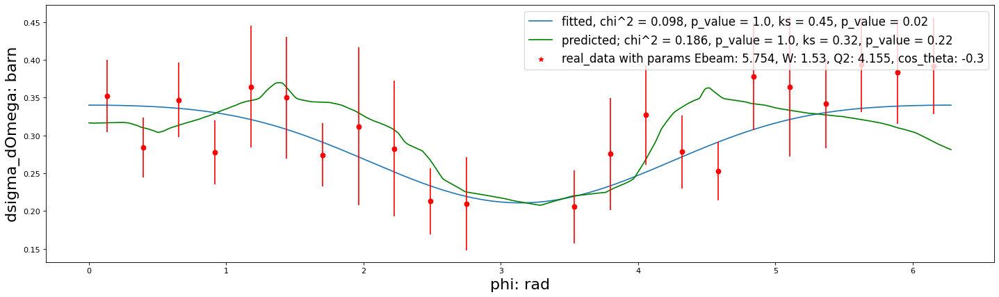

0 5.754 1.53 4.155 -0.2
a = 0.2793602780600273 , b = -0.03040451607254447, c = 0.07406295074899863


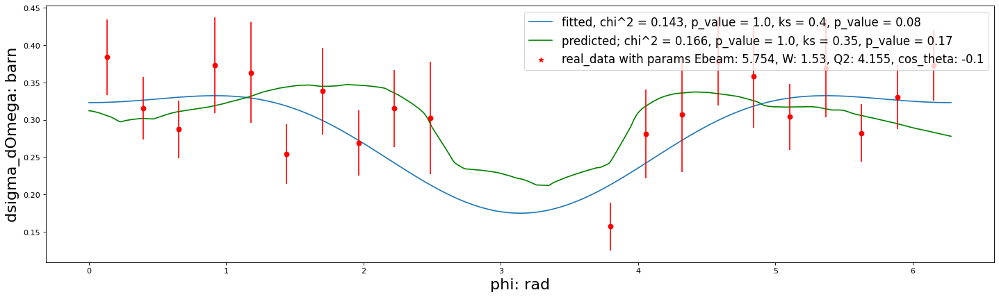

a = 0.27181954470354214 , b = 0.022108846955479485, c = -0.021420888758285246


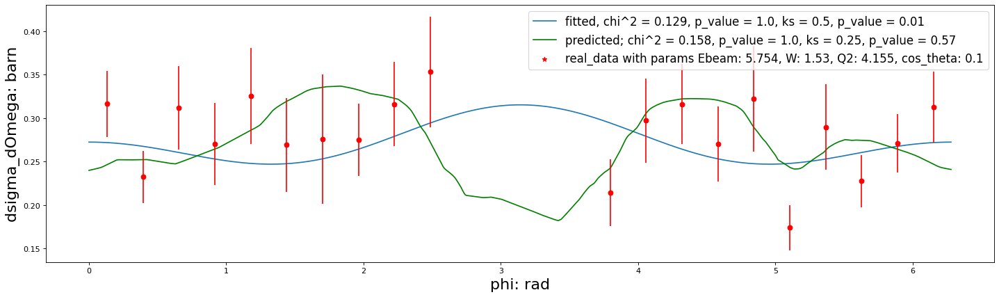

0 5.754 1.53 4.155 0.2
a = 0.2240376893508229 , b = 0.002407259635169856, c = 0.01260818185008239


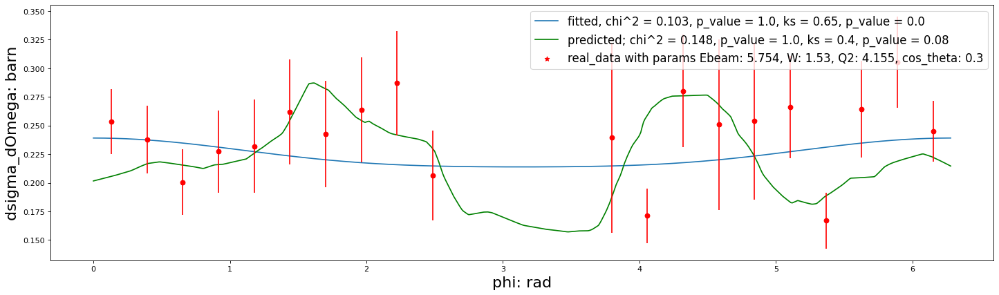

0 5.754 1.53 4.155 0.4
a = 0.13931970478049302 , b = -0.06310751512239422, c = 0.03250120320365801


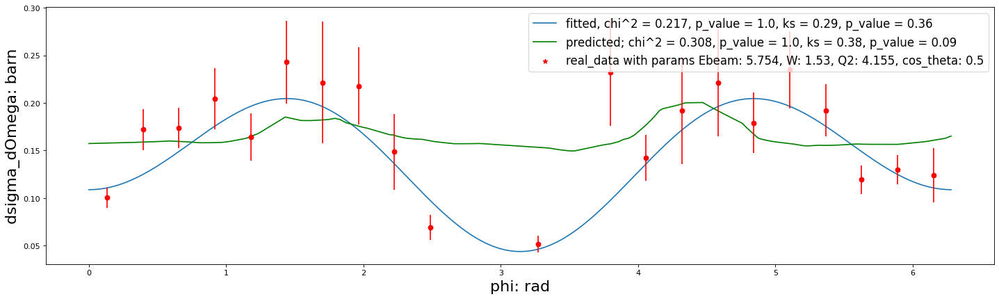

0 5.754 1.53 4.155 0.6
a = 0.11217260111070784 , b = 0.028752604526511943, c = 0.03964292782801153


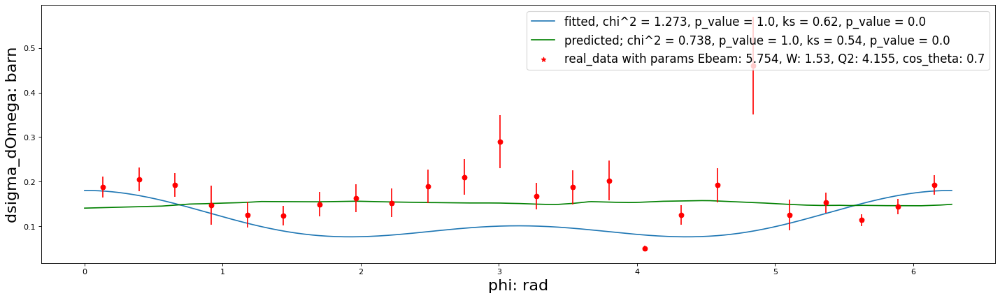

0 5.754 1.53 4.155 0.8
a = 0.11232917765468166 , b = -0.0017093509720696096, c = 0.0024632034206015178


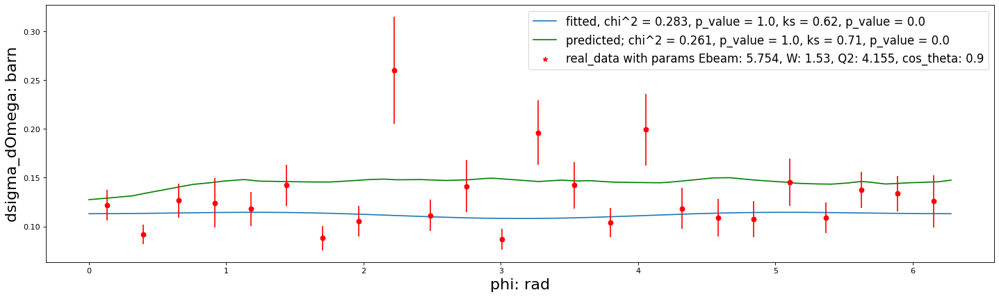


 50%|█████     | 2/4 [00:13<00:14,  7.01s/it]

a = 0.03782389279654236 , b = 0.016564861921733863, c = 0.0033745307656338234


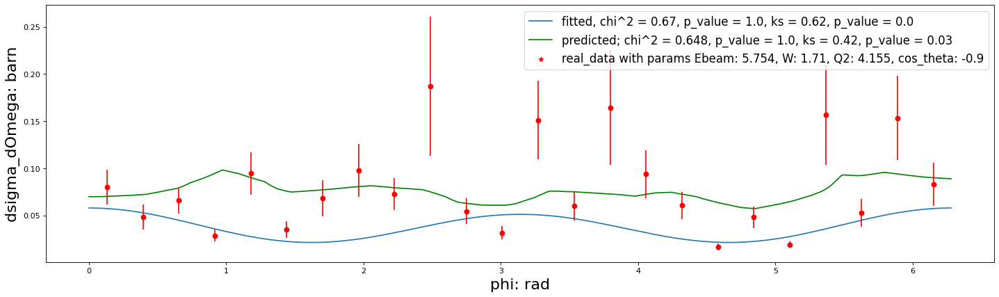

0 5.754 1.71 4.155 -0.8
a = 0.0641274949033122 , b = 0.000982718531863292, c = 0.00413990078926339
5.754 1.71 4.155 -0.7
0 5.754 1.71 4.155 -0.6
5.754 1.71 4.155 -0.5
0 5.754 1.71 4.155 -0.4
a = 0.06558038194529406 , b = -0.007493447617021858, c = 0.022531224320672543
5.754 1.71 4.155 -0.3
0 5.754 1.71 4.155 -0.2
a = 0.06403870950704027 , b = -0.0023945173580475145, c = 0.023322416266539706


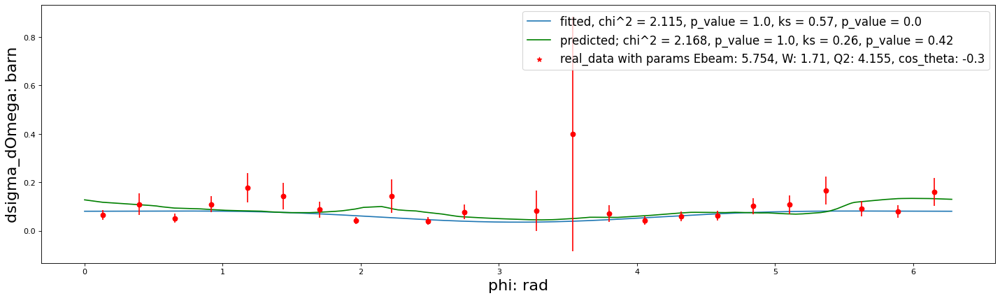

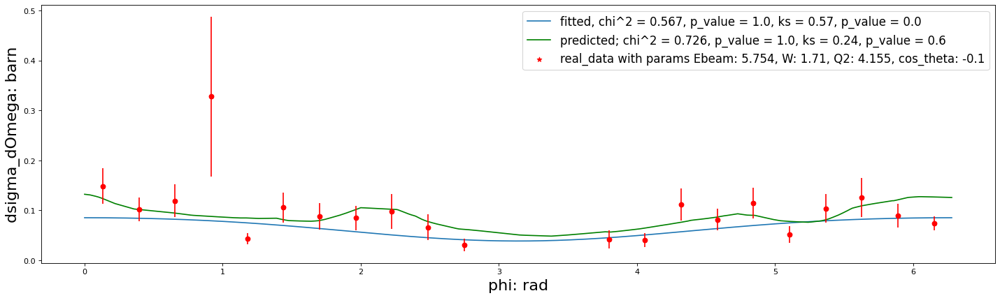

a = 0.07051436327974765 , b = -0.02168140032422292, c = 0.031120559644685505


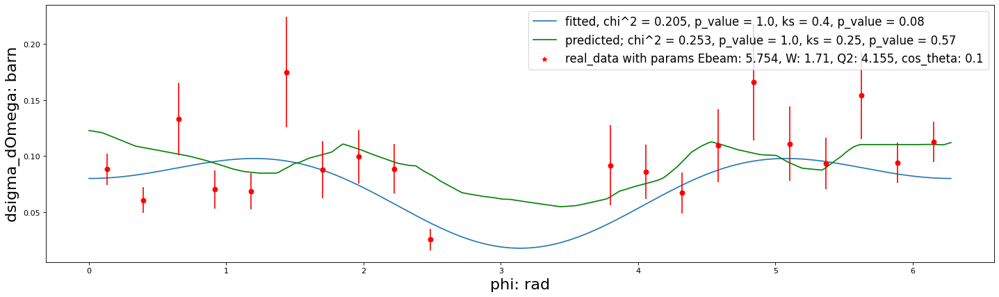

0 5.754 1.71 4.155 0.2
a = 0.08910303819044506 , b = 0.0074054282523282325, c = -0.019902032767279285


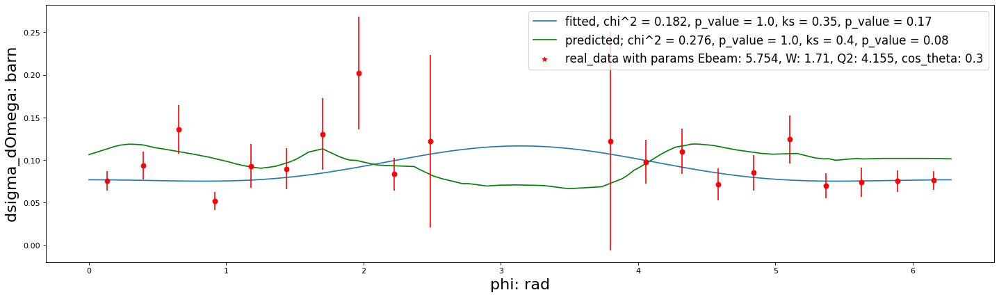

0 5.754 1.71 4.155 0.4
a = 0.07709268018864032 , b = -0.016038410015552326, c = -0.00655351607754723


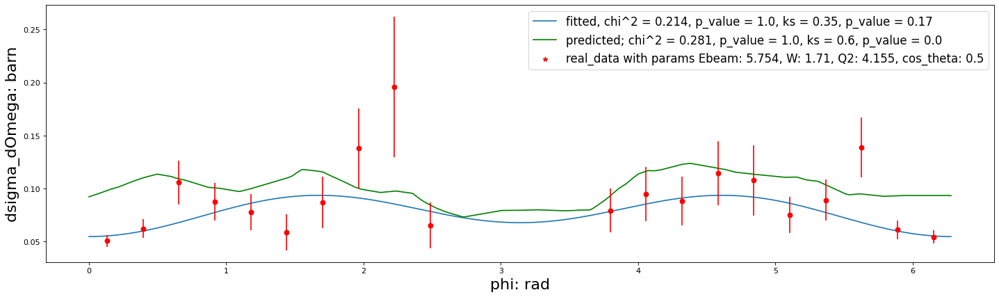

0 5.754 1.71 4.155 0.6
a = 0.07118002016814619 , b = -0.02520761886801966, c = 0.009071309947222293


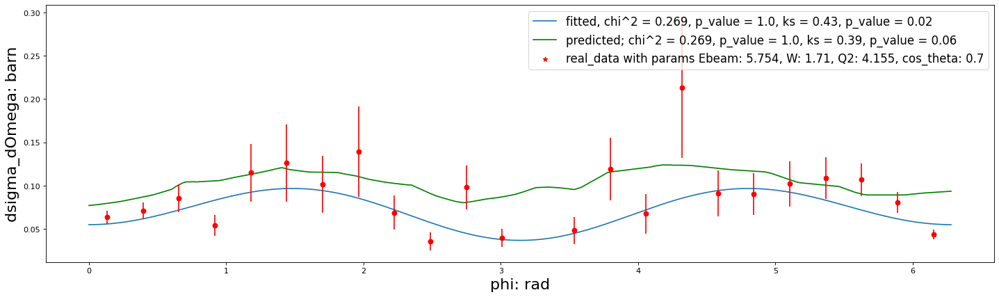

0 5.754 1.71 4.155 0.8
a = 0.08546097903481516 , b = -0.01326227927826434, c = -0.011420230356870942


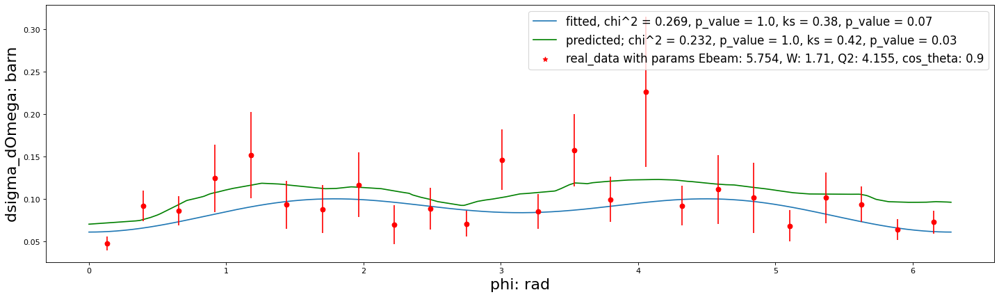


100%|██████████| 11/11 [02:47<00:00, 15.27s/it]

0 5.754 1.95 4.155 -0.9
0 5.754 1.95 4.155 -0.8
0 5.754 1.95 4.155 -0.7
0 5.754 1.95 4.155 -0.6
0 5.754 1.95 4.155 -0.5
0 5.754 1.95 4.155 -0.4
0 5.754 1.95 4.155 -0.3
0 5.754 1.95 4.155 -0.2
0 5.754 1.95 4.155 -0.1
0 5.754 1.95 4.155 0.1
0 5.754 1.95 4.155 0.2
0 5.754 1.95 4.155 0.3
0 5.754 1.95 4.155 0.4
0 5.754 1.95 4.155 0.5
0 5.754 1.95 4.155 0.6
0 5.754 1.95 4.155 0.7
0 5.754 1.95 4.155 0.8
0 5.754 1.95 4.155 0.9


In [15]:
E_beam = 1.515

for Q2 in tqdm.tqdm(np.sort(df[df.Ebeam == E_beam].Q2.unique())):
    os.makedirs(f"./check_screenshots_by_energy_new_loss/E_beam={E_beam}/Q2={Q2}")
    for W in tqdm.tqdm([1.23, 1.53, 1.71, 1.95]):
        os.makedirs(f"./check_screenshots_by_energy_new_loss/E_beam={E_beam}/Q2={Q2}/W={W}")
        for cos_theta in [-0.9,-0.8,-0.7,-0.6,-0.5,-0.4,-0.3,-0.2,-0.1,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]:
            try:
                cross_sections_check(df, E_beam, W, Q2, cos_theta)
            except:
                print(E_beam, W, Q2, cos_theta)

### Structure functions

In [42]:
# df_grid
Ebeam = 5.754
step_W = 0.005
step_Q2 = 0.1
step_cos_theta = 0.1
step_phi = 0.05


data_grid = []
for W in tqdm.tqdm(np.arange(1.1, 2.2 + step_W, step_W)):
    for Q2 in np.arange(1.6, 4.3 + step_Q2, step_Q2):
         for cos_theta in np.arange(-1, 1+step_cos_theta, step_cos_theta):
                for phi in np.arange(0, 2*np.pi, step_phi):
                    data_grid.append([Ebeam,
                                      W,
                                      Q2,
                                      cos_theta,
                                      phi])

df_grid = pd.DataFrame(data_grid)
df_grid.columns = ['Ebeam', 'W', 'Q2', 'cos_theta', 'phi']


df_grid.W = np.round(df_grid.W, 3)
df_grid.Q2 = np.round(df_grid.Q2, 3)
df_grid.cos_theta = np.round(df_grid.cos_theta, 3)
df_grid.phi = np.round(df_grid.phi, 3)

100%|██████████| 221/221 [00:16<00:00, 13.17it/s]
